In [993]:
ad.obs.value_counts('batch')

batch
nodule_large    12004
nodule_small     8229
root             6479
dtype: int64

In [1]:
from jpy_tools import singleCellTools

Global seed set to 0


<Figure size 72x72 with 0 Axes>

In [2]:
import rpy2
import rpy2.robjects as ro
from rpy2.robjects.packages import importr
import rpy2.ipython.html

rpy2.ipython.html.init_printing()
from jpy_tools.rTools import (
    py2r,
    r2py,
    r_inline_plot,
    rHelp,
    trl,
    rSet,
    rGet,
    ad2so,
    so2ad,
)
from jpy_tools import toPkl, loadPkl

rBase = importr("base")
rUtils = importr("utils")
R = ro.r
R("options(browser='firefox', shiny.port=6533)")
%load_ext rpy2.ipython

In [3]:
import pandas as pd
import scanpy as sc
import numpy as np
import scipy.sparse as ss
from cool import F
import muon as mu

In [4]:
import patchworklib as pw

In [5]:
%config InlineBackend.figure_format = 'retina'
import seaborn as sns
from matplotlib import pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.font_manager as font_manager
# plt.rcParams['figure.dpi'] = 150
font_dirs = ["/public/home/mowp/test/fonts/"]
font_files = font_manager.findSystemFonts(fontpaths=font_dirs)
for font_file in font_files:
    font_manager.fontManager.addfont(font_file)
plt.rcParams["font.family"] = "Arial"

In [6]:
dir_temp = '/public/home/liuzj/projects/singleCell/02_jupyter/soybean/0510_combine/'

In [7]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/analysis/noduleWithRoot/"

In [9]:
ad = sc.read_h5ad(f"{dir_result}/ad_brief_com_version_1.h5ad")

In [8]:
dt_renameSample = {
    "Root": "Root",
    "Large Nodule": "Mature Nodule",
    "Small Nodule": "Developing Nodule",
}

In [18]:
dt_renameSample = {
    "Root": "Root",
    "Mature Nodule": "Nodule (21 dpi)",
    "Developing Nodule": "Nodule (12 dpi)",
}

In [19]:
ad.obs['Sample_time'] = ad.obs['Sample_new'].map(dt_renameSample).cat.set_categories(['Nodule (21 dpi)', 'Nodule (12 dpi)', 'Root'])

# load data

In [9]:
ad = sc.read_h5ad(f"{dir_result}/afterClustering.h5ad")

In [403]:
ad.obs['Sample']

AAACCCAAGACGCAGT-1-batch-nodule_large    Large Nodule
AAACCCAAGAGGATCC-1-batch-nodule_large    Large Nodule
AAACCCACAAATACAG-1-batch-nodule_large    Large Nodule
AAACCCACAGCAGTAG-1-batch-nodule_large    Large Nodule
AAACCCACAGCTGTAT-1-batch-nodule_large    Large Nodule
                                             ...     
TTTGTTGGTGTTACAC-1-batch-root                    Root
TTTGTTGTCAGTCCGG-1-batch-root                    Root
TTTGTTGTCCTCTTTC-1-batch-root                    Root
TTTGTTGTCGGTTGTA-1-batch-root                    Root
TTTGTTGTCTCATTTG-1-batch-root                    Root
Name: Sample, Length: 26712, dtype: category
Categories (3, object): ['Large Nodule', 'Small Nodule', 'Root']

In [405]:
ad.obs = ad.obs.assign(SampleN=lambda df: df['Sample'].cat.rename_categories(dt_renameSample))

In [10]:
sc.pp.highly_variable_genes(ad, layer='raw', batch_key='batch', n_top_genes=5000, flavor='seurat_v3')

In [11]:
ad.X = ad.layers['raw'].copy()
ad.raw = ad
sc.pp.filter_genes(ad, min_cells=10)

## load symbol info

In [225]:
df_symbol = pd.read_table("/data/Zhaijx/liuzj/data/soybase_IPF/ncbi_locus/soybean_gene_symbol_name.txt").set_index('geneID')[['Symbol', 'other_designations']]

In [226]:
df_symbol = df_symbol.loc[~df_symbol.index.duplicated()]

In [227]:
dt_symbol = df_symbol.loc[~df_symbol['Symbol'].str.startswith('LOC')]['Symbol'].to_dict()

In [228]:
df_soybase = pd.read_table(
    "/data/Zhaijx/liuzj/data/soybase_IPF/soybase_genome_annotation_v2.0_09-27-2021.txt",
    skiprows=11,
)
dt_soybase = (
    df_soybase.assign(
        **{
            "Gmax 2.0 Primary Protein ID (1)": lambda df: df[
                "Gmax 2.0 Primary Protein ID (1)"
            ].str.replace("Glyma.", "GLYMA_")
        }
    )
    .set_index("Gmax 2.0 Primary Protein ID (1)")[
        "Top Arabidopsis (TAIR10) BLASTP Hit (4)"
    ]
    .to_dict()
)

## get arab desc

In [190]:
df_arabDesc = pd.read_table('/data/Zhaijx/liuzj/data/Araport11/original/arab_gene_desc.txt')

In [191]:
dt_arabDesc = df_arabDesc['Gene Model Name'].to_dict()

## load nodulation related gene

In [823]:
dt_oldLocusToNew = pd.read_table(
    "/data/Zhaijx/liuzj/data/soybase_IPF/Glyma_11_to_Glyma_20_Correspondence_Full.csv",
    skiprows=1,
).assign(
    **{
        "Glyma 1.1": lambda df: df["Glyma 1.1"]
        .str.replace("Glyma", "Glyma."),
        "Glyma2.0": lambda df: df["Glyma2.0"]
        .str.replace("g", "G"),
    }
).set_index(
    "Glyma 1.1"
)[
    "Glyma2.0"
].to_dict()

In [824]:
# other rules
dt_oldLocusToNew.update(
    {
        "Glyma.15G19630": "Glyma.15G178100",
        "Glyma.07G04510": "Glyma.07G040300",
        "Glyma.6g04220": "Glyma.06G039100",
        "Glyma.8g01770": "Glyma.08G014500",
        "Glyma.7G133000": "Glyma.07G133000",
        "Glyma.5G126200": "Glyma.05G126200",
    }
)

In [825]:
dt_oldLocusToNew.update({x.replace('g', 'G'):y for x,y in dt_oldLocusToNew.items()})

In [826]:
dt_oldLocusToNew.update({x.replace('Glyma.', 'Glyma'):y for x,y in dt_oldLocusToNew.items()})

In [827]:
df_nodulationRelatedGene = pd.read_excel('/data/Zhaijx/liuzj/data/nodulation_related_gene/TPC2019-RA-00279_Supplemental_Data_Set_1.xlsx', skiprows=1, header = [0, 1])

In [828]:
df_nodulationRelatedGene = df_nodulationRelatedGene[
    [
        ("Gene Symbol", "Unnamed: 0_level_1"),
        ("Phenotypic Defect", "Infection"),
        ("Phenotypic Defect", "Nodule Organogenesis "),
        ("Phenotypic Defect", "Fixation"),
        ("Reference", "Unnamed: 4_level_1"),
        ("Protein class/Molecular function", "Unnamed: 5_level_1"),
        ("Gene Name", "Unnamed: 6_level_1"),
        ("Alternate names", "Unnamed: 7_level_1"),
        ("Mutagen", "Unnamed: 8_level_1"),
        ("Medicago Gene ID", "Unnamed: 9_level_1"),
        ("Probeset", "Unnamed: 10_level_1"),
        ("Lotus Gene ID", "Unnamed: 11_level_1"),
        ("Soybean Gene ID", "Unnamed: 12_level_1"),
        ("Phaseolus Gene ID", "Unnamed: 13_level_1"),
        ("Myc Phenotype", "Unnamed: 14_level_1"),
    ]
]

In [829]:
def _rename(x):
    if x[1].startswith('Unnamed'):
        return x[0]
    else:
        return x[1] + 'Phenotype'
df_nodulationRelatedGene.columns = df_nodulationRelatedGene.columns.map(_rename)
df_nodulationRelatedGene

,Gene Symbol,InfectionPhenotype,Nodule Organogenesis Phenotype,FixationPhenotype,Reference,Protein class/Molecular function,Gene Name,Alternate names,Mutagen,Medicago Gene ID,Probeset,Lotus Gene ID,Soybean Gene ID,Phaseolus Gene ID,Myc Phenotype
0,GmACP,NaN,Nod+/-,NaN,"Wang et al., 2014",Carrier protein,ACYL CARRIER PROTEIN (ACP),NaN,RNAi,Medtr7g080390,Mtr.48571.1.S1_at,Lj1g3v2840250,Glyma.18G244300,Phvul.008G052400,NaN
1,"PvAGO5, GmAGO5",Inf-,"Nod+/-, White++",NaN,"Reyero-Saavedra et al., 2017",Multidomain protein (RNA silencing),ARGONAUTE 5 (AGO5),NaN,RNAi,"Medtr4g056430, Medtr4g056470",Mtr.45521.1.S1_at,Lj0g3v0169039.1,Glyma.12G083500,Phvul.011G088200,NaN
2,LjAMSH,"Inf+/-, Inf*",Nod+/-,Fix*,"Malolepszy et al., 2015",Enzyme (Metalloprotease; Deubiquitinating),ASSOCIATED MOLECULE WITH THE SH3 DOMAIN OF STA...,NaN,LORE1,Medtr6g083940,Mtr.21924.1.S1_at; Mtr.21925.1.S1_s_at,Lj2g3v0721190,Glyma.07G093100,Phvul.003G094300,Myc+
3,LjAMT1.1,NaN,Nod++,Fix+/-,"Rogato et al., 2008",Transporter (Ammonium),AMMONIUM TRANSPORTER 1.1 (AMT1.1),NaN,Antisense,Medtr1g045550,Mtr.10556.1.S1_at,"Lj5g3v1314550, Lj0g3v0302059",Glyma.10G132300,Phvul.007G231700,NaN
4,PvANN1,Inf+/-,Nod+/-,Fix+/-,"Carrasco-castilla et al., 2018",Membrane binding protein,ANNEXIN1 (ANN1),NaN,RNAi,Medtr8g038210,Mtr.14183.1.S1_at,Lj0g3v0203419,Glyma.13G199800,Phvul.011G209300,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202,MtZPT2,NaN,Nod*,Fix-,"Frugier et al., 2000",TF (Zinc-finger motif containing),Krüppel-like Cys-2/His-2 ZINC FINGER PROTEIN (...,NaN,Antisense,Medtr3g102980,Mtr.37495.1.S1_at,-,Glyma.06G045400,Phvul.009G070800,NaN
203,MtZR1,NaN,Nod*,Fix+/-,"Hopkins et al., 2013",Unknown protein,ZINC RIBBON protein 1 (ZR1),NaN,RNAi,Medtr3g086740,Msa.965.1.S1_at,-,Glyma18g01770,"Phvul.001G254500, Phvul.011G068500",NaN
204,MtγECS,NaN,Nod+,Fix+/-,"El Msehli et al., 2011",Enzyme (Synthetase),γ‐GLUTAMYLCYSTEINE SYNTHETASE (γECS),NaN,RNAi,Medtr8g098350,Mtr.26622.1.S1_at,Lj4g3v2951270,Glyma.05G207600,Phvul.002G289200,NaN
205,Gs52,NaN,"Nod+/-, Nod*",Fix*,"Govindarajulu M, 2009",Enzyme (Ecto-apyrase),Glycine sojae 52 (GS52),NaN,RNAi,Medtr7g085200,-,Lj1g3v3948070,Glyma.16G043300,-,NaN


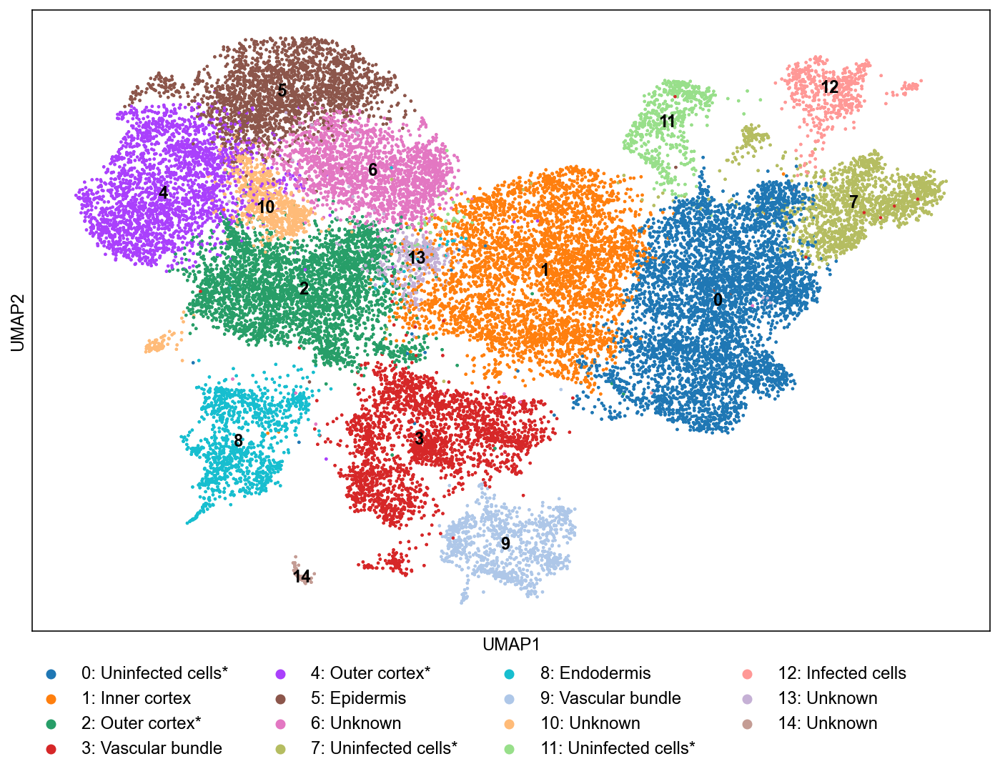

In [830]:
fig, ax = plt.subplots(figsize=(12, 8))
sc.pl.umap(
    ad, color="Cluster", title="", legend_loc="on data", show=False, ax=ax, size=20
)
sc.pl.umap(ad, color="Cell type", title="", show=False, ax=ax, size=20)
plt.legend(ncol=4, loc="upper left", bbox_to_anchor=(-0.015, -0.03), frameon=False)
plt.savefig(
    "/public/home/liuzj/share/scSoybean/allUmap_bc/leiden.png",
    bbox_inches="tight",
)

In [831]:
df_nodulationRelatedGene['Soybean Gene Parsed ID'] = df_nodulationRelatedGene['Soybean Gene ID'].str.findall(r"Glyma.[\w]+\b")
df_nodulationRelatedGene = df_nodulationRelatedGene.explode('Soybean Gene Parsed ID')
df_nodulationRelatedGene['Soybean Gene Parsed ID'] = df_nodulationRelatedGene['Soybean Gene Parsed ID'].map(lambda x:dt_oldLocusToNew.get(x,x))

In [832]:
df_nodulationRelatedGene['Soybean Gene Parsed ID'] = df_nodulationRelatedGene['Soybean Gene Parsed ID'].str.replace('Glyma.', 'GLYMA_')

In [833]:
ls_otherSpecies = """LjNFR5
LjSYMRK
LjNIN 
LjHAR1
MtVAMP721d/MtVAMP721e""".split('\n')

In [834]:
df_nodulationRelatedGeneGmOnly = df_nodulationRelatedGene.pipe(lambda df:df.loc[df['Gene Symbol'].str.contains('Gm') | df.eval("`Gene Symbol` in @ls_otherSpecies")])
# df_nodulationRelatedGeneGmOnly = df_nodulationRelatedGene

# STAT

In [1977]:
for name, _ad in singleCellTools.basic.splitAdata(ad, 'Sample', needName=True, copy=False):
    print(name, (_ad.layers['raw'].sum(0) > 0).sum())
    print(name, _ad.obs['n_counts'].median(), _ad.obs['n_counts'].mean())
    print(name, _ad.obs['n_genes'].median(), _ad.obs['n_genes'].mean())

 33%|███▎      | 1/3 [00:00<00:00,  2.84it/s]

Large Nodule 38714
Large Nodule 1426.0 1597.705810546875
Large Nodule 1141.0 1239.6487837387538


 67%|██████▋   | 2/3 [00:00<00:00,  2.95it/s]

Small Nodule 39100
Small Nodule 1857.0 2081.5546875
Small Nodule 1394.0 1487.4463482804715


100%|██████████| 3/3 [00:01<00:00,  2.92it/s]

Root 37528
Root 1875.0 2137.62060546875
Root 1229.0 1351.5841950918352


In [1976]:
_ad

View of AnnData object with n_obs × n_vars = 6479 × 39337
    obs: 'batch', 'n_genes', 'n_counts', 'percent_ct', 'leiden_0.0', 'leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 'leiden_0.6', 'leiden_0.7', 'leiden_0.8', 'leiden_0.9', 'leiden_1.0', 'leiden_1.1', 'leiden_1.2', 'leiden_1.3', 'leiden_1.4', 'leiden_1.5', 'leiden_1.6', 'leiden_1.7', 'leiden_1.8', 'leiden_1.9', 'leiden_2.0', 'leiden', 'UMI counts', 'Gene counts', 'Sample', 'leiden_R', 'Cluster', 'Cell type', '__group', 'Sample_two', 'Partition', 'UMI counts log10', 'Sample_new', 'wgcna_cluster', 'cluster_mergeUC'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std', 'SNF', 'means_ForPickMock'
    uns: 'Cell type_cellexES', 'Cell type_cellexES_batch', 'Cell type_colors', 'Cluster_colors', 'Sample_colors', 'batch_colors', 'hvg', 'jaRelated_marker', 'leiden', 'leiden_colors', 'neighbors', 'sn_wgcna_module', 'umap', 'ran

# clustering

## load data

In [5]:
import glob

In [6]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/step1_cellRanger/"

In [7]:
ls_sample = ['nodule_large', 'nodule_small', 'root']

In [8]:
ls_cellrangerH5 = [f"{dir_result}/{x}/{x}/outs/filtered_feature_bc_matrix.h5" for x in ls_sample]

In [5]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/analysis/noduleWithRoot/"

In [9]:
ls_ad = [sc.read_10x_h5(x) for x in ls_cellrangerH5]

In [10]:
ad = sc.concat(ls_ad, label='batch', keys=ls_sample, index_unique='-batch-')

In [11]:
sc.pp.filter_genes(ad, min_cells=10)

In [12]:
ad.obs.value_counts("batch")

batch
nodule_large    14819
nodule_small     9686
root             7636
dtype: int64

In [13]:
import importlib

In [14]:
jpy_tools.singleCellTools.detectDoublet.byScDblFinder(ad, batch_key='batch')

2021-09-26 10:50:51.612 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:167 - start to transfer adata to R


transfer `<class 'anndata._core.anndata.AnnData'>` to R:  End  


2021-09-26 10:53:26.225 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:171 - start to calculate doublet score
2021-09-26 10:55:32.050 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:175 - start to intergrate result with adata


transfer `DFrame` to python:  End  


2021-09-26 10:55:33.833 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:188 - before filter: 32141
2021-09-26 10:55:34.100 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:192 - after filter: 27602


In [15]:
ad.obs.value_counts("batch")

batch
nodule_large    12340
nodule_small     8499
root             6763
dtype: int64

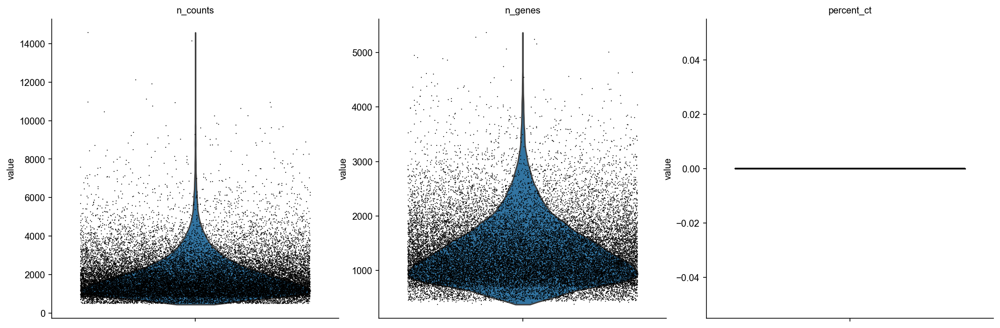

In [16]:
jpy_tools.singleCellTools.plotting.plotCellScatter(ad)

In [17]:
ad = ad[ad.obs.eval("400 < n_genes < 4000 & 600 < n_counts < 6000")]

In [18]:
ad.obs.value_counts("batch")

batch
nodule_large    12004
nodule_small     8229
root             6479
dtype: int64

In [19]:
ad.layers['raw'] = ad.X.copy()

In [20]:
import scvi
from jpy_tools.otherTools import loadPkl, toPkl

In [32]:
sc.pp.highly_variable_genes(ad, layer='raw', batch_key='batch', n_top_genes=5000, flavor='seurat_v3')

In [33]:
ad.layers['normalize_log'] = ad.layers['raw'].copy()
sc.pp.normalize_total(ad, 1e4, layer='normalize_log')
sc.pp.log1p(ad, layer='normalize_log')

In [35]:
ad_forScvi = jpy_tools.singleCellTools.basic.getPartialLayersAdata(ad, 'raw', ['batch'], ['highly_variable'])
ad_forScvi = ad_forScvi[:, ad_forScvi.var['highly_variable']].copy()

In [37]:
toPkl(ad_forScvi, 'ad_forScvi_soybean', 'scem')

0


In [ ]:
# run on scem
# scvi.data.setup_anndata(
#     ad_forScvi,
# )

# scvi.settings.seed = 39
# scvi.settings.num_threads = 56

# model_withBatchEffect = scvi.model.SCVI(ad_forScvi)
# model_withBatchEffect.train()
# ad_forScvi.obsm['X_scvi_withBatchEffect'] = model_withBatchEffect.get_latent_representation(ad_forScvi).copy()


# scvi.data.setup_anndata(
#     ad_forScvi,
#     batch_key='batch'
# )

# scvi.settings.seed = 39
# scvi.settings.num_threads = 56

# model = scvi.model.SCVI(ad_forScvi)
# model.train()
# ad_forScvi.obsm['X_scvi'] = model.get_latent_representation(ad_forScvi).copy()

In [21]:
ad_forScvi = loadPkl('ad_forScvi_soybean').copy()

In [22]:
ad.obsm['X_scvi_withBatchEffect'] = ad_forScvi.obsm['X_scvi_withBatchEffect']
ad.obsm['X_scvi'] = ad_forScvi.obsm['X_scvi']

In [1970]:
(ad.layers['raw'].sum(0) > 0).sum()

39337

In [1965]:
ad.to_df('raw').sum()

AnnData object with n_obs × n_vars = 26712 × 39337
    obs: 'batch', 'n_genes', 'n_counts', 'percent_ct', 'leiden_0.0', 'leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 'leiden_0.6', 'leiden_0.7', 'leiden_0.8', 'leiden_0.9', 'leiden_1.0', 'leiden_1.1', 'leiden_1.2', 'leiden_1.3', 'leiden_1.4', 'leiden_1.5', 'leiden_1.6', 'leiden_1.7', 'leiden_1.8', 'leiden_1.9', 'leiden_2.0', 'leiden', 'UMI counts', 'Gene counts', 'Sample', 'leiden_R', 'Cluster', 'Cell type', '__group', 'Sample_two', 'Partition', 'UMI counts log10', 'Sample_new', 'wgcna_cluster', 'cluster_mergeUC'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std', 'SNF', 'means_ForPickMock'
    uns: 'Cell type_cellexES', 'Cell type_cellexES_batch', 'Cell type_colors', 'Cluster_colors', 'Sample_colors', 'batch_colors', 'hvg', 'jaRelated_marker', 'leiden', 'leiden_R_colors', 'leiden_colors', 'neighbors', 'sn_wgcna_module', 

In [27]:
ad.obs['UMI counts'] = ad.to_df('raw').sum(1)
ad.obs['Gene counts'] = (ad.to_df('raw') > 0).astype(int).sum(1)

In [28]:
_dt = {'nodule_large':'Large Nodule', 'nodule_small':'Small Nodule', 'root':'Root'}
ad.obs['Sample'] = ad.obs['batch'].map(_dt)

In [29]:
sc.pp.neighbors(ad, use_rep='X_scvi')

In [1]:
sc.tl.leiden(ad, resolution=0.3)
ad.obs['Cluster'] = ad.obs['leiden'].map(_dt)

In [31]:
ad.obs['Cluster'] = ad.obs['Cluster'].astype(str)

... storing 'Cluster' as categorical


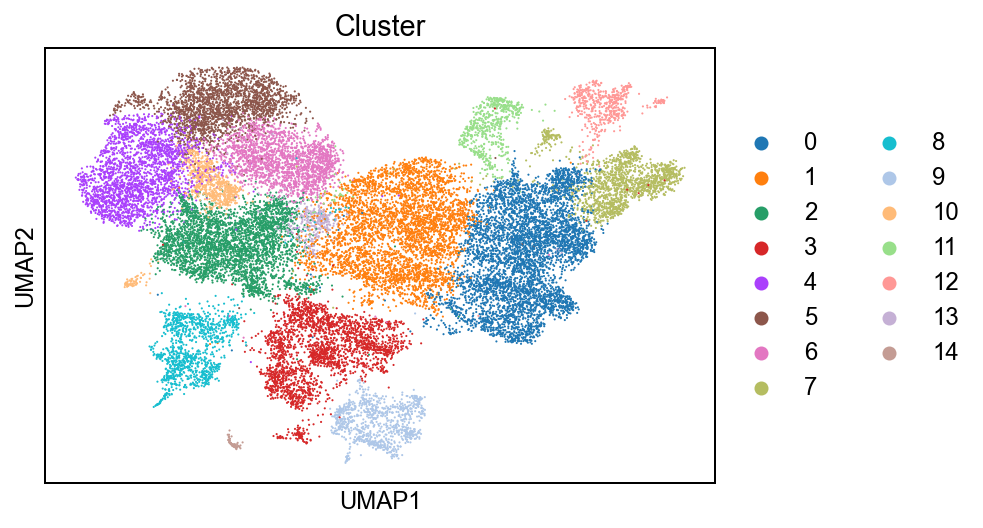

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

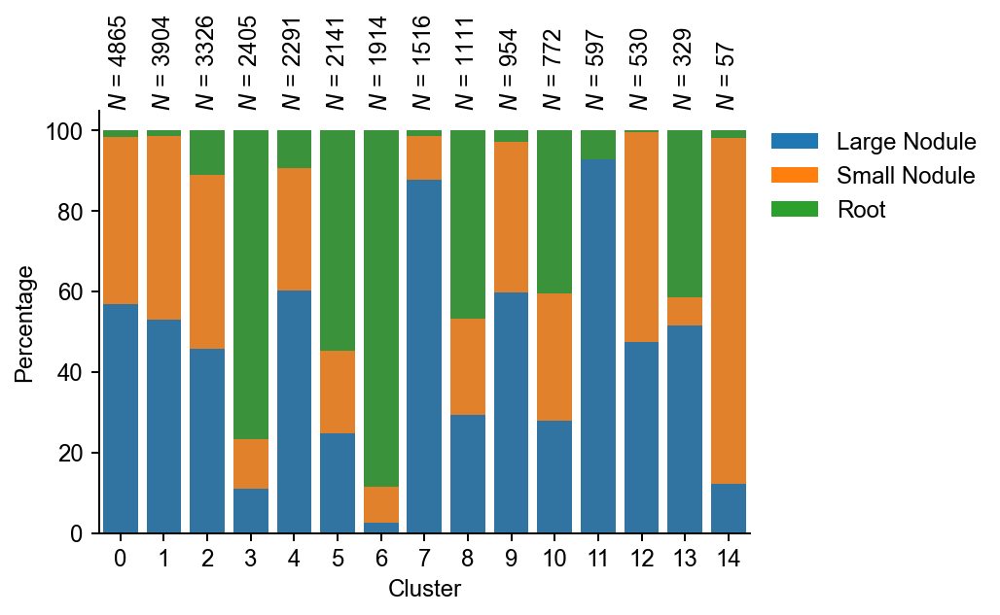

In [32]:
sc.pl.umap(ad, color = 'Cluster')
singleCellTools.plotting.plotLabelPercentageInCluster(ad, "Cluster", "Sample")

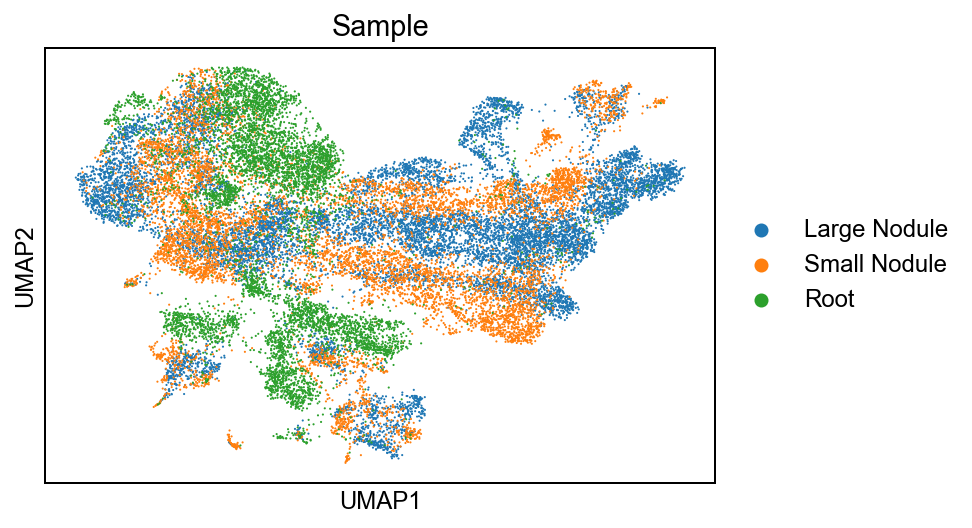

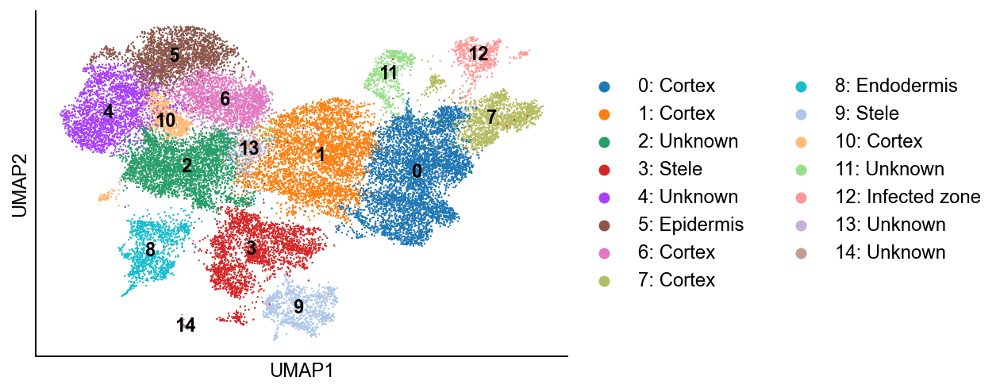

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

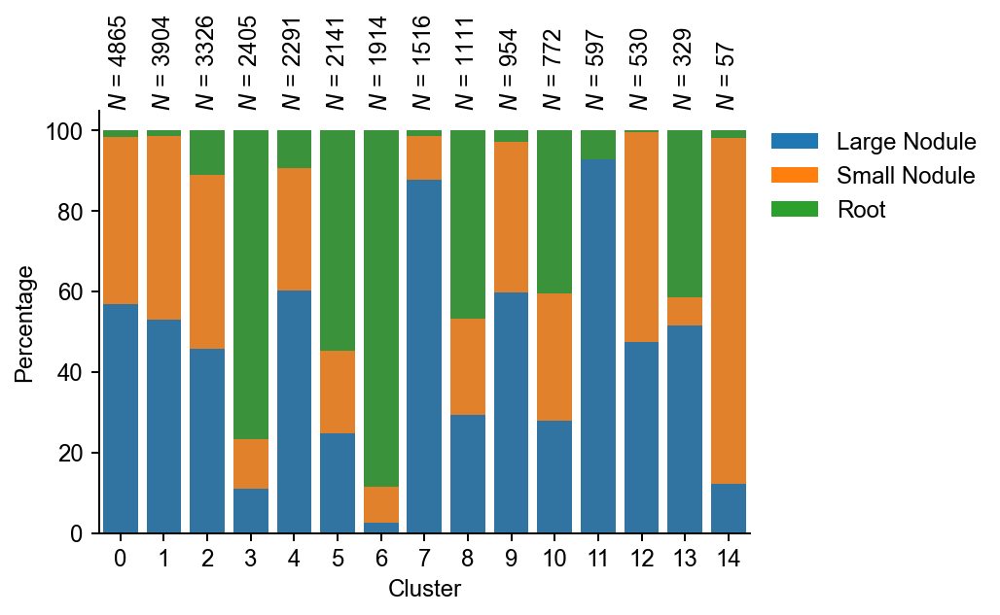

In [34]:
sc.pl.umap(ad, color="Sample")
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
sns.despine(top=True, right=True)
plt.show()

singleCellTools.plotting.plotLabelPercentageInCluster(ad, "Cluster", "Sample")

In [399]:
ad.uns['Sample_time_colors'] = ['#ff7f0e', '#1f77b4', '#2ca02c']

In [400]:
ad.obs['Sample_time'] = ad.obs['Sample_time'].cat.set_categories([ 'Nodule (12 dpi)','Nodule (21 dpi)', 'Root'])

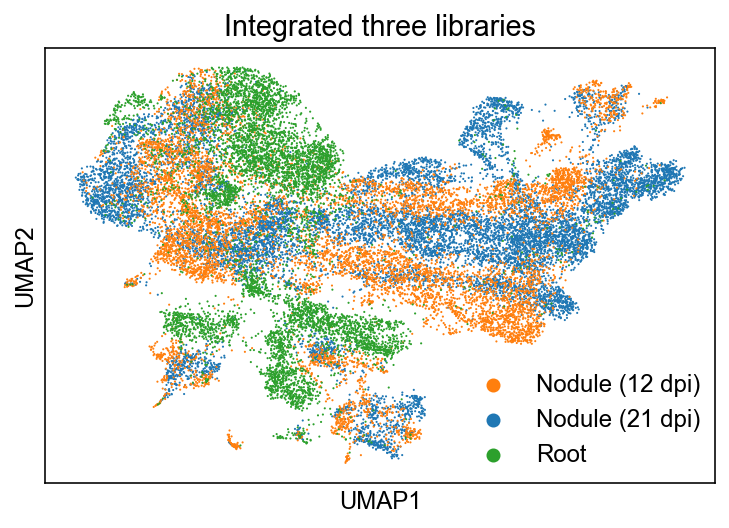

In [797]:
ax = sc.pl.umap(ad, color="Sample_time", title='Integrated three libraries', show=False)
plt.legend(loc='upper left', bbox_to_anchor=(0.6, 0.3), frameon=False, ncol=1)

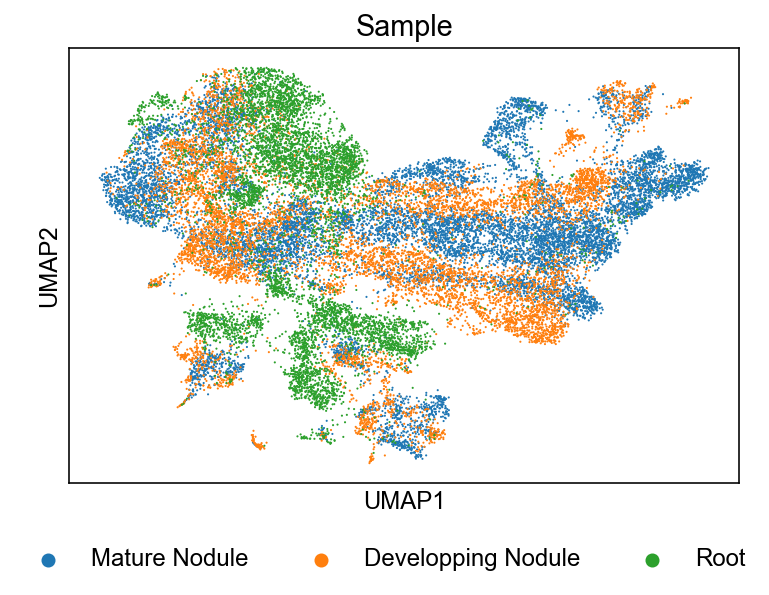

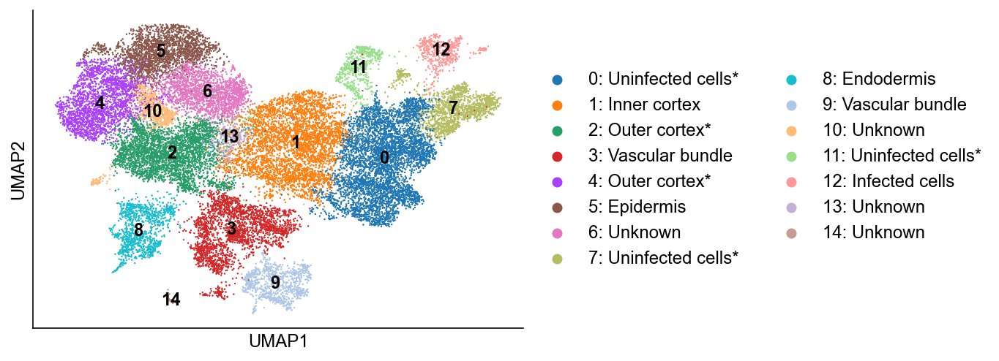

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

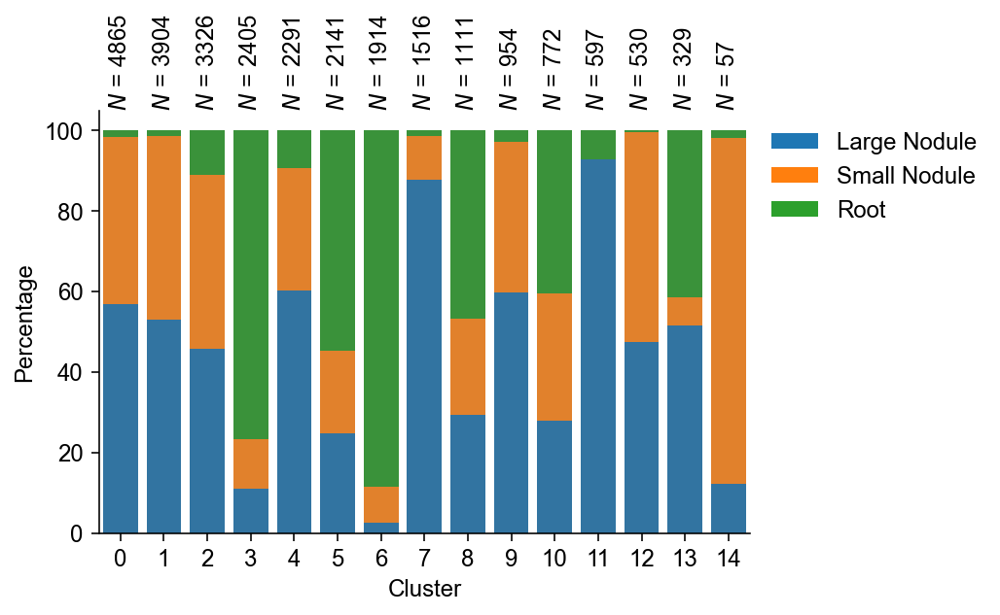

In [320]:
ax = sc.pl.umap(ad, color="Sample_new", title='Sample', show=False)
plt.legend(loc='upper left', bbox_to_anchor=(-0.1, -0.1), frameon=False, ncol=3)

ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
sns.despine(top=True, right=True)
plt.show()

singleCellTools.plotting.plotLabelPercentageInCluster(ad, "Cluster", "Sample")

# annotation

## by gene

In [150]:
# dt_visualizationGene = {
#     "Cortex": {"CA1": "GLYMA_06G182700", "ENOD2":"GLYMA_20G203800"},
#     "Endodermis": {"SCR1": "GLYMA_09G270000", "SCR2": "GLYMA_18G220100"},
#     "Stele": dict(
#         MATE79="GLYMA_13G339800",
# #         MATE87="GLYMA_15G274600",
#         PIN1b="GLYMA_07G102500",
# #         PIN1d="GLYMA_03G126000",
#     ),
# #     "Infection Zone": dict(
# #         LBA="GLYMA_10G199100",
# #         LBC1="GLYMA_10G199000",
# #         LBC2="GLYMA_20G191200",
# #         LBC3="GLYMA_10G198800",
# #     ),
#     "Infected cell":{"SYMREM1.1": "GLYMA_08G012800", "N56": "GLYMA_13G024700", "ENOD55": "GLYMA_02G204500"}
# }

In [995]:
dt_visualizationGene = {
    "Cortex": {"CA1": "GLYMA_06G182700", "ENOD2": "GLYMA_20G203800"},
    "Endodermis": {"SCR1": "GLYMA_09G270000", "SCR2": "GLYMA_18G220100"},
    "Stele": dict(
        MATE79="GLYMA_13G339800",
        #         MATE87="GLYMA_15G274600",
        PIN1b="GLYMA_07G102500",
        #         PIN1d="GLYMA_03G126000",
        SLR="GLYMA_03G158700",
        **{"NPF7.3":"GLYMA_17G153300"}
    ),
    #     "Infection Zone": dict(
    #         LBA="GLYMA_10G199100",
    #         LBC1="GLYMA_10G199000",
    #         LBC2="GLYMA_20G191200",
    #         LBC3="GLYMA_10G198800",
    #     ),
    "Infected cell": {"SYMREM1.1": "GLYMA_08G012800", "ENOD55": "GLYMA_02G204500"}, "Epidermis": dict(SHV3='GLYMA_08G324300', COBL7="GLYMA_09G039900")
}
dt_visualizationGene = {x:{j:f"{i}\n({j})" for i,j in y.items()} for x,y in dt_visualizationGene.items()}

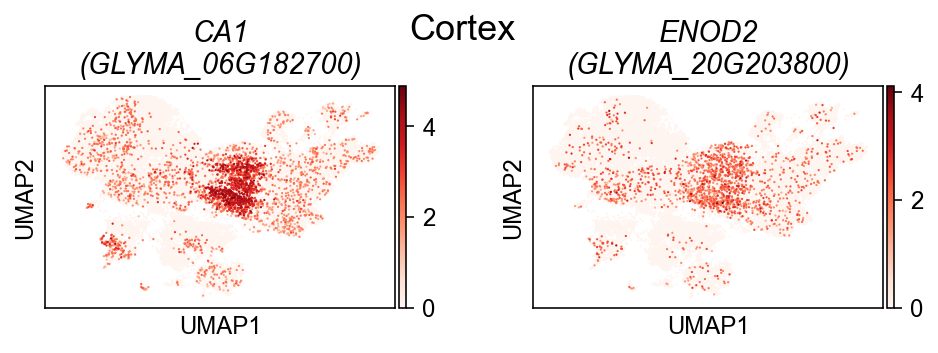

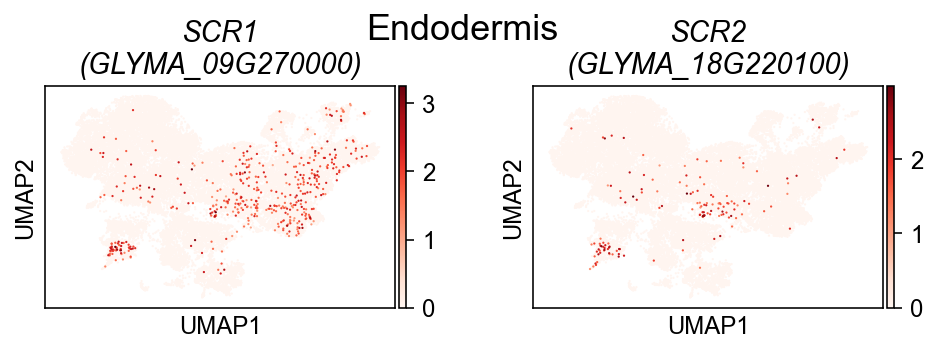

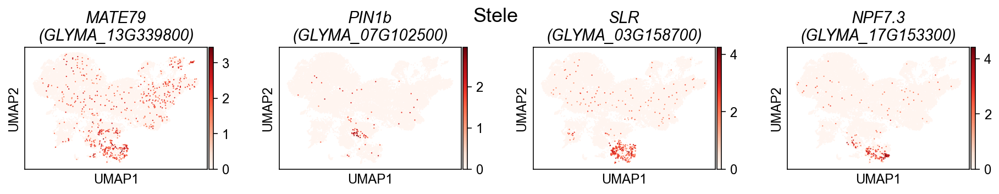

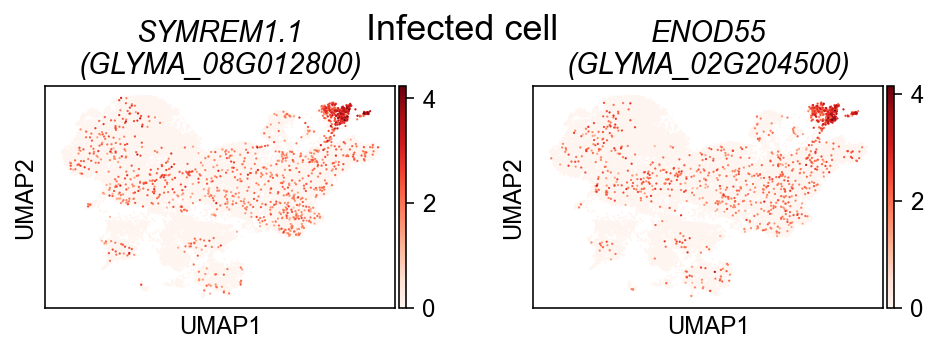

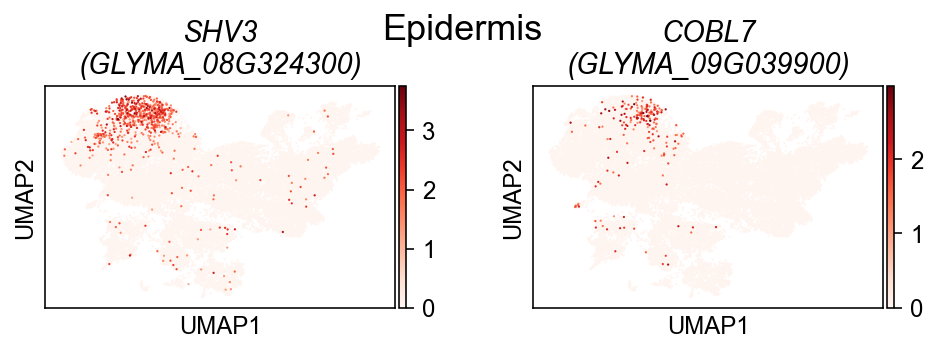

In [997]:
with plt.rc_context({"figure.figsize": (3, 2)}):
    for (celltype, _dt_genes), x in zip(
        dt_visualizationGene.items(), [0.48, 0.48, 0.44, 0.48, 0.48]
    ):
        if celltype == "Infection Zone":
            axs = sc.pl.umap(
                ad,
                layer="normalize_log",
                cmap="Reds",
                color=_dt_genes.keys(),
                title=_dt_genes.values(),
                size=5,
                vmin=2,
                show=False,
            )
        else:
            axs = sc.pl.umap(
                ad,
                layer="normalize_log",
                cmap="Reds",
                color=_dt_genes.keys(),
                title=_dt_genes.values(),
                size=5,
                show=False,
            )
            
        if len(_dt_genes) == 1:
            axs = [axs]
        for ax in axs:
            plt.sca(ax)
            text = ax.get_title()
            plt.title(text, fontdict={"style": "italic"})
            
        plt.suptitle(celltype, x=x, y=1.15, fontsize=18)
        plt.show()

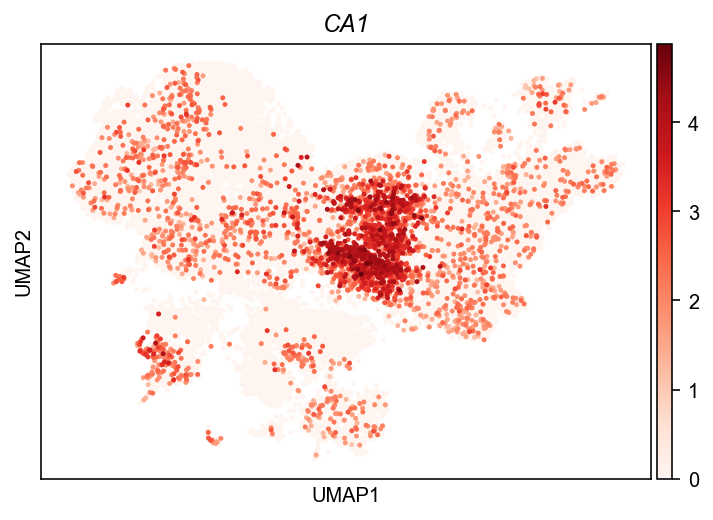

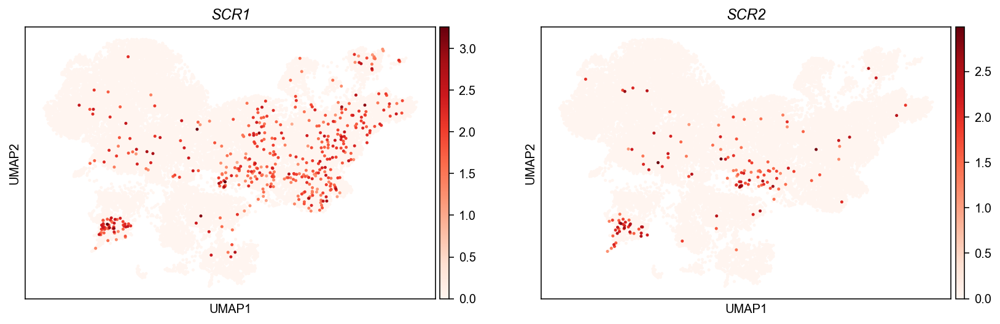

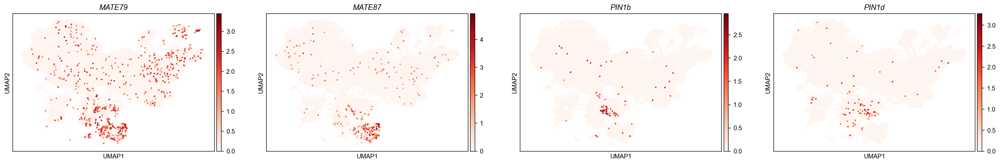

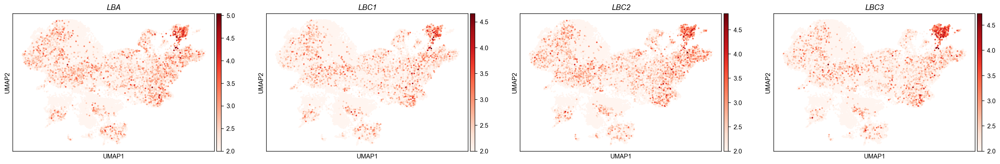

In [524]:
for celltype, _dt_genes in dt_visualizationGene.items():
    if celltype == 'Infection Zone':
        vmin = 2
    else:
        vmin = 0
    axs = sc.pl.umap(
        ad,
        layer="normalize_log",
        cmap="Reds",
        color=_dt_genes.values(),
        title=_dt_genes.keys(),
        size=25,
        show=False, vmin=vmin
    )
    if len(_dt_genes) == 1:
        axs = [axs]
    for ax in axs:
        plt.sca(ax)
        text = ax.get_title()
        plt.title(text, fontdict={"style": "italic"})
#     plt.suptitle(celltype, x=0.48, fontsize=16)

## by ara

In [67]:
dt_arab2soybean = pd.read_table(
    "/public/home/liuzj/data/ortholog/plant/parsed/1v1/arab__v__soybase_2.1v1.tsv"
).set_index("arab")["soybase_2"].to_dict()

In [68]:
ad_ara = sc.read_h5ad('/data/Zhaijx/liuzj/projects/singleCellRoot/bioaxivData/GSE152766_Root_Atlas.h5ad')
ad_ara = ad_ara[:, ad_ara.var.index.isin(list(dt_arab2soybean.keys()))]
ad_ara.var.index = ad_ara.var.index.map(dt_arab2soybean)
ad_ara.obs['specie'] = 'arabidopsis'

Trying to set attribute `.obs` of view, copying.


In [69]:
ad_root = ad[ad.obs['batch'] == 'root'].copy()

In [70]:
ad_root.obs['orig.ident'] = 'soybean'
ad_root.obs['specie'] = 'soybean'

In [55]:
toPkl(ad_ara, 'ad_ara', 'scem')
toPkl(ad_root, 'ad_root', 'scem')

0
0


In [64]:
# ad_root = loadPkl('ad_root').copy()
# ad_ara = loadPkl('ad_ara').copy()

# ad_ara = ad_ara[ad_ara.obs['time.anno'].isin(['Maturation'])]
# ad_ara = ad_ara[~ad_ara.obs['celltype.anno'].isin(['Putative Quiescent Center', 'Stem Cell Niche', 'Columella', 'Lateral Root Cap'])]

# ad_integrated = singleCellTools.scvi.labelTransferByScanvi(
#     ad_ara,
#     "celltype.anno",
#     "raw",
#     ad_root,
#     "raw",
#     True,
#     ["orig.ident", "specie"],
#     max_epochs=200,
#     mode="merge",
#     batch_size_ref=2**11, 
#     dt_params2SCVIModel = {'n_layers': 4},
#     dt_params2SCANVIModel = {'n_layers':4},
#     hvgBatch='specie',
#     n_top_genes=500)

# ad_root = loadPkl('ad_root').copy()
# ad_integrated = loadPkl('ad_integrated').copy()


# toPkl(ad_root, 'ad_root', 'ipf', dir_path=dir_temp)
# toPkl(ad_integrated, 'ad_integrated', 'ipf', dir_path=dir_temp)

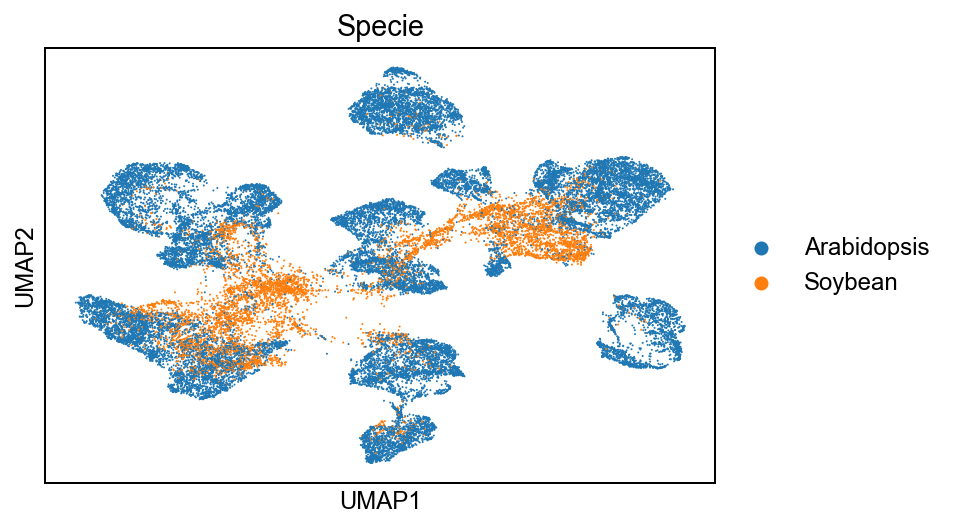

In [135]:
_dt = {'arabidopsis': 'Arabidopsis', 'soybean':'Soybean'}
ad_integrated.obs['Specie'] = ad_integrated.obs['specie'].map(_dt)
sc.pl.umap(ad_integrated, color='Specie', )

In [162]:
ad_root.obs["labelTransfer_scanvi_celltype.anno"] = (
    ad_root.obs["labelTransfer_scanvi_celltype.anno"]
    .str.capitalize()
    .astype("category")
    .cat.reorder_categories(
        [
            "Atrichoblast",
            "Cortex",
            "Endodermis",
            "Pericycle",
            "Phloem",
            "Procambium",
            "Trichoblast",
            "Xylem",
            "Unknown",
        ]
    )
)

In [172]:
ad_integrated.obs['scANVI_results'] = ad_root.obs['labelTransfer_scanvi_celltype.anno'] 
ad_root.obs['Cluster'] = ad.obs['Cluster']
ad_integrated.obs['Cluster'] = ad.obs['Cluster'] 

Trying to set attribute `.uns` of view, copying.


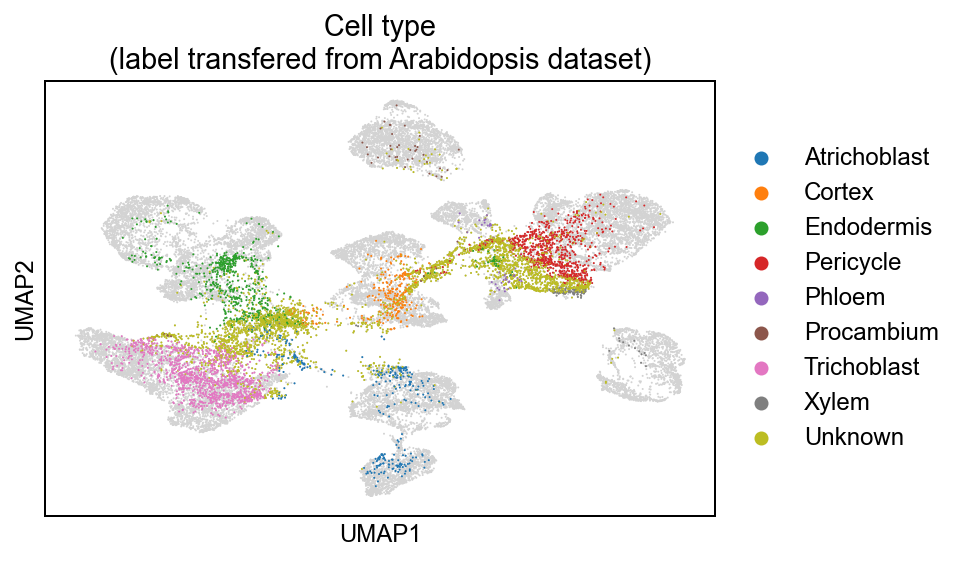

Trying to set attribute `.uns` of view, copying.


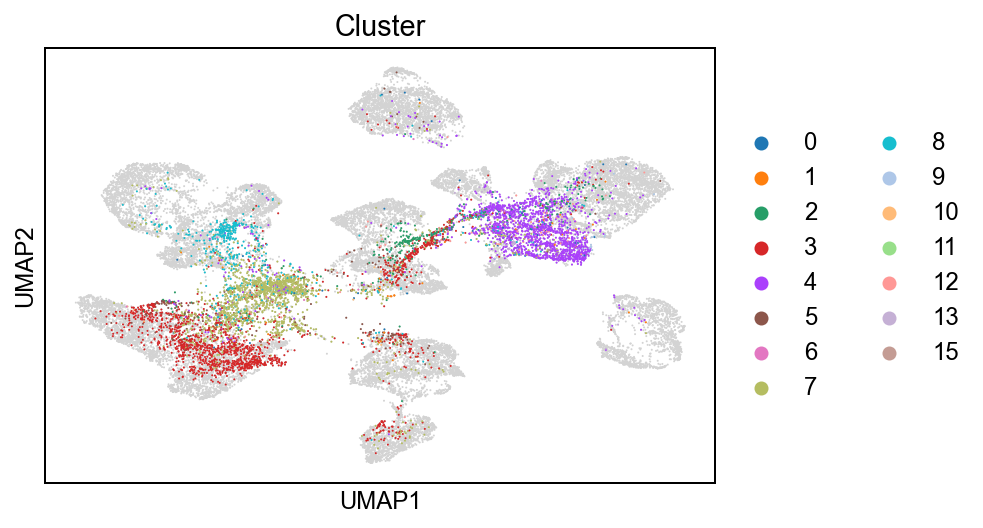

In [170]:
_ad = ad_integrated[ad_integrated.obs.eval("Specie == 'Soybean'")]
ax = sc.pl.umap(ad_integrated, show=False)
sc.pl.umap(
    _ad,
    show=False,
    ax=ax,
    title="Cell type\n(label transfered from Arabidopsis dataset)",
    color="scANVI_results",
    size=12e4 / len(ad_integrated),
)
plt.show()

_ad = ad_integrated[ad_integrated.obs.eval("Specie == 'Soybean'")]
ax = sc.pl.umap(ad_integrated, show=False)
sc.pl.umap(
    _ad,
    show=False,
    ax=ax,
    color="Cluster",
    size=12e4 / len(ad_integrated),
)
plt.show()

In [188]:
ad_root = loadPkl(
    "ad_root",
    dir_path="/public/home/liuzj/projects/singleCell/02_jupyter/soybean/2021_11_12",
)

<AxesSubplot:title={'center':'Cell type\n(label transfered from Arabidopsis dataset)'}, xlabel='UMAP1', ylabel='UMAP2'>

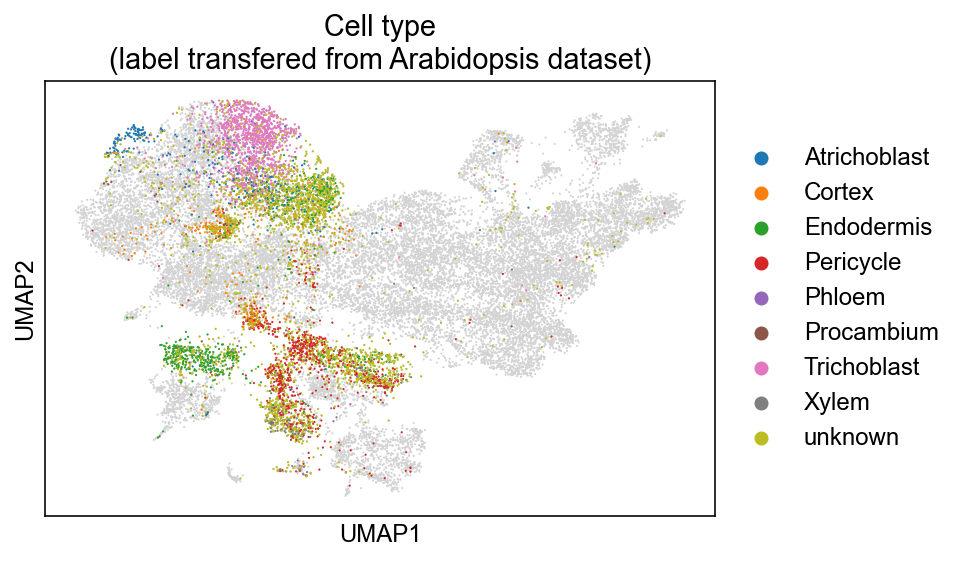

In [189]:
ax = sc.pl.umap(ad, show=False)
sc.pl.umap(
    ad_root,
    color="labelTransfer_scanvi_celltype.anno",
    ax=ax,
    size=12e4 / len(ad),
    title="Cell type\n(label transfered from Arabidopsis dataset)",
    show=False
)
# plt.legend(ncol=4, frameon=False, bbox_to_anchor=(0,1))

In [210]:
_dt = {
    "Atrichoblast": "Epidermis",
    "Pericycle": "Stele",
    "Phloem": "Stele",
    "Procambium": "Stele",
    "Trichoblast": "Epidermis",
    "Xylem": "Stele",
    "unknown": "Unknown",
}

In [211]:
ad_root.obs["labelTransfer_results"] = ad_root.obs[
    "labelTransfer_scanvi_celltype.anno"
].map(lambda x: _dt.get(x, x))

In [215]:
_dt = singleCellTools.basic.getadataColor(ad_root, 'labelTransfer_results')
_dt['Unknown'] = '#808080'
singleCellTools.basic.setadataColor(ad_root, 'labelTransfer_results', _dt);

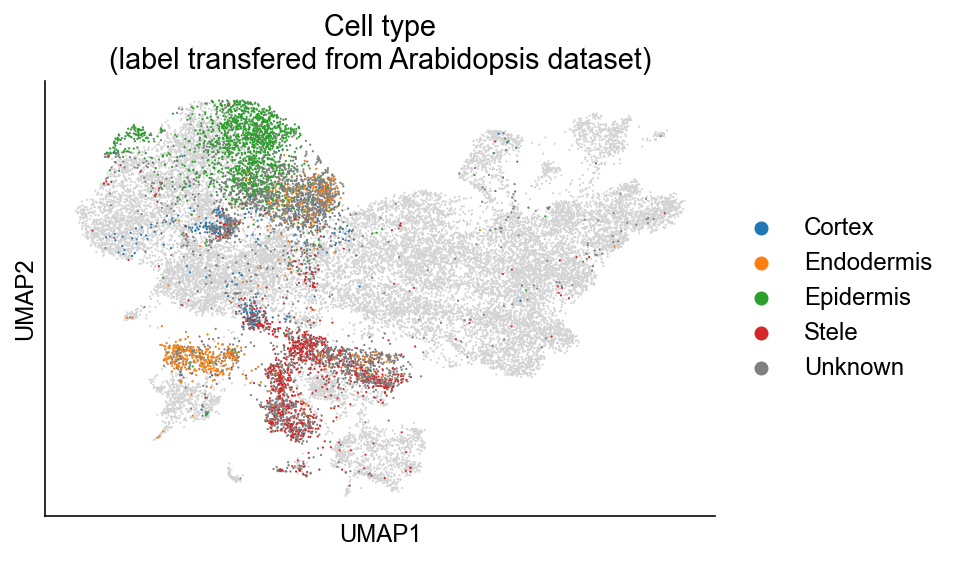

In [232]:
ax = sc.pl.umap(ad, show=False)
sc.pl.umap(
    ad_root,
    color="labelTransfer_results",
    ax=ax,
    size=12e4 / len(ad),
    title="Cell type\n(label transfered from Arabidopsis dataset)",
    show=False
)
sns.despine()
# plt.legend(ncol=4, frameon=False, bbox_to_anchor=(0,1))

In [52]:
# ad.obs['labelTransfer_scanvi_celltype.anno'] = ad_integrated.obs['labelTransfer_scanvi_celltype.anno']
# ad.obs['labelTransfer_scanvi_time.celltype.anno'] = ad_integratedZone.obs['labelTransfer_scanvi_time.celltype.anno']

In [217]:
ad_root.obs['Cluster'] = ad.obs['Cluster']

In [224]:
ad_root.obs['Cluster'].value_counts().loc[lambda x:x >= 100].index.to_list()

['3', '6', '5', '8', '2', '10', '4', '13']

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

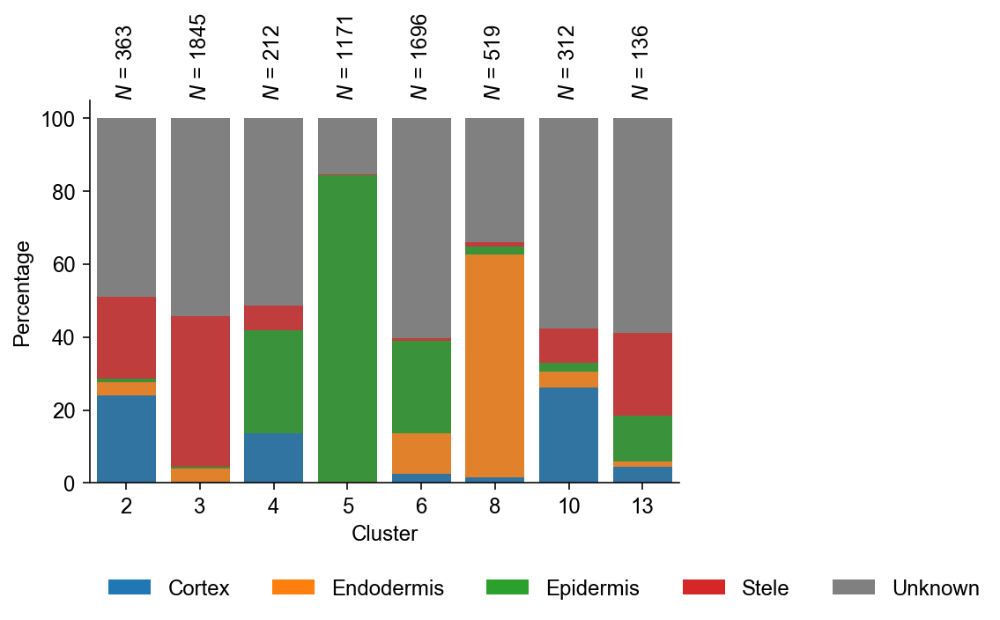

In [231]:
_ls = ad_root.obs["Cluster"].value_counts().loc[lambda x: x >= 100].index.to_list()
_ad = ad_root[ad_root.obs.eval("Cluster in @_ls")]
singleCellTools.plotting.plotLabelPercentageInCluster(
    _ad, "Cluster", "labelTransfer_results", dt_kwargsForLegend=dict(ncol=5, loc='upper left', bbox_to_anchor=(0,-0.2))
)

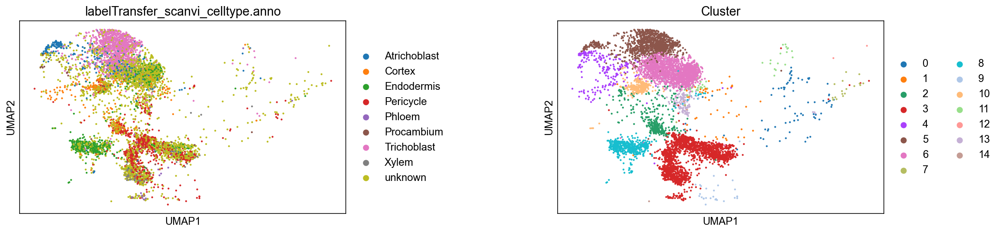

In [219]:
sc.pl.umap(ad_root, color=['labelTransfer_scanvi_celltype.anno', 'Cluster'], wspace=0.5,)

## by spatial

### deconvolution

In [ ]:
ad_st = loadPkl('ad_afterTissueCut_polished', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_temp)

In [ ]:
ad_sc = sc.read_h5ad(f"{dir_result}/ad_20220311.v1.h5ad")
ad_scNodule = ad_sc[ad_sc.obs.eval("Sample != 'Root'")].copy()

In [ ]:
toPkl(ad_st, 'ad_st', 'scem')
toPkl(ad_scNodule, 'ad_scNodule', 'scem')

In [ ]:
# scem :

# ad_st = loadPkl('ad_st', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')
# ad_scNodule = loadPkl('ad_scNodule', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')

# ls_keepCluster = ad_scNodule.obs['Cluster'].value_counts().pipe(lambda sr:sr[sr > 500].index.to_list())
# ad_scNoduleFiltered = ad_scNodule[ad_scNodule.obs.eval("Cluster in @ls_keepCluster")]

# singleCellTools.spatialTools.getClusterScoreFromScDataByDestvi(
#     ad_st,
#     ad_scNoduleFiltered,
#     clusterKey="Cluster",
#     nFeatures=3000,
#     condScviEpoch=1000, 
#     destviEpoch=4000, 
#     minUmiCountsInStLayer = 10, 
#     batchSize=1024, hvgLabel='Sample',  
#     hvgScDataOnly=True,
#     # dt_condScviConfigs={'n_layers':4},
# )
# toPkl(ad_st, 'ad_st_afterDeconvolution', 'ipf')

In [ ]:
ad_st = loadPkl('ad_st_afterDeconvolution', lambda **dt:sc.read_h5ad(**dt), arg_path='filename',  dir_path=dir_result)

... storing 'destVI_results' as categorical
... storing 'destVI_results_merged' as categorical


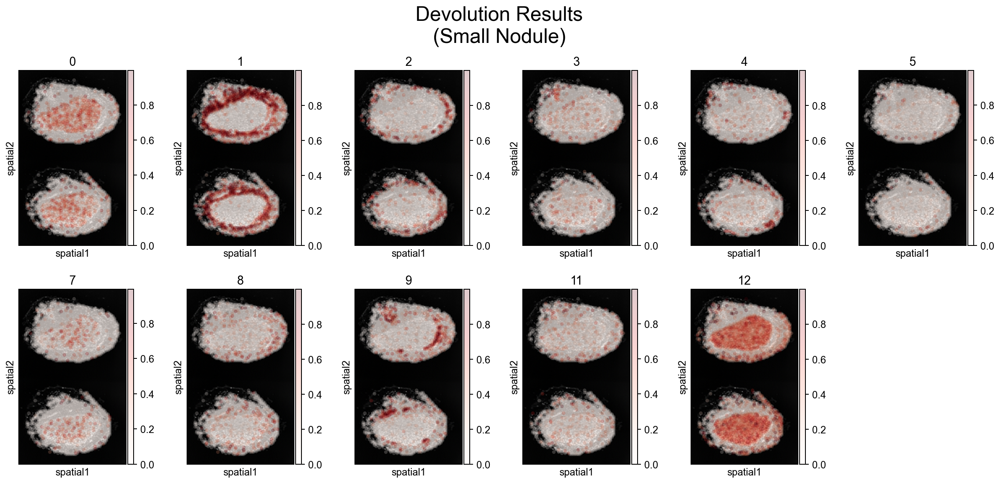

In [1020]:
with plt.rc_context({"figure.figsize": (3.5, 4)}):
    sc.pl.spatial(
        singleCellTools.plotting.obsmToObs(_ad_stSm, "proportions"),
        color=ad_st.obsm["proportions"].columns[:-1],
        size=0.2,
        cmap="Reds",
        wspace=0,
        alpha=0.2,
        ncols=6,
        show=False,
    )
    plt.suptitle("Devolution Results\n(Small Nodule)", x=0.45, y=1.02, fontsize=24)

... storing 'destVI_results' as categorical
... storing 'destVI_results_merged' as categorical


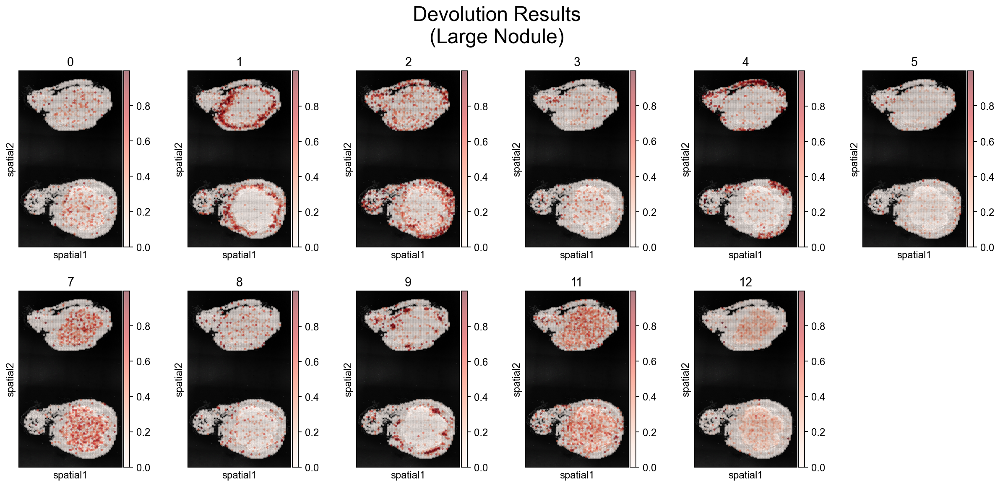

In [1019]:
with plt.rc_context({"figure.figsize": (3.5, 4)}):
    sc.pl.spatial(
        singleCellTools.plotting.obsmToObs(_ad_stLg, "proportions"),
        color=ad_st.obsm["proportions"].columns[:-1],
        size=0.2,
        cmap="Reds",
        wspace=0,
        alpha=0.5,
        ncols=6,
        show=False,
    )
    plt.suptitle("Devolution Results\n(Large Nodule)", x=0.45, y=1.02, fontsize=24)

### add cross-cut image

In [726]:
ad_stAlign = sc.read_h5ad(f"{dir_result}/st_alignCross_0503.h5ad")

In [727]:
ar_image = ad_stAlign.uns["spatial"]["Soybean"]["images"]["cross"]
ar_fill = np.logical_and(
    np.logical_and(ar_image[:, :, 0] < 8, ar_image[:, :, 1] < 8), ar_image[:, :, 2] < 8
)
ar_fill = np.dstack((ar_fill, ar_fill, ar_fill, np.ones_like(ar_fill)))

In [728]:
import cv2

ar_image = ar_image.astype(np.uint8)
coordinates = np.array([[0, 418], [230, 430], [230, 446], [0, 446]])

mask = np.zeros(ar_image.shape[:2], dtype=np.int8)
ar_image = cv2.fillPoly(ar_image, [coordinates], (255, 255, 255, 255))

In [729]:
ad_stAlign.uns["spatial"]["Soybean"]["images"]["cross"] = np.where(
    ar_fill,
    [np.array([255, 255, 255, 255])],
    ar_image,
)

In [730]:
ar_image = ad_stAlign.uns["spatial"]["Soybean"]["images"]["cross"].copy()

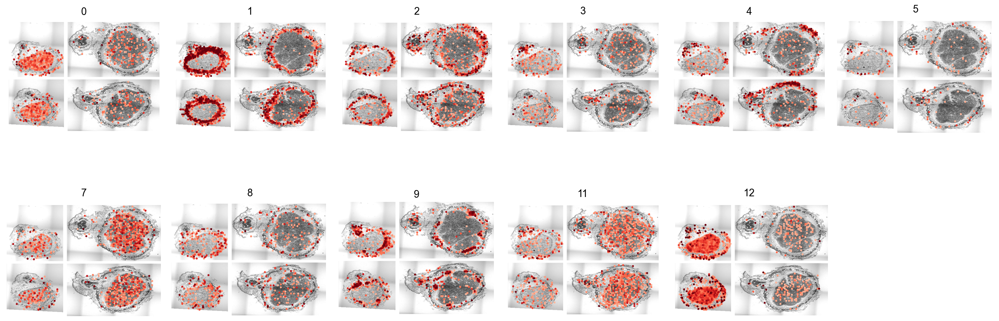

In [732]:
fig, axs = plt.subplots(2,6, figsize=(20,8))
axs = axs.reshape(-1)
ls_useCluster = ad_stAlign.obsm['proportions'].columns[:-1]
for ax, cluster in zip(axs, ls_useCluster):
#     sc.pl.spatial(
#         ad_align,
#         size=0.075,
#         ax=ax,show=False,img_key="cross"
#     )
    _ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
    _ad = _ad[_ad.obs[cluster] > 0.25]
    sc.pl.spatial(
        _ad,
        color=cluster,
        size=0.2,
        ax=ax,
        cmap='Reds',
        vmin=0, vmax=1,colorbar_loc=None,show=False,img_key="cross"
    )
#     ax.invert_yaxis()
    sns.despine(left=True, bottom=True)
    plt.sca(ax)
    plt.xlabel('')
    plt.ylabel('')
axs[-1].set_visible(False)
plt.tight_layout()
plt.show()

In [2148]:
# ad_stAlign.write_h5ad(f"{dir_result}/stAlignedAndCuted.h5ad")

In [893]:
dt_cluster2Tissue = {
    "0": "Uninfected cells*",
    "1": "Inner cortex",
    "2": "Outer cortex*",
    "3": "Vascular bundle",
    "4": "Outer cortex*",
    "5": "Epidermis",
    "6": "Unknown",
    "7": "Uninfected cells*",
    "8": "Endodermis",
    "9":"Vascular bundle",
    "10":"Unknown",
    "11":"Uninfected cells*",
    "12":"Infected cells",
    "13":"Unknown",
    "14":"Unknown",
}
dt_cluster2Tissue = {x:y.rstrip('*') for x,y in dt_cluster2Tissue.items()}
dt_cluster2Tissue = {x:f"{x}\n({y})" for x,y in dt_cluster2Tissue.items()}

Text(0.5, 1.0, '12\n(Infected cells)')

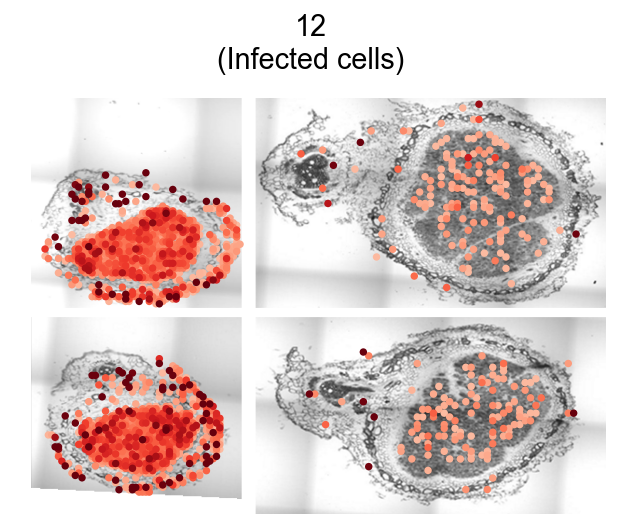

In [894]:
_ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
_ad = _ad[_ad.obs[cluster] > 0.25]
ax = sc.pl.spatial(
    _ad,
    color=cluster,
    size=0.2,
    cmap="Reds",
    vmin=0,
    vmax=1,
    colorbar_loc=None,
    show=False,
    img_key="cross",
)[0]
#     ax.invert_yaxis()
sns.despine(left=True, bottom=True)
plt.xlabel("")
plt.ylabel("")
plt.title(dt_cluster2Tissue[ax.get_title()])

In [26]:
# ad_stAlign = sc.read_h5ad(f"{dir_result}/stAlignedAndCuted.h5ad")

In [895]:
ax.get_xlim(), ax.get_ylim()


((-18.346480678304268, 617.3859695561097),
 (447.6898209228389, -19.078977186801858))

In [896]:
ls_useCluster

Index(['0', '1', '2', '3', '4', '5', '7', '8', '9', '11', '12'], dtype='object')

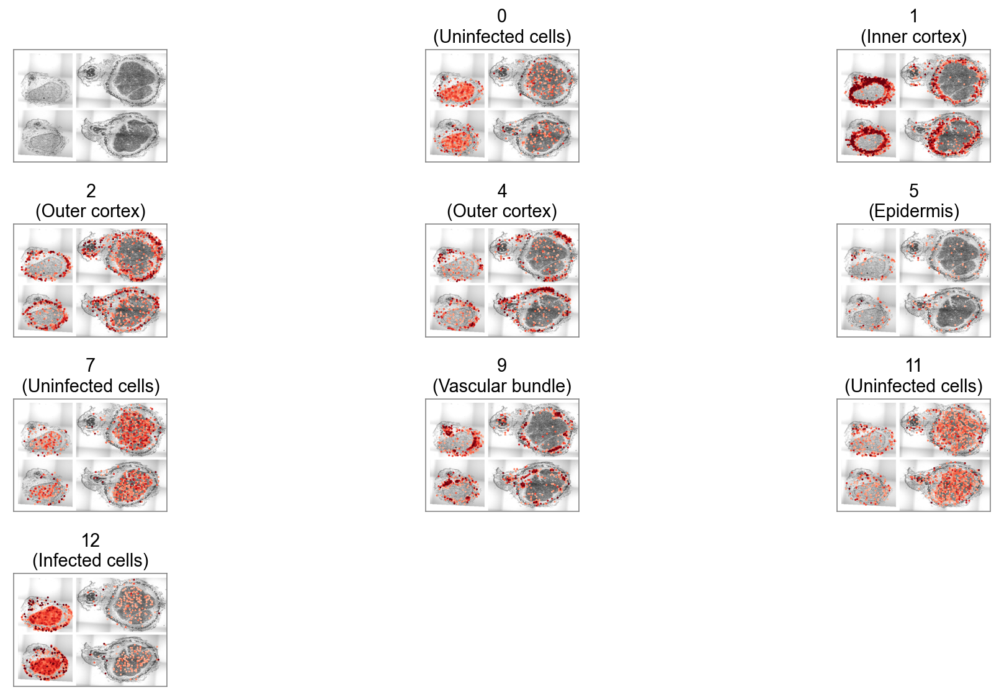

In [897]:
fig, axs = plt.subplots(4, 3, figsize=(14, 8))
axs = axs.reshape(-1)
ls_useCluster = ad_stAlign.obsm["proportions"].columns[:-1]
for ax, cluster in zip(axs[1:], [x for x in ls_useCluster if x not in ['3', '8']]):
    #     sc.pl.spatial(
    #         ad_align,
    #         size=0.075,
    #         ax=ax,show=False,img_key="cross"
    #     )
    _ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
    _ad = _ad[_ad.obs[cluster] > 0.25]
    sc.pl.spatial(
        _ad,
        color=cluster,
        size=0.2,
        ax=ax,
        cmap="Reds",
        vmin=0,
        vmax=1,
        colorbar_loc=None,
        show=False,
        img_key="cross",
    )
    #     ax.invert_yaxis()
    plt.sca(ax)
    plt.xlabel("")
    plt.ylabel("")
    plt.xlim(-18.346480678304268, 617.3859695561097)
    plt.ylim(447.6898209228389, -19.078977186801858)
    ax.spines['top'].set_color('grey') 
    ax.spines['right'].set_color('grey')
    ax.spines['bottom'].set_color('grey')
    ax.spines['left'].set_color('grey')
    plt.title(dt_cluster2Tissue[ax.get_title()])
ax = axs[0]
plt.sca(ax)
sc.pl.spatial(
    _ad,
    ax=axs[0],
    colorbar_loc=None,
    show=False,
    img_key="cross",
)
ax.spines['top'].set_color('grey') 
ax.spines['right'].set_color('grey')
ax.spines['bottom'].set_color('grey')
ax.spines['left'].set_color('grey')
plt.xlabel("")
plt.ylabel("")
plt.xlim(-18.346480678304268, 617.3859695561097)
plt.ylim(447.6898209228389, -19.078977186801858)

axs[-2].remove()
axs[-1].remove()
plt.tight_layout()
plt.show()

Text(0, 0.5, '')

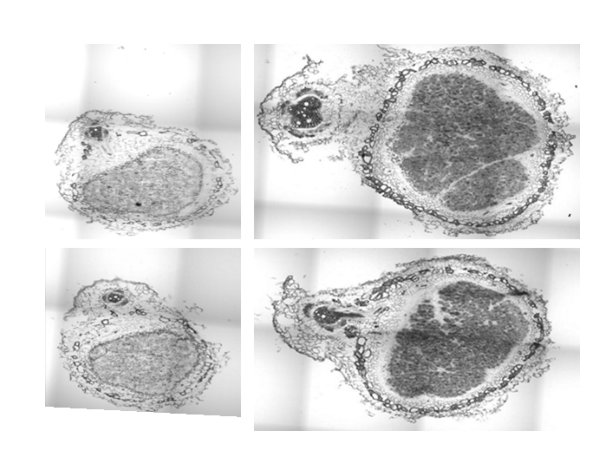

In [263]:
sc.pl.spatial(
    _ad,
    colorbar_loc=None,
    show=False,
    img_key="cross",
)
sns.despine(left=True, bottom=True)
plt.xlabel("")
plt.ylabel("")

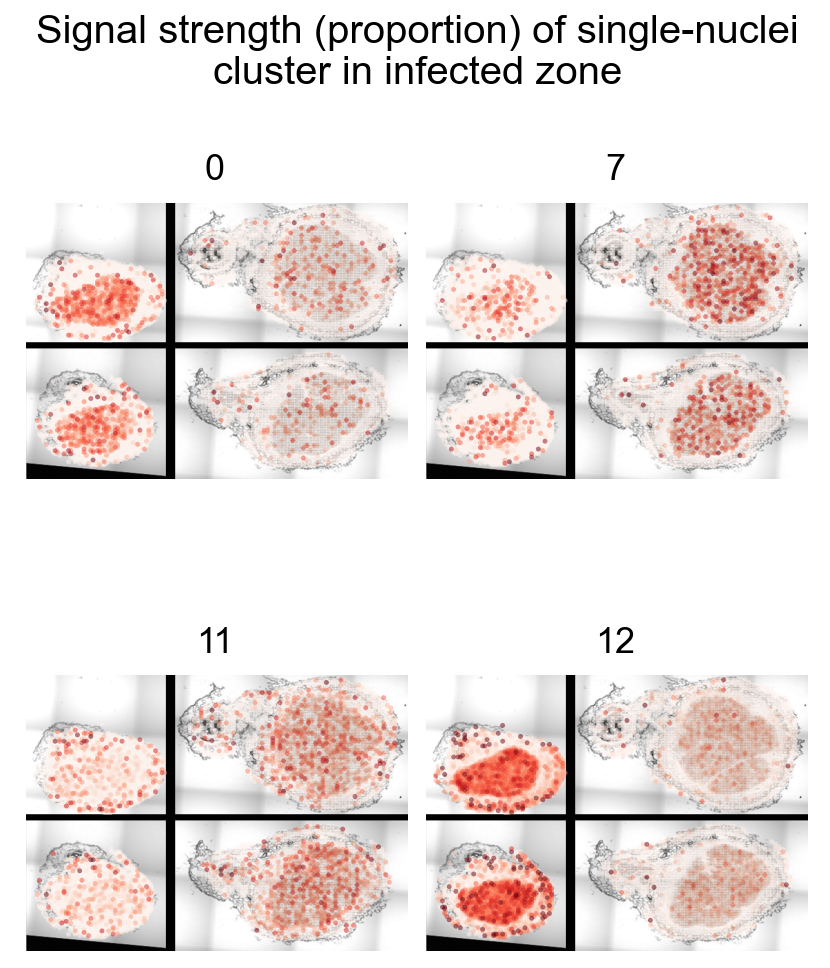

In [386]:
with plt.rc_context({"figure.figsize": (3.5, 4)}):
    axs = sc.pl.spatial(
        singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions"),
        color=["0", "7", "11", "12"],
        size=0.2,
        cmap="Reds",
        wspace=0,
        hspace=0,
        alpha=0.5,
        ncols=2,
        show=False,
        colorbar_loc=None,
        img_key="cross",
    )
    for ax in axs:
        plt.sca(ax)
        plt.xlabel("")
        plt.ylabel("")
        sns.despine(left=True, bottom=True)
        plt.title(ax.get_title(), fontdict=dict(size=18))
    plt.suptitle(
        "Signal strength (proportion) of single-nuclei\ncluster in infected zone",
        x=0.5,
        y=0.96,
        fontsize=20,
    )
    plt.show()

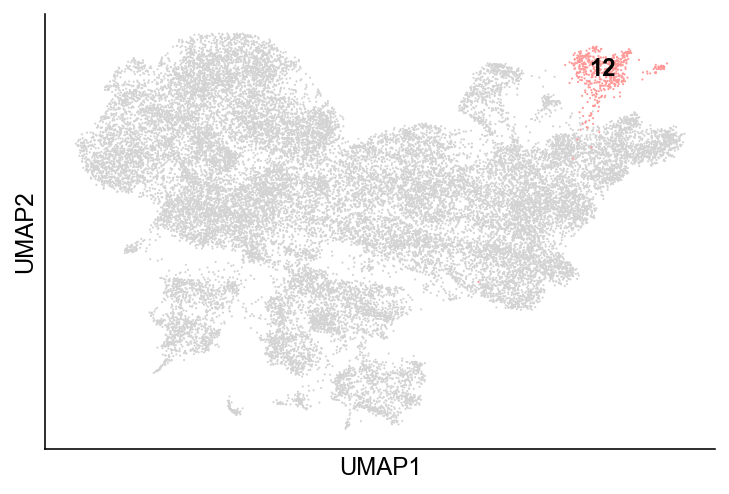

In [393]:
# fig, ax = plt.subplots(figsize=(6, 3))
_ls = ['12']
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False, groups = _ls)
# sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", groups=[dt_cluster2Tissue[x] for x in _ls], na_in_legend=False, legend_loc=None)
sns.despine(top=True, right=True)
# plt.legend(loc="upper left", bbox_to_anchor=(0, -0.1), ncol=2, frameon=False)
plt.title("")

plt.show()

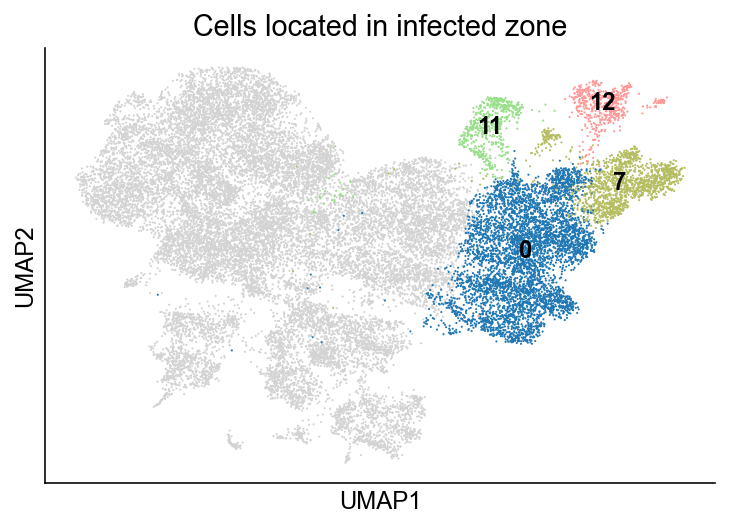

In [324]:
# fig, ax = plt.subplots(figsize=(6, 3))
_ls = ['0', '7', '11', '12']
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False, groups = _ls)
# sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", groups=[dt_cluster2Tissue[x] for x in _ls], na_in_legend=False, legend_loc=None)
sns.despine(top=True, right=True)
# plt.legend(loc="upper left", bbox_to_anchor=(0, -0.1), ncol=2, frameon=False)
plt.title("Cells located in infected zone")
plt.show()

#### figure 1a

In [268]:
ad_stLarge = ad_stAlign[ad_stAlign.obs.eval("batch == 'lg2'")]

Text(0, 0.5, '')

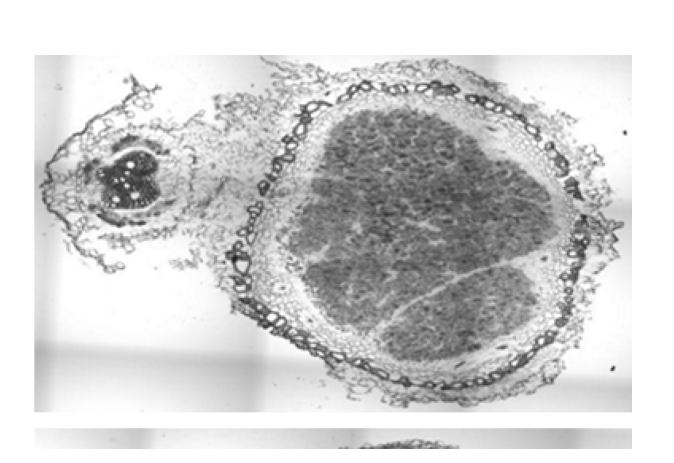

In [269]:
sc.pl.spatial(
    ad_stLarge,
    colorbar_loc=None,
    show=False,
    img_key="cross",
)
sns.despine(left=True, bottom=True)
plt.xlabel("")
plt.ylabel("")

In [784]:
dt_mergeStPropotion = {
    "0": ["0", "12", "7", "11"],
    "1": ["1"],
    "2": ["2", "4"],
    "3": ["9"],
}

In [785]:
def mergePropotion(line):
    
    dt_finalPropotion = {}
    for mergedCluster, ls_elementCluster in dt_mergeStPropotion.items():
        dt_finalPropotion[mergedCluster] = 0
        for element in ls_elementCluster:
            dt_finalPropotion[mergedCluster] += line.at[element]
    return pd.Series(dt_finalPropotion).rename(line.name)
                

In [786]:
ls_results = []
for _, line in ad_stLarge.obsm["proportions"].iterrows():
    ls_results.append(mergePropotion(line))

In [787]:
ad_stLarge.obsm['propotion_merged'] = pd.concat(ls_results, axis=1).T

In [788]:
ad_stLarge.obs['propotion_merged'] = np.where(
    ad_stLarge.obsm["propotion_merged"].max(1) > 0.5,
    ad_stLarge.obsm["propotion_merged"].idxmax(1),
    None,
)

In [789]:
_dt_color = singleCellTools.basic.getadataColor(ad, 'Cluster')

In [790]:
singleCellTools.basic.setadataColor(ad_stLarge, 'propotion_merged', _dt_color);

Text(0, 0.5, '')

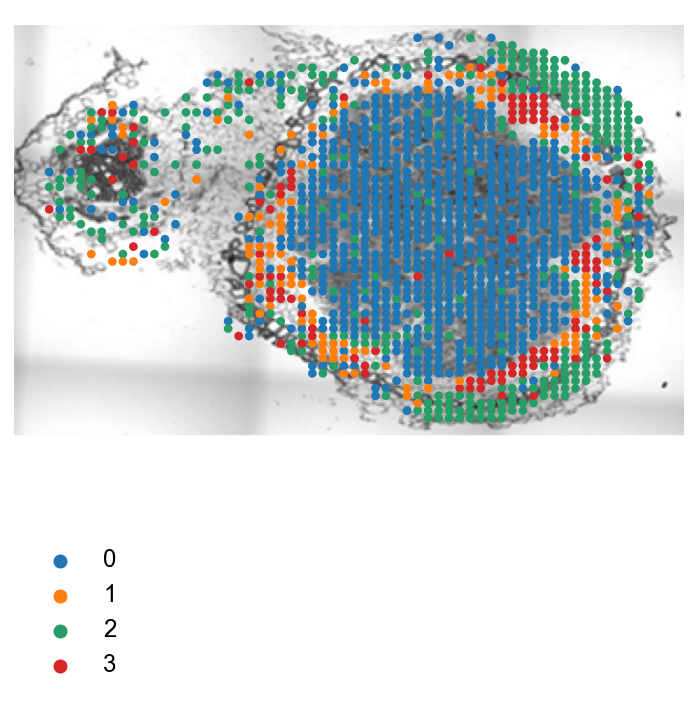

In [791]:
sc.pl.spatial(
    ad_stLarge,
    color="propotion_merged",
    title='',
    size=0.12,
    show=False,
    img_key="cross", na_in_legend=False
)
plt.legend(ncol=1, loc='upper left', bbox_to_anchor=(0,-0.2), frameon=False)
sns.despine(left=True, bottom=True)
plt.xlabel("")
plt.ylabel("")

### use lotus data to identify UC

In [1614]:
path_ljUcIcDEG = '/data/Zhaijx/liuzj/projects/singleCell/soybean/01_data/lj_pbj/lj_uc_ic.tsv'
path_ljGmOrth = '/data/Zhaijx/liuzj/data/ortholog/plant/parsed/1v1_soybean_maize_lotus/soybase_2__v__lotus.1v1.tsv'

In [1615]:
df_ljDeg = pd.read_table(path_ljUcIcDEG)
df_ljGmOrth = pd.read_table(path_ljGmOrth)
dt_ljGmOrth = df_ljGmOrth.set_index('lotus')['soybase_2'].to_dict()

In [212]:
ad_ifz = ad_sc[ad_sc.obs.eval("Cluster in ['0', '7', '11', '12']")].copy()

#### lj DEG in sc datasets

In [1616]:
df_ljDeg = (
    df_ljDeg.assign(
        gene=lambda df: df["Transcript ID \n(Lj 3.0)"].str.split(".").str[0]
    )
    .assign(gmGene=lambda df: df["gene"].map(dt_ljGmOrth))
    .dropna(subset=["gmGene"])
)
df_ljDeg = df_ljDeg.rename(columns = lambda x:x.replace('\n', '_'))
df_ljDeg['-log10FDR'] = - np.log10(df_ljDeg['FDR'])
df_ljDeg = df_ljDeg.query("`-log10FDR` > 4 & (`Log2FC_(IC vs UC)` < -10 | `Log2FC_(IC vs UC)` > 10)")

In [1617]:
df_ljDeg = df_ljDeg.pipe(
    lambda df: df.assign(category=np.where(df["Log2FC_(IC vs UC)"] > 0, "IC", "UC"))
)

In [1620]:
# df_ljDeg.to_excel(f"{dir_result}/ljDEG.xlsx")

In [209]:
dt_ljDeg = df_ljDeg.query('gmGene in @ad_sc.var.index').groupby('category')['gmGene'].agg(list).to_dict()

In [210]:
dt_ljDeg = {x: dt_ljDeg[x] for x in ["UC", "IC"]}

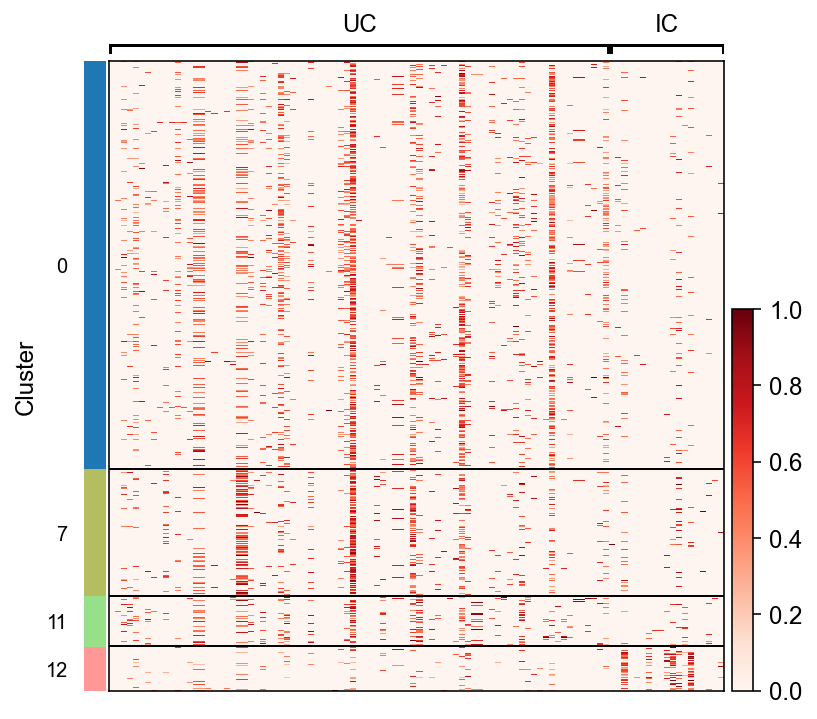

In [214]:
sc.pl.heatmap(
    ad_ifz,
    dt_ljDeg,
    "Cluster",
    cmap="Reds",
    layer="normalize_log",
    standard_scale="var",
    figsize=(6, 6),
)

on disk mode: False, transfer `<class 'scipy.sparse.csc.csc_matrix'>` to R:  End. Elapsed time: 15


R[write to console]: Quantiles for the number of genes detected by cell: 
(Non-detected genes are shuffled at the end of the ranking. Keep it in mind when choosing the threshold for calculating the AUC).



    min      1%      5%     10%     50%    100% 
 460.00  657.07  742.00  799.00 1246.00 3613.00 


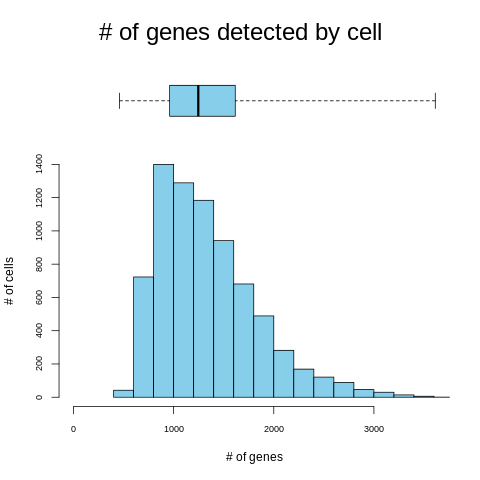

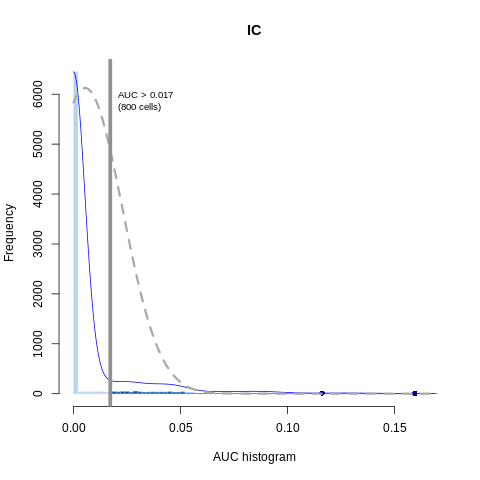

transfer `data.frame` to python:  End. Elapsed time: 1
transfer `data.frame` to python:  End. Elapsed time: 0
transfer `data.frame` to python:  End. Elapsed time: 0


In [216]:
singleCellTools.geneEnrichInfo.getAUCellScore(
    ad_ifz,
    dt_ljDeg,
    layer="raw",
)

In [229]:
from matplotlib import ticker

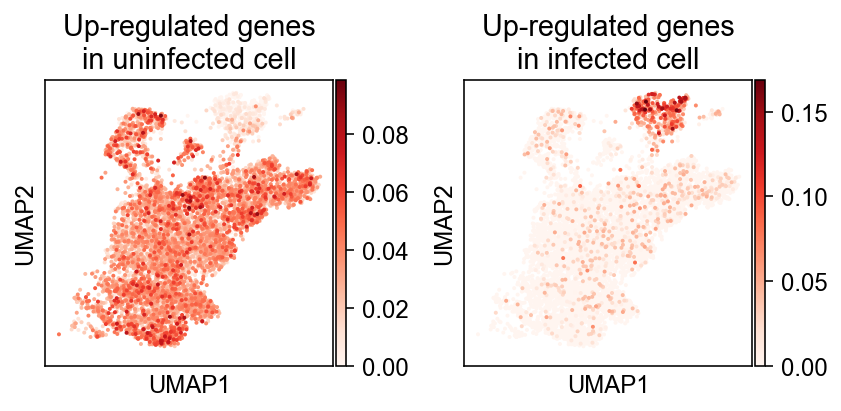

In [241]:
ls_title = [
    "Up-regulated genes\nin uninfected cell",
    "Up-regulated genes\nin infected cell",
]
with plt.rc_context({"figure.figsize": (6, 3)}):
    _ad = singleCellTools.plotting.obsmToObs(ad_ifz, "AUCell")
    fig, axs = plt.subplots(1, 2)
    axs = axs.reshape(-1)
    for label, title, ax in zip(_ad.uns["plot_obsm"], ls_title, axs):
        if label == "Cortex":
            sc.pl.umap(
                _ad, color=label, title=title, cmap="Reds", show=False, ax=ax, vmin=0.15
            )
        else:
            sc.pl.umap(_ad, color=label, title=title, cmap="Reds", show=False, ax=ax)
        plt.sca(ax)
        plt.xlim(3, 13)
    plt.tight_layout()

#### sc marker in lj

In [248]:
df_ljGem = pd.read_excel('/data/Zhaijx/liuzj/projects/singleCell/soybean/01_data/lj_pbj/pbi13778-sup-0002-tables1 (1).xlsx')
df_ljGem = df_ljGem.assign(gene=lambda df: df["Transcript"].str.split(".").str[0]).drop(
    columns="Transcript"
).groupby("gene").agg("sum")

In [252]:
df_ljGem = df_ljGem.loc[df_ljGem.index.isin(dt_ljGmOrth)]
df_ljGem.index = df_ljGem.index.map(dt_ljGmOrth)

In [254]:
ad_lj = sc.AnnData(df_ljGem.T)
ad_lj.var_names_make_unique()

In [257]:
ad_lj.layers['rpkm'] = ad_lj.X.copy()
ad_lj.obs["category"] = ["IC", "IC", "UC", "UC", "UC", "UC"]

In [10]:
df_scMarker = ad_sc.uns['Cell type_cellexES'].assign(
    Cluster=lambda df: df["Cell type"].str.split(":").str[0]
)

In [12]:
df_scMarker["Cluster"] = df_scMarker["Cluster"].astype("category").cat.set_categories(
    ["0", "1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12", "13", "14"]
)

In [21]:
df_scMarker.query(
    "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
).merge(df_symbol, left_on="gene", right_index=True, how="left").sort_values(
    ["Cell type", "enrichScore"], ascending=[True, False]
).to_excel(f"{dir_result}/cluster_marker.xlsx")

In [270]:
dt_scMarker = (
    df_scMarker.query(
        "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2 & gene in @ad_lj.var.index"
    )
    .groupby("Cluster")["gene"]
    .agg(list)
    .to_dict()
)

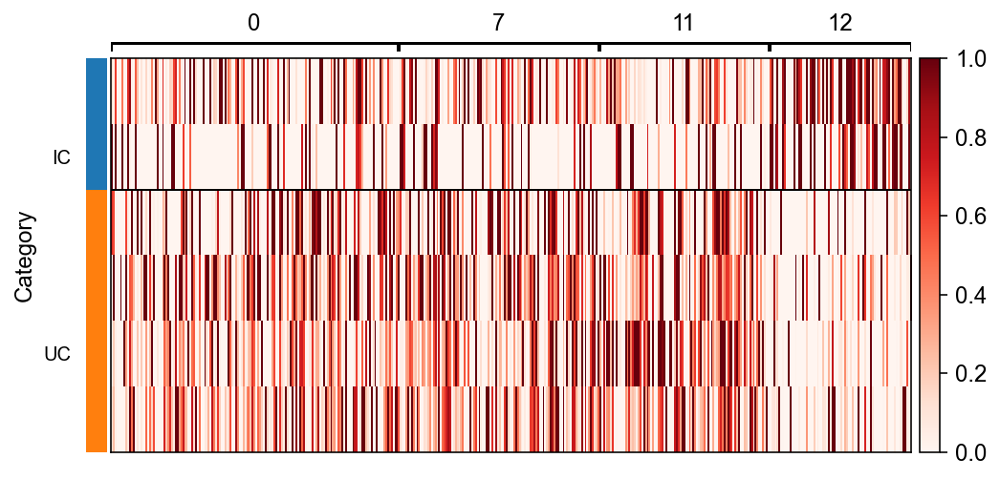

In [275]:
axs = sc.pl.heatmap(
    ad_lj,
    {x: dt_scMarker[x] for x in ["0", "7", "11", "12"]},
    "category",
    cmap="Reds",
    standard_scale="var",
    figsize=(8, 4),
    show=False,
)
plt.sca(axs["groupby_ax"])
plt.ylabel("Category")
plt.show()

#### verification

In [885]:
ls_gene = [
    "GLYMA_10G199100",
    "GLYMA_10G199000",
    "GLYMA_20G191200",
    "GLYMA_10G198800",
    "GLYMA_08G012800",
    "GLYMA_05G205900",
    "GLYMA_06G301500",
    "GLYMA_15G098100",
    "GLYMA_08G025500",
    "GLYMA_17G150100",
    "GLYMA_05G068000",
    "GLYMA_01G203400",
    "GLYMA_11G039400",
    "GLYMA_13G215000",
]
ls_name = [
    "LBA",
    "LBC1",
    "LBC2",
    "LBC3",
    "SYMREM1.1",
    "SYMREM1.2",
    "BMY1-1",
    "BMY1-2",
    "BMY1-3",
    "BMY2",
    "BMY3-1",
    "BMY3-2",
    "BMY3-3",
    "BMY9",
]

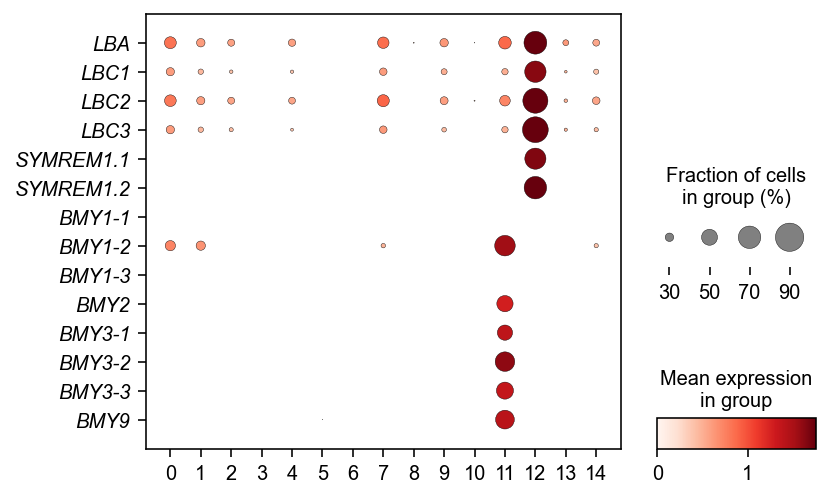

In [886]:
axs = sc.pl.dotplot(
    ad,
    ls_gene,
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(6, 4),
    dot_min=0.15,
    dot_max=0.9, vmax=1.75
)
plt.sca(axs["mainplot_ax"])
plt.xticks(rotation=0)
plt.yticks([x + 0.5 for x in range(len(ls_name))], ls_name, style="italic")
plt.show()

In [ ]:
{"SYMREM1.1": "GLYMA_08G012800", "N56": "GLYMA_13G024700", "ENOD55": "GLYMA_02G204500"}

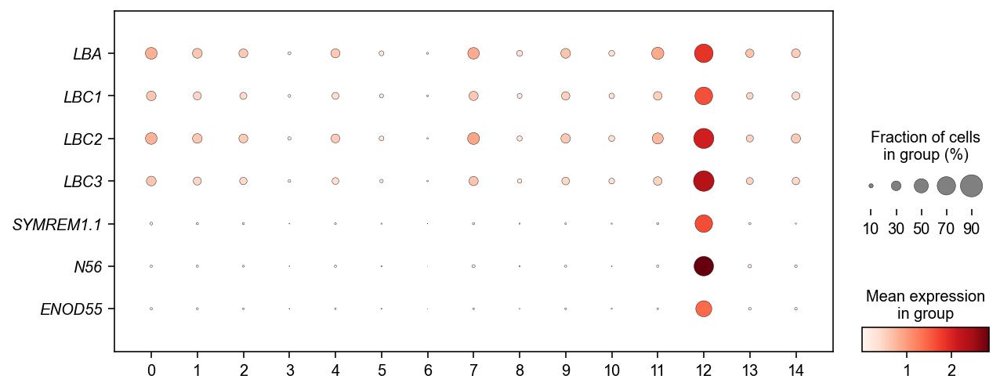

In [860]:
ls_gene = [
    "GLYMA_10G199100",
    "GLYMA_10G199000",
    "GLYMA_20G191200",
    "GLYMA_10G198800",
    "GLYMA_08G012800",
    "GLYMA_13G024700",
    "GLYMA_02G204500",
]
ls_name = ["LBA", "LBC1", "LBC2", "LBC3", "SYMREM1.1", "N56", "ENOD55"]
axs = sc.pl.dotplot(
    ad,
    ls_gene,
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(10, 4),
)
plt.sca(axs["mainplot_ax"])
plt.xticks(rotation=0)
plt.yticks([x + 0.5 for x in range(len(ls_name))], ls_name, style="italic")
plt.show()

In [909]:
ls_gene = [
    "GLYMA_06G301500",
    "GLYMA_15G098100",
    "GLYMA_08G025500",
    "GLYMA_17G150100",
    "GLYMA_05G068000",
    "GLYMA_01G203400",
    "GLYMA_11G039400",
    "GLYMA_13G215000",
    "GLYMA_01G058500",
    "GLYMA_02G116300",
    "GLYMA_02G116400",
    "GLYMA_20G072400",
    "GLYMA_14G111800",
    "GLYMA_17G216000",
]
ls_name = [
    "BMY1-1",
    "BMY1-2",
    "BMY1-3",
    "BMY2",
    "BMY3-1",
    "BMY3-2",
    "BMY3-3",
    "BMY9",
    "UPS2-1",
    "UPS2-2",
    "UPS2-3",
    "UR2",
    "ASP5-1",
    "ASP5-2",
]

In [898]:
ls_gene = [
    "GLYMA_15G098100",
    "GLYMA_17G150100",
    "GLYMA_05G068000",
    "GLYMA_01G203400",
    "GLYMA_11G039400",
    "GLYMA_13G215000",
    "GLYMA_01G058500",
    "GLYMA_02G116300",
    "GLYMA_20G072400",
    "GLYMA_14G111800",
    "GLYMA_17G216000",
]
ls_name = [
    "BMY1-2",
    "BMY2",
    "BMY3-1",
    "BMY3-2",
    "BMY3-3",
    "BMY9",
    "UPS2-1",
    "UPS2-2",
    "UR2",
    "ASP5",
    "ASP5",
]
ls_name = [f"{x}\n({y})" for x,y in zip(ls_gene, ls_name)]

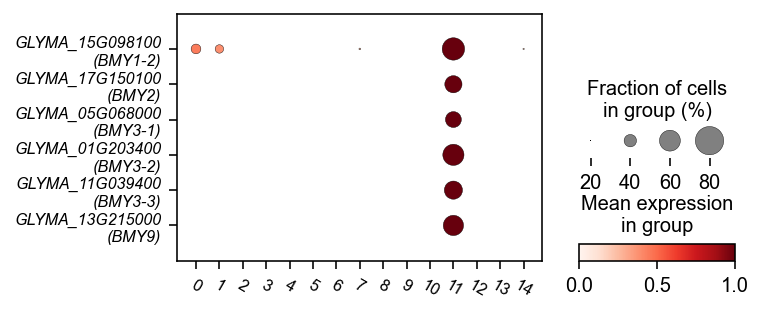

In [943]:
axs = sc.pl.dotplot(
    ad,
    ls_gene[:6],
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(5, 5 / 11 * 5),
    dot_min=0.2,
    dot_max=0.8,
    standard_scale="var",
)
plt.sca(axs["mainplot_ax"])
plt.yticks([x + 0.5 for x in range(len(ls_name[:6]))], ls_name[:6], style="italic", size=8)
plt.xticks(rotation=-30, ha="center", size=8)
plt.show()

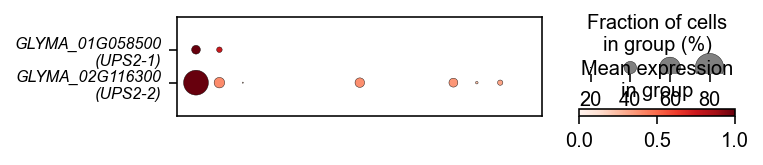

In [944]:
axs = sc.pl.dotplot(
    ad,
    ls_gene[6:8],
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(5, 2 / 11 * 5),
    dot_min=0.2,
    dot_max=0.8,
    standard_scale="var",
)
plt.sca(axs["mainplot_ax"])
plt.yticks([x + 0.5 for x in range(len(ls_name[6:8]))], ls_name[6:8], style="italic", size=8)
plt.xticks([])
plt.tick_params(bottom=False)
plt.show()

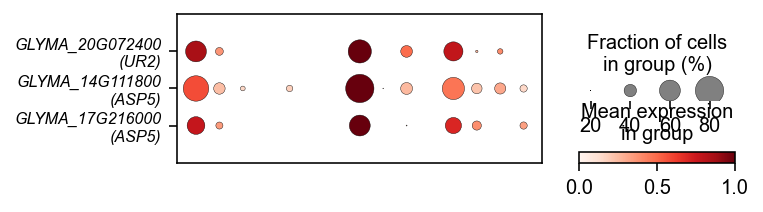

In [945]:
axs = sc.pl.dotplot(
    ad,
    ls_gene[8:],
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(5, 3 / 11 * 5),
    dot_min=0.2,
    dot_max=0.8,
    standard_scale="var",
)
plt.sca(axs["mainplot_ax"])
plt.yticks([x + 0.5 for x in range(len(ls_name[8:]))], ls_name[8:], style="italic", size=8)
plt.xticks([])
plt.tick_params(bottom=False)
plt.show()

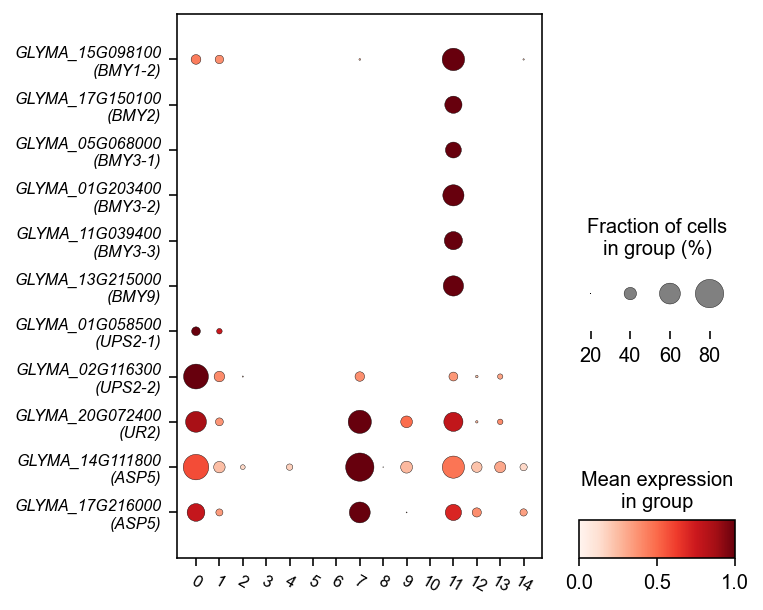

In [927]:
axs = sc.pl.dotplot(
    ad,
    ls_gene,
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(5, 5),
    dot_min=0.2,
    dot_max=0.8,
    standard_scale="var",
)
plt.sca(axs["mainplot_ax"])
plt.xticks(rotation=-30, ha="center", size=8)
plt.yticks([x + 0.5 for x in range(len(ls_name))], ls_name, style="italic", size=8)
plt.show()

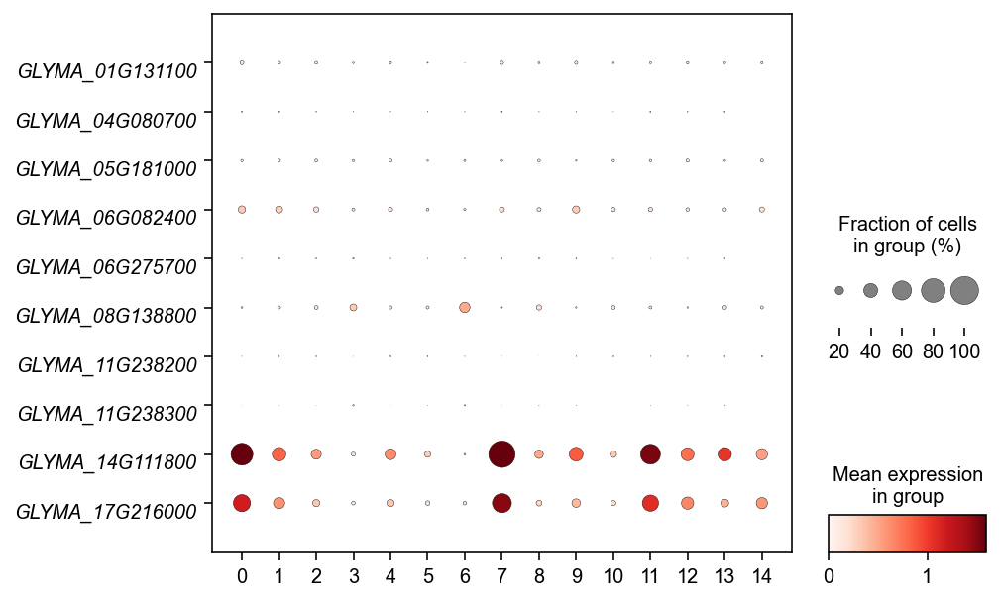

In [181]:
# aspartate aminotransferase
_ls = (
    """Glyma.01g131100
Glyma.04g080700
Glyma.05g181000
Glyma.06g082400
Glyma.06g275700
Glyma.08g138800
Glyma.11g238200
Glyma.11g238300
Glyma.14g111800
Glyma.17g216000""".split()
    | F(map, lambda x: x.replace("Glyma.", "GLYMA_").upper())
    | F(list)
)
_ls_name = _ls[:]
# _ls_name[-2] = "GLYMA_14G111800\n(ASP5-1)"
# _ls_name[-1] = "GLYMA_17G216000\n(ASP5-2)"

axs = sc.pl.dotplot(
    ad,
    _ls,
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    swap_axes=True,
    show=False,
    figsize=(7, 5),
    vmax=1.6,
)
plt.sca(axs["mainplot_ax"])
plt.yticks([x + 0.5 for x in range(len(_ls))], _ls_name, style="italic", rotation=0, va='top')
plt.xticks(rotation=0)
plt.show()

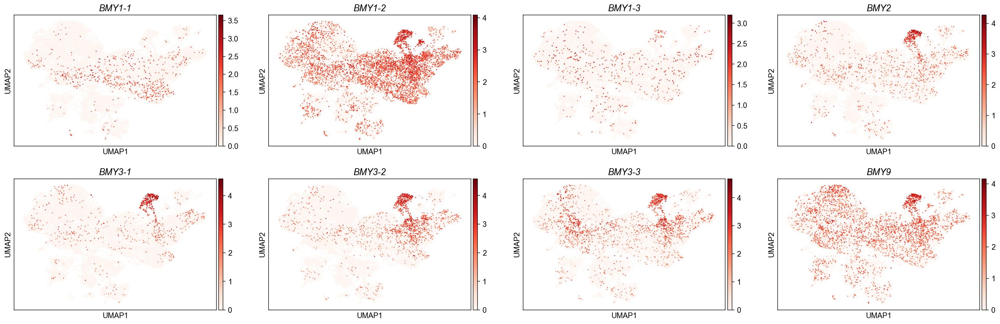

In [93]:
axs = sc.pl.umap(
    ad,
    layer="normalize_log",
    cmap="Reds",
    color=ls_gene,
    title=ls_name,
    size=10, show=False, ncols=4
)
for ax in axs:
    plt.sca(ax)
    text = ax.get_title()
    plt.title(text, fontdict={'style': 'italic'})

In [506]:
ls_gene = [
    "GLYMA_08G012800",
    "GLYMA_05G205900",
]
ls_name = [
    "SYMREM1.1",
    "SYMREM1.2",
]

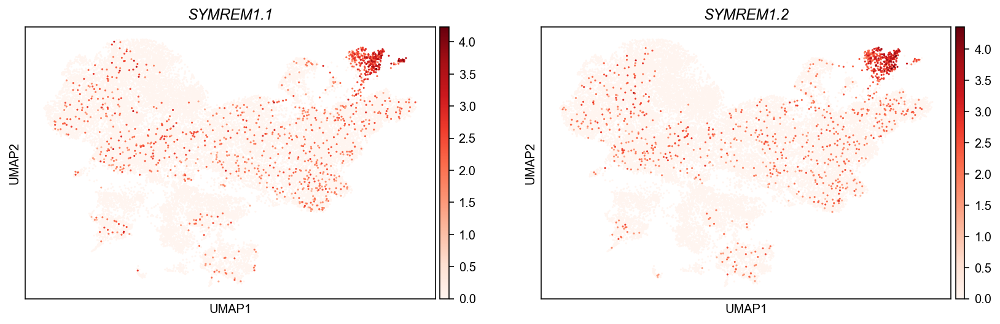

In [509]:
axs = sc.pl.umap(
    ad,
    layer="normalize_log",
    cmap="Reds",
    color=ls_gene,
    title=ls_name,
    size=10, show=False
)
for ax in axs:
    plt.sca(ax)
    text = ax.get_title()
    plt.title(text, fontdict={'style': 'italic'})

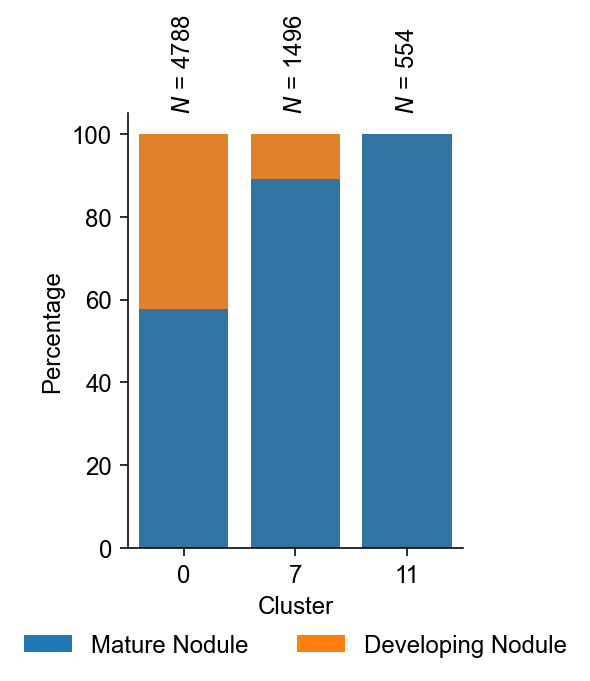

In [1964]:
with plt.rc_context({"figure.figsize": (3, 4)}):
    _ls = ["0", "7", "11"]
    singleCellTools.plotting.plotLabelPercentageInCluster(
        ad[ad.obs.eval("Cluster in @_ls & Sample != 'Root'")],
        "Cluster",
        "Sample_new",
        dt_kwargsForLegend={
            "bbox_to_anchor": [0.5, -0.3],
            "loc": "lower center",
            "ncol": 2,
        },
    )

In [532]:
ls_gene = [
    "GLYMA_06G301500",
    "GLYMA_15G098100",
    "GLYMA_08G025500",
    "GLYMA_17G150100",
    "GLYMA_05G068000",
    "GLYMA_01G203400",
    "GLYMA_11G039400",
    "GLYMA_13G215000",
]
ls_name = [
    "BMY1-1",
    "BMY1-2",
    "BMY1-3",
    "BMY2",
    "BMY3-1",
    "BMY3-2",
    "BMY3-3",
    "BMY9",
]

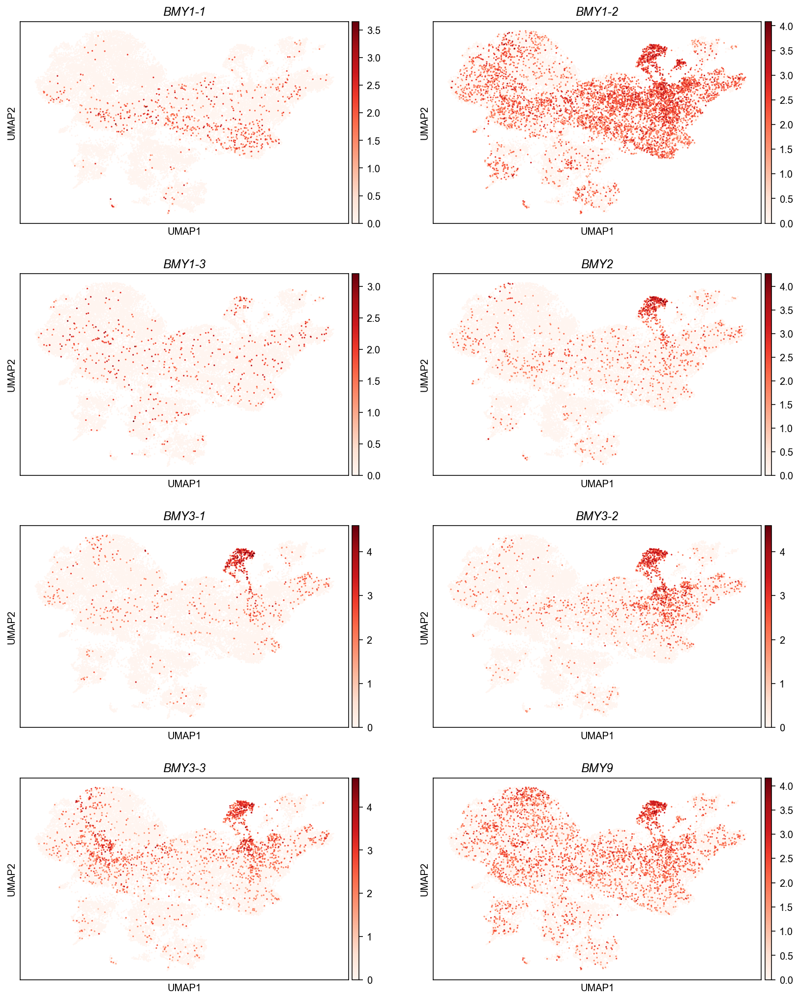

In [536]:
axs = sc.pl.umap(
    ad,
    layer="normalize_log",
    cmap="Reds",
    color=ls_gene,
    title=ls_name,
    ncols=2,
    size=10,
    show=False,
)
for ax in axs:
    plt.sca(ax)
    text = ax.get_title()
    plt.title(text, fontdict={"style": "italic"})

## results

In [950]:
# dt_cluster2Tissue = {
#     "0": "Cortex",
#     "1": "Cortex",
#     "2": "Unknown",
#     "3": "Stele",
#     "4": "Unknown",
#     "5": "Epidermis",
#     "6": "Cortex",
#     "7": "Cortex",
#     "8": "Endodermis",
#     "9":"Stele",
#     "10":"Cortex",
#     "11":"Unknown",
#     "12":"Infected zone",
#     "13":"Unknown",
#     "14":"Unknown",
# }
# dt_cluster2Tissue = {x:f"{x}: {y}" for x,y in dt_cluster2Tissue.items()}
# ad.obs['Cell type'] = ad.obs['Cluster'].map(dt_cluster2Tissue)
dt_cluster2Tissue = {
    "0": "Uninfected cells*",
    "1": "Inner cortex",
    "2": "Outer cortex*",
    "3": "Vascular bundle",
    "4": "Outer cortex*",
    "5": "Epidermis",
    "6": "Unknown",
    "7": "Uninfected cells*",
    "8": "Unknown",
    "9":"Vascular bundle",
    "10":"Unknown",
    "11":"Uninfected cells*",
    "12":"Infected cells",
    "13":"Unknown",
    "14":"Unknown",
}
dt_cluster2Tissue = {x:f"{x}: {y}" for x,y in dt_cluster2Tissue.items()}
ad.obs['Cell type'] = ad.obs['Cluster'].map(dt_cluster2Tissue)

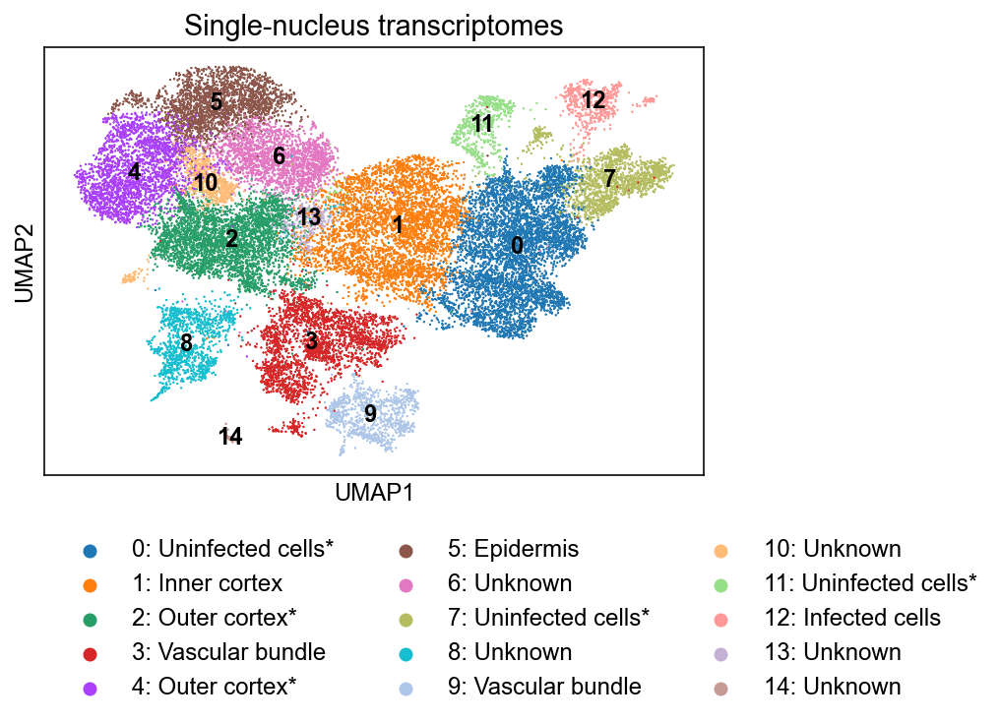

In [989]:
# fig, ax = plt.subplots(figsize=(6, 3))
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
plt.legend(loc="upper left", bbox_to_anchor=(0, -0.1), ncol=3, frameon=False)
plt.title("Single-nucleus transcriptomes")
plt.show()

In [23]:
ad.obs['Sample_two'] = ad.obs['Sample'].map(lambda x:x.split(' ')[-1])

In [24]:
singleCellTools.basic.getadataColor(ad, 'Sample')

{'Large Nodule': '#1f77b4', 'Small Nodule': '#ff7f0e', 'Root': '#2ca02c'}

In [947]:
_ls = (
    [x for x in ad.obs["Cell type"].unique() if ("*" not in x) & ("Unknown" not in x)]
    | F(map, lambda x: x.split(":")[0])
) | F(list)

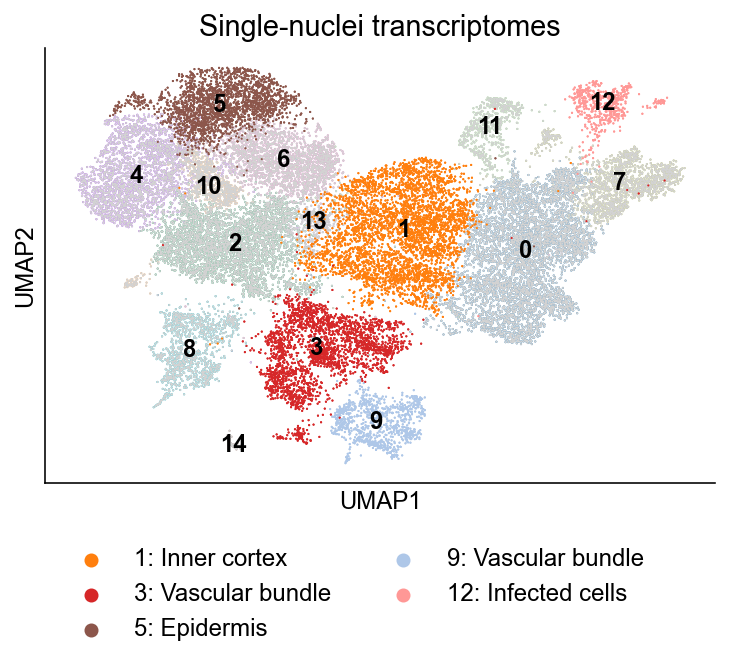

In [952]:
# fig, ax = plt.subplots(figsize=(6, 3))
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", groups=[dt_cluster2Tissue[x] for x in _ls], na_in_legend=False)
sns.despine(top=True, right=True)
plt.legend(loc="upper left", bbox_to_anchor=(0, -0.1), ncol=2, frameon=False)
plt.title("Single-nuclei transcriptomes")
plt.show()

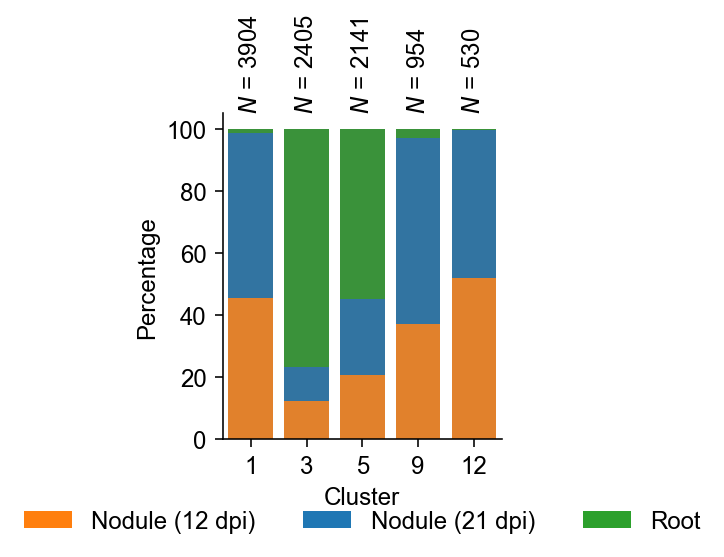

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

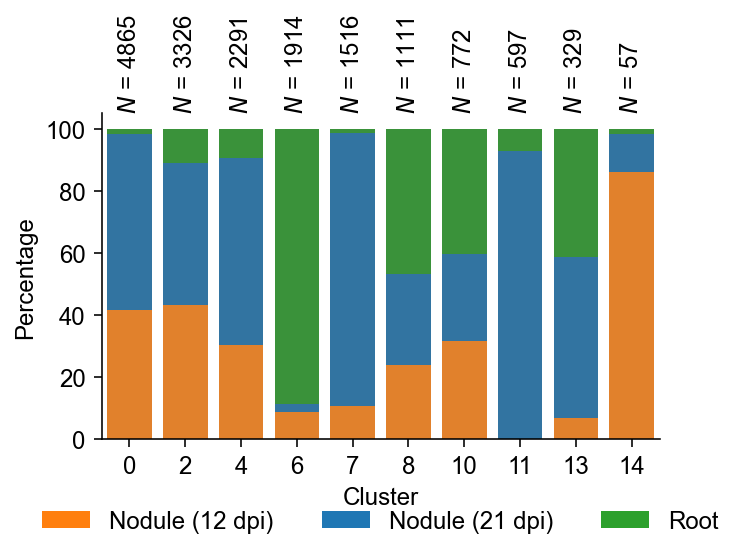

In [954]:
_ls = (
    [x for x in ad.obs["Cell type"].unique() if ("*" not in x) & ("Unknown" not in x)]
    | F(map, lambda x: x.split(":")[0])
) | F(list)
fig,ax=plt.subplots(figsize=(2.5,3))
singleCellTools.plotting.plotLabelPercentageInCluster(
    ad[ad.obs.eval("Cluster in @_ls")],
    "Cluster",
    "Sample_time",
    dt_kwargsForLegend={"ncol": 3, "bbox_to_anchor": [0.5, -0.15], 'loc':'upper center'},
)
plt.show()
fig,ax=plt.subplots(figsize=(5,3))
singleCellTools.plotting.plotLabelPercentageInCluster(
    ad[ad.obs.eval("Cluster not in @_ls")],
    "Cluster",
    "Sample_time",
    dt_kwargsForLegend={"ncol": 3, "bbox_to_anchor": [0.5, -0.15], 'loc':'upper center'},
)

In [413]:
import importlib
importlib.reload(singleCellTools.plotting)

<module 'jpy_tools.singleCellTools.plotting' from '/public/home/liuzj/softwares/anaconda3/lib/python3.8/site-packages/jpy_tools/singleCellTools/plotting.py'>

In [404]:
ad.obs['Sample_time']

AAACCCAAGACGCAGT-1-batch-nodule_large    Nodule (21 dpi)
AAACCCAAGAGGATCC-1-batch-nodule_large    Nodule (21 dpi)
AAACCCACAAATACAG-1-batch-nodule_large    Nodule (21 dpi)
AAACCCACAGCAGTAG-1-batch-nodule_large    Nodule (21 dpi)
AAACCCACAGCTGTAT-1-batch-nodule_large    Nodule (21 dpi)
                                              ...       
TTTGTTGGTGTTACAC-1-batch-root                       Root
TTTGTTGTCAGTCCGG-1-batch-root                       Root
TTTGTTGTCCTCTTTC-1-batch-root                       Root
TTTGTTGTCGGTTGTA-1-batch-root                       Root
TTTGTTGTCTCATTTG-1-batch-root                       Root
Name: Sample_time, Length: 26712, dtype: category
Categories (3, object): ['Nodule (12 dpi)', 'Nodule (21 dpi)', 'Root']

In [405]:
import importlib
importlib.reload(singleCellTools.plotting)

<module 'jpy_tools.singleCellTools.plotting' from '/public/home/liuzj/softwares/anaconda3/lib/python3.8/site-packages/jpy_tools/singleCellTools/plotting.py'>

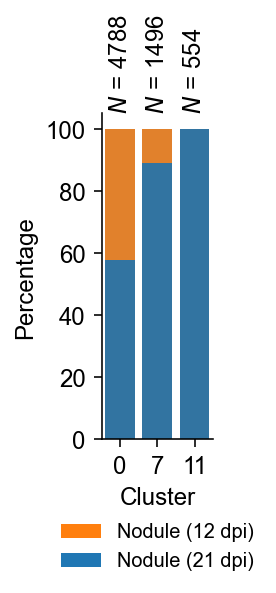

In [416]:
with plt.rc_context({"figure.figsize": (1, 3)}):
    _ls = ["0", "7", "11"]
    singleCellTools.plotting.plotLabelPercentageInCluster(
        ad[ad.obs.eval("Sample in ['Large Nodule', 'Small Nodule'] & Cluster in @_ls")],
        "Cluster",
        "Sample_time",
        labelColor={"Nodule (12 dpi)": "#ff7f0e", "Nodule (21 dpi)": "#1f77b4"},
        dt_kwargsForLegend={
            "bbox_to_anchor": [0.5, -0.2],
            "loc": "upper center",
            "ncol": 1,
            "fontsize": 10,
        },
    )

# identify marker

In [12]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad, 'raw', 'Cell type')

In [63]:
df_marker = ad.uns['Cell type_cellexES'].assign(
    Cluster=lambda df: df["Cell type"].str.split(":").str[0]
)

In [1581]:
df_marker["Cluster"] = df_marker["Cluster"].astype("category").cat.set_categories(
    ["0", "1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12", "13", "14"]
)

In [1596]:
# df_marker.drop(columns=["Cell type"]).query(
#     "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
# ).merge(df_symbol, how="left", left_on="gene", right_index=True).eval(
#     "Symbol = Symbol.fillna('') \n other_designations = other_designations.fillna('')",
#     engine="python",
# ).to_excel(f"{dir_result}/20220607_enrichGene.xlsx")

In [238]:
ad.uns['Cell type_cellexES'].query(
    "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
)

,gene,Cell type,enrichScore,expressed_ratio,expressed_ratio_others
69,GLYMA_01G008000,0: Cortex,0.818345,0.111614,0.028928
83,GLYMA_01G009600,0: Cortex,0.811713,0.526208,0.197464
167,GLYMA_01G019700,0: Cortex,0.802225,0.364645,0.147984
224,GLYMA_01G027200,0: Cortex,0.783761,0.193011,0.064997
237,GLYMA_01G028600,0: Cortex,0.944330,0.110997,0.016844
...,...,...,...,...,...
589547,GLYMA_20G184900,9: Stele,0.800815,0.100629,0.008696
589627,GLYMA_20G195100,9: Stele,0.753702,0.406709,0.072599
589686,GLYMA_20G203100,9: Stele,0.868116,0.585954,0.031447
589713,GLYMA_20G206900,9: Stele,0.884120,0.606918,0.028496


In [239]:
df_marker.drop(columns=["Cell type"]).query("expressed_ratio > 0.2 & expressed_ratio_others < 0.01")

,gene,enrichScore,expressed_ratio,expressed_ratio_others,Cluster
45735,GLYMA_04G079600,0.951995,0.213731,0.005821,10
58903,GLYMA_10G179400,0.952461,0.321244,0.009483,10
61374,GLYMA_11G200300,0.917594,0.310881,0.009715,10
83285,GLYMA_03G113200,0.961702,0.207705,0.004404,11
91803,GLYMA_07G195300,0.971626,0.232831,0.009420,11
...,...,...,...,...,...
586559,GLYMA_19G015800,0.915971,0.250524,0.007338,9
588247,GLYMA_19G258700,0.943305,0.210692,0.004736,9
589098,GLYMA_20G126500,0.930998,0.250524,0.007648,9
589543,GLYMA_20G184300,0.930953,0.292453,0.009589,9


In [250]:
dt_marker = (
    df_marker.query(
        "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
    )
    .groupby("Cluster")["gene"]
    .agg(list)
    .to_dict()
)

dt_spercificGenes = (
    df_marker.query(
        "expressed_ratio > 0.2 &expressed_ratio_others < 0.01"
    )
    .groupby("Cluster")["gene"]
    .agg(list)
    .to_dict()
)

In [246]:
ls_c12EnrichedGenes = dt_marker['12']
ls_c12SpercificGenes= dt_spercificGenes['12']

In [256]:
_ls_cluster = list(dt_marker.keys()) | F(sorted, key=int)
_ls_snfPropotion = [len([y for y in dt_marker[x] if y in ls_knownSnfGenes]) / len(dt_marker[x]) * 100 for x in _ls_cluster]

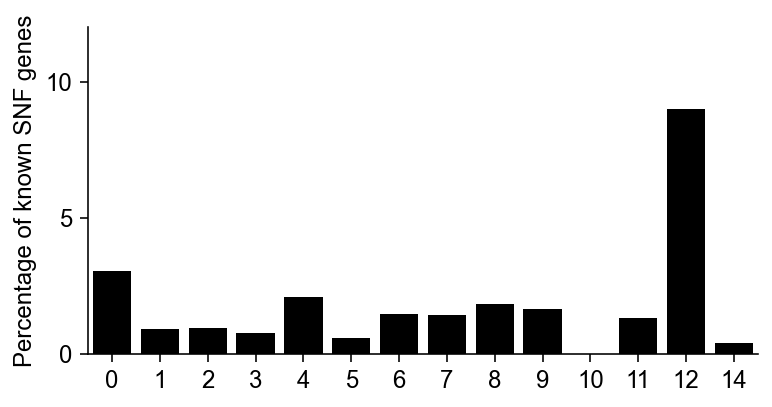

In [260]:
fig, ax = plt.subplots(figsize=(6, 3))

# sns.barplot(y=["1", "2", "3"], x=[100, 100, 100], palette=["#D3D3D3"])
sns.barplot(
    x=_ls_cluster,
    y=_ls_snfPropotion,
    palette=["black"],
)
plt.ylabel("Percentage of known SNF genes")
plt.ylim(0, 12)
ax.yaxis.set_major_locator(ticker.MultipleLocator(5))

plt.xticks(
    rotation=-90, ha='center'
)
sns.despine()
plt.xticks(rotation=0);

In [249]:
len(ls_c12EnrichedGenes), len(ls_c12SpercificGenes), len(
    ls_c12EnrichedGenes | F(filter, lambda x: x in ls_knownSnfGenes) | F(list)
), len(ls_c12SpercificGenes | F(filter, lambda x: x in ls_knownSnfGenes) | F(list))

(311, 33, 28, 2)

In [64]:
dt_marker = (
    df_marker.query("expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .groupby("Cluster")
    .apply(
        lambda df: df.sort_values("enrichScore")
        .nlargest(50, "enrichScore")["gene"]
        .to_list()
    )
).to_dict()
dt_marker

{'10': ['GLYMA_10G179400', 'GLYMA_04G079600', 'GLYMA_11G200300'],
 '11': ['GLYMA_17G128000',
  'GLYMA_13G179200',
  'GLYMA_09G134800',
  'GLYMA_13G361200',
  'GLYMA_07G195300',
  'GLYMA_03G113200'],
 '12': ['GLYMA_07G113300',
  'GLYMA_10G222000',
  'GLYMA_05G069600',
  'GLYMA_13G025200',
  'GLYMA_01G123700',
  'GLYMA_18G173300',
  'GLYMA_05G066300',
  'GLYMA_07G226700',
  'GLYMA_07G093800',
  'GLYMA_16G128000',
  'GLYMA_16G166200',
  'GLYMA_15G261000',
  'GLYMA_18G147700',
  'GLYMA_14G214800',
  'GLYMA_02G221600',
  'GLYMA_09G005600',
  'GLYMA_07G214000',
  'GLYMA_08G063100',
  'GLYMA_02G098200',
  'GLYMA_08G071200',
  'GLYMA_15G048400',
  'GLYMA_13G363800',
  'GLYMA_11G128800',
  'GLYMA_03G246200',
  'GLYMA_11G203400',
  'GLYMA_12G237400',
  'GLYMA_09G274600',
  'GLYMA_07G025800',
  'GLYMA_17G149100',
  'GLYMA_11G066000',
  'GLYMA_15G049000',
  'GLYMA_17G038700',
  'GLYMA_08G306600'],
 '14': ['GLYMA_06G005000',
  'GLYMA_18G200700',
  'GLYMA_13G284700',
  'GLYMA_01G110100',
  'GLYMA_19

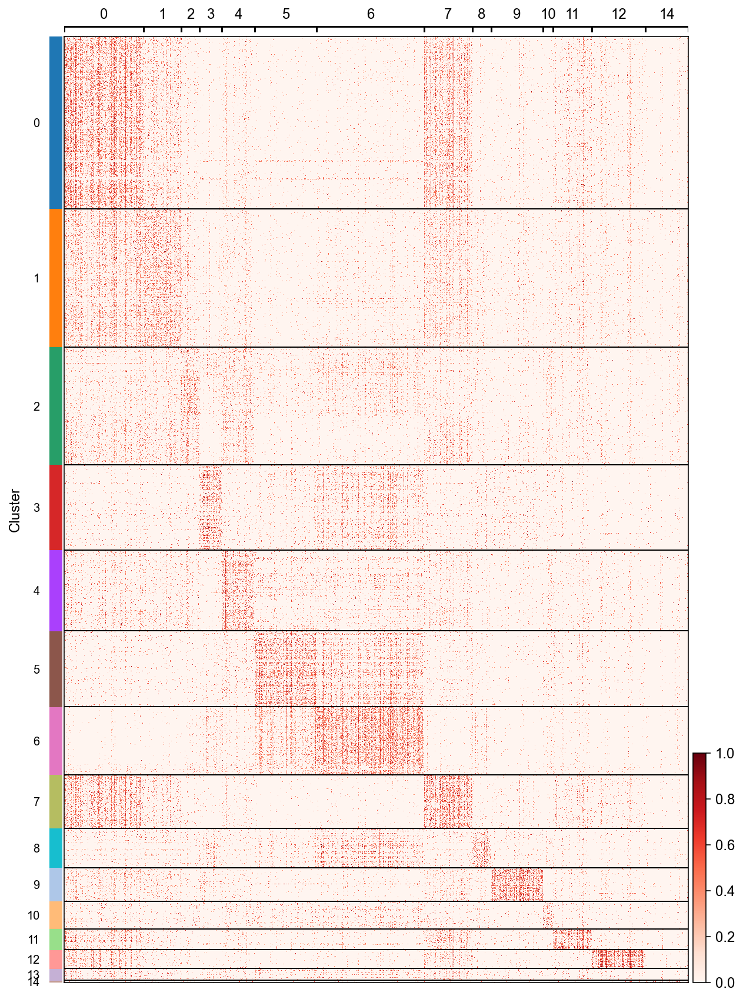

In [758]:
sc.pl.heatmap(
    ad,
    {x: y for x, y in dt_marker.items() if y},
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    figsize=(10, 15), standard_scale='var'
)

In [65]:
{x:len(y) for x,y in dt_marker.items() if y}

{'10': 3, '11': 6, '12': 33, '14': 50, '5': 3, '6': 2, '8': 7, '9': 28}

In [350]:
2 / 33

0.06060606060606061

In [348]:
{x:[z for z in y if z in ls_knownSnfGenes] for x,y in dt_marker.items() if y}

{'5': [],
 '6': [],
 '8': [],
 '9': [],
 '10': [],
 '11': [],
 '12': ['GLYMA_15G048400', 'GLYMA_07G025800'],
 '14': []}

Text(0.5, 1.0, 'Propotion of known SNF genes')

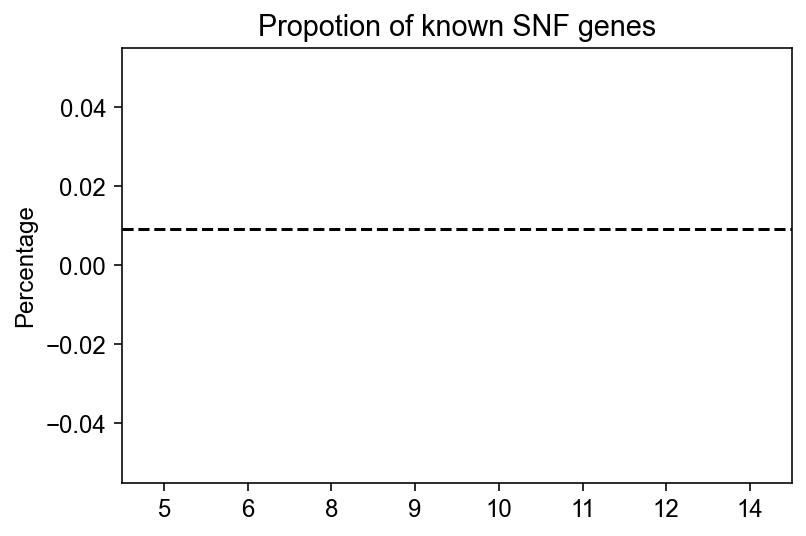

In [331]:
_df = pd.Series({x:len([z for z in y if z in ls_knownSnfGenes]) / len(y) for x,y in dt_marker.items() if y})
sns.barplot(data = _df.reset_index(), x='index', y=0, palette=singleCellTools.basic.getadataColor(ad, 'Cluster'))
plt.ylabel('Percentage')
plt.xlabel('')
plt.axhline(len(ls_knownSnfGenes) / ad.shape[1], ls='--', color='black')
plt.title('Propotion of known SNF genes')

### UC

In [531]:
_ls = ['0', '7', '11']
ad.obs['cluster_mergeUC'] = np.where(ad.obs['leiden'].isin(_ls), 'UC', ad.obs['leiden'])

In [532]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad, 'raw',  'cluster_mergeUC')

In [543]:
df_ucMarker = (
    ad.uns["cluster_mergeUC_cellexES"]
    .query(
        'cluster_mergeUC == "UC" & enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2'
    )
    .sort_values("enrichScore", ascending=False)
    .merge(df_symbol, left_on="gene", right_index=True, how="left")
    .fillna("")
)

In [545]:
df_ucMarker.to_excel(f"{dir_result}/UC_marker.xlsx")

In [ ]:
dt_marker = (
    df_marker.query(
        "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
    )
    .groupby("Cluster")["gene"]
    .agg(list)
    .to_dict()
)

## marker GO

In [254]:
from jpy_tools.otherTools import getGoDesc

In [255]:
df_go = pd.read_table("/data/Zhaijx/liuzj/data/soybase_IPF/soybase_soybean_go_term.tsv")
df_goDesc = getGoDesc(df_go["goTerm"].unique().tolist())
_dt = df_goDesc["hitGO"].to_dict()
df_termGene = (
    df_go[["goTerm", "gene"]]
    .assign(goTerm=lambda df: df["goTerm"].map(_dt))
    .rename(columns={"gene": "Gene stable ID", "goTerm": "GO term accession"})
)
df_termName = df_goDesc.reset_index()[["hitGO", "hitName"]].rename(
    columns={"index": "GO term accession", "hitName": "GO term name"}
)
dt_goToCat = df_go.set_index("goTerm")["cate"].to_dict()

100%|██████████| 5017/5017 [01:05<00:00, 76.52it/s] 
2022-05-31 19:34:29.194 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0007126, target : GO:0051321
2022-05-31 19:34:29.196 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0016568, target : GO:0006325
2022-05-31 19:34:29.199 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0006944, target : GO:0061025
2022-05-31 19:34:29.200 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0007067, target : GO:0000278
2022-05-31 19:34:29.201 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0006342, target : GO:0031507
2022-05-31 19:34:29.203 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0070838, target : GO:0030001
2022-05-31 19:34:29.205 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0009814, target : GO:0098542
2022-05-31 19:34:29.207 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0007050, target : GO:0051726
2022-05-31 19:34:29.210 | WARNING  

2022-05-31 19:34:29.324 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0005086, target : GO:0005085
2022-05-31 19:34:29.325 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0022891, target : GO:0022857
2022-05-31 19:34:29.325 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0015326, target : GO:0015174
2022-05-31 19:34:29.326 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0042282, target : GO:0004420
2022-05-31 19:34:29.327 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0017137, target : GO:0031267
2022-05-31 19:34:29.329 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0004003, target : GO:0003678
2022-05-31 19:34:29.329 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0005083, target : GO:0030695
2022-05-31 19:34:29.330 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:0009540, target : GO:0052662
2022-05-31 19:34:29.331 | WARNING  | jpy_tools.otherTools:getGoDesc:555 - query : GO:003

In [888]:
ad_stAlign.obs['n_counts'].mean(), ad_stAlign.obs['n_genes'].mean()

(695.0360717773438, 224.3304665102945)

In [256]:
cpro = importr('clusterProfiler')
rBase = importr("base")
R = ro.r

dfR_termGene = py2r(df_termGene)
dfR_termName = py2r(df_termName)

on disk mode: True, transfer `<class 'pandas.core.frame.DataFrame'>` to R:  End. Elapsed time: 4
on disk mode: True, transfer `<class 'pandas.core.frame.DataFrame'>` to R:  End. Elapsed time: 2


In [257]:
def enrichmentAnalysisGO(ls_gene, ls_background, qvalueCutoff=0.2, dt_goToCat=None, pvalueCutoff=0.05):
    _go = cpro.enricher(
        R.c(*ls_gene),
        universe=R.c(*ls_background),
        TERM2GENE=dfR_termGene,
        TERM2NAME=dfR_termName,
        qvalueCutoff=qvalueCutoff,
        pvalueCutoff=pvalueCutoff
    )
    df_go = r2py(rBase.as_data_frame(_go))
    df_go["-log10Pvalue"] = np.log10(df_go["pvalue"]) * -1
    if dt_goToCat:
        df_go["Category"] = df_go.index.map(dt_goToCat)
        df_go = df_go.sort_values(["Category", "pvalue"])
    else:
        df_go = df_go.sort_values(["pvalue"])
    return df_go

In [258]:
dt_goColor = {x:y for x,y in zip(['Biological Process ', 'Cellular Component ', 'Molecular Function '], sns.palettes.color_palette())}

In [248]:
def _fcSplitGoTerm(x, cutoff=40):
    from more_itertools import chunked
    ls_x = x.split(' ')
    parsed = ''
    lineChrCounts = 0
    for x in ls_x:
        x = x.strip()
        chrCounts = len(x)
        lineChrCounts += chrCounts
        if lineChrCounts > cutoff:
            parsed = parsed + '\n' + x
            lineChrCounts = 0
        else:
            parsed = parsed + ' ' + x
    return parsed

transfer `data.frame` to python:  End. Elapsed time: 0


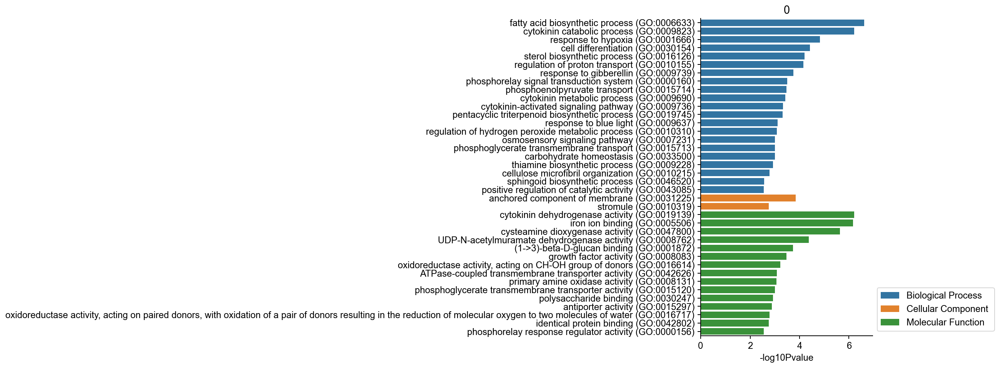

transfer `data.frame` to python:  End. Elapsed time: 0


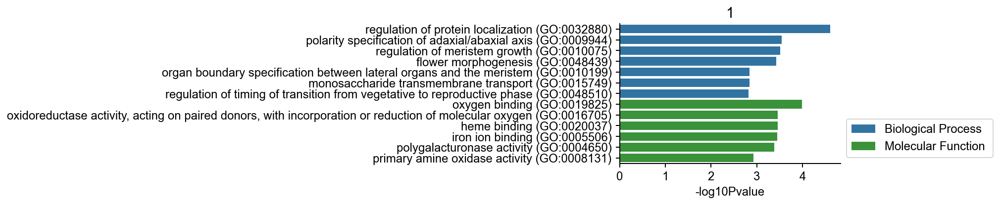

transfer `data.frame` to python:  End. Elapsed time: 0


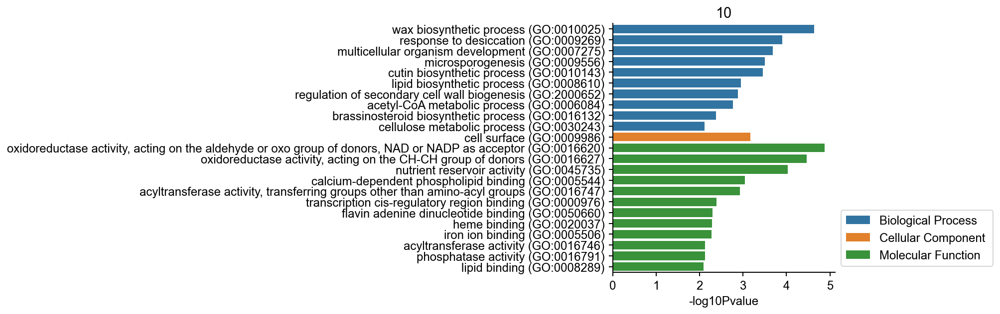

transfer `data.frame` to python:  End. Elapsed time: 0


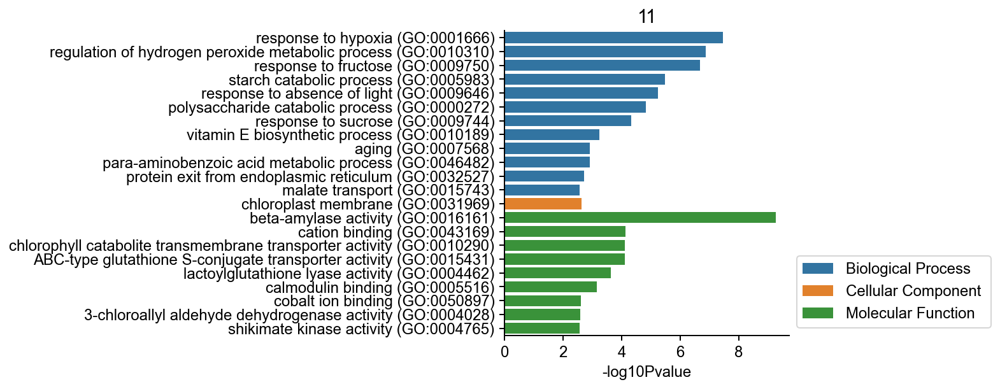

transfer `data.frame` to python:  End. Elapsed time: 0


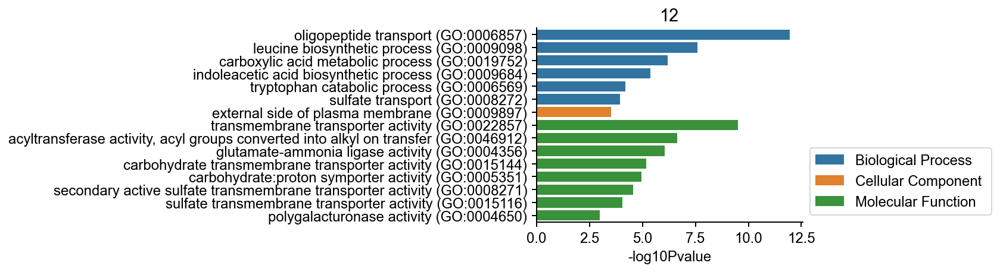

transfer `data.frame` to python:  End. Elapsed time: 0


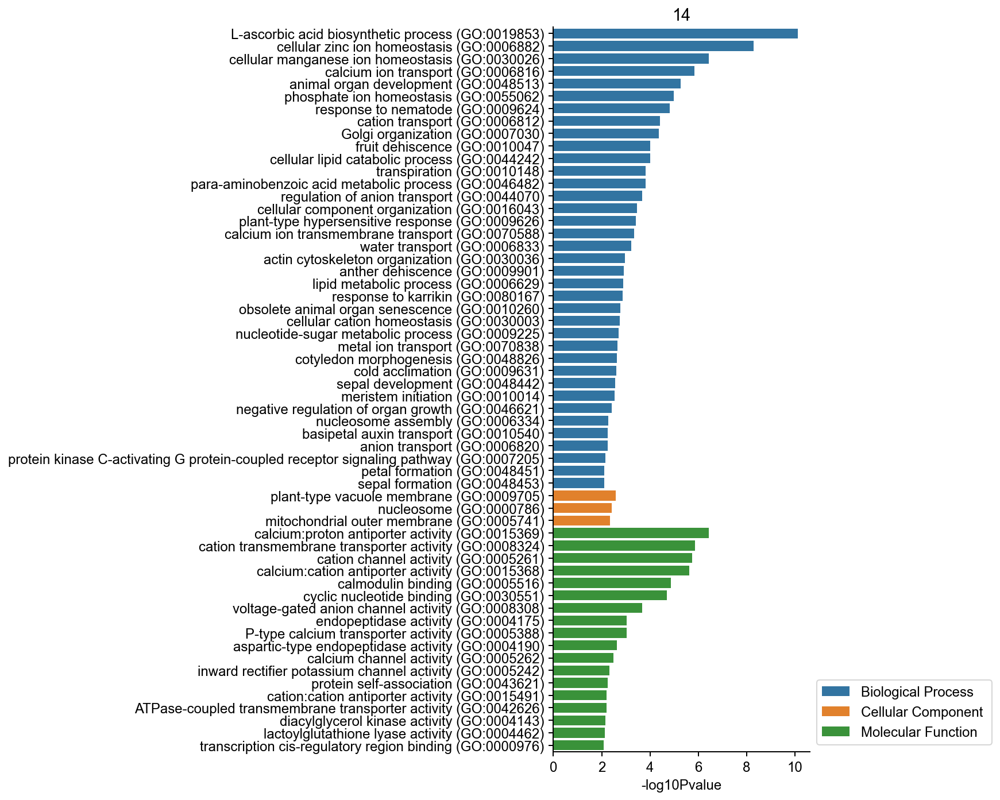

transfer `data.frame` to python:  End. Elapsed time: 0
transfer `data.frame` to python:  End. Elapsed time: 0


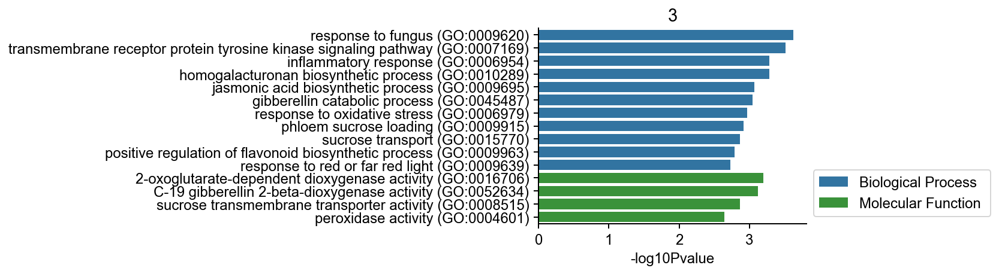

transfer `data.frame` to python:  End. Elapsed time: 0


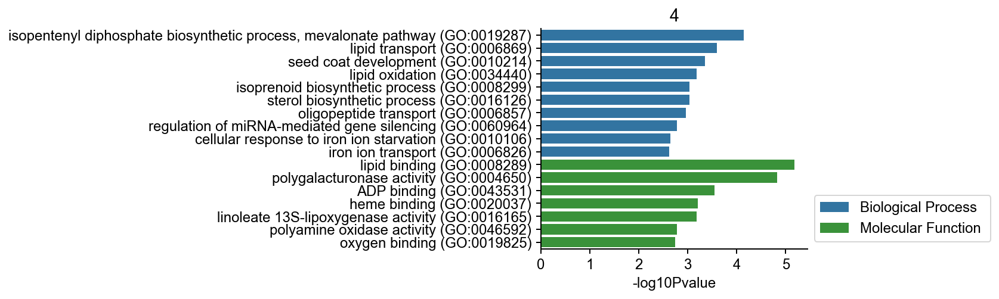

transfer `data.frame` to python:  End. Elapsed time: 0


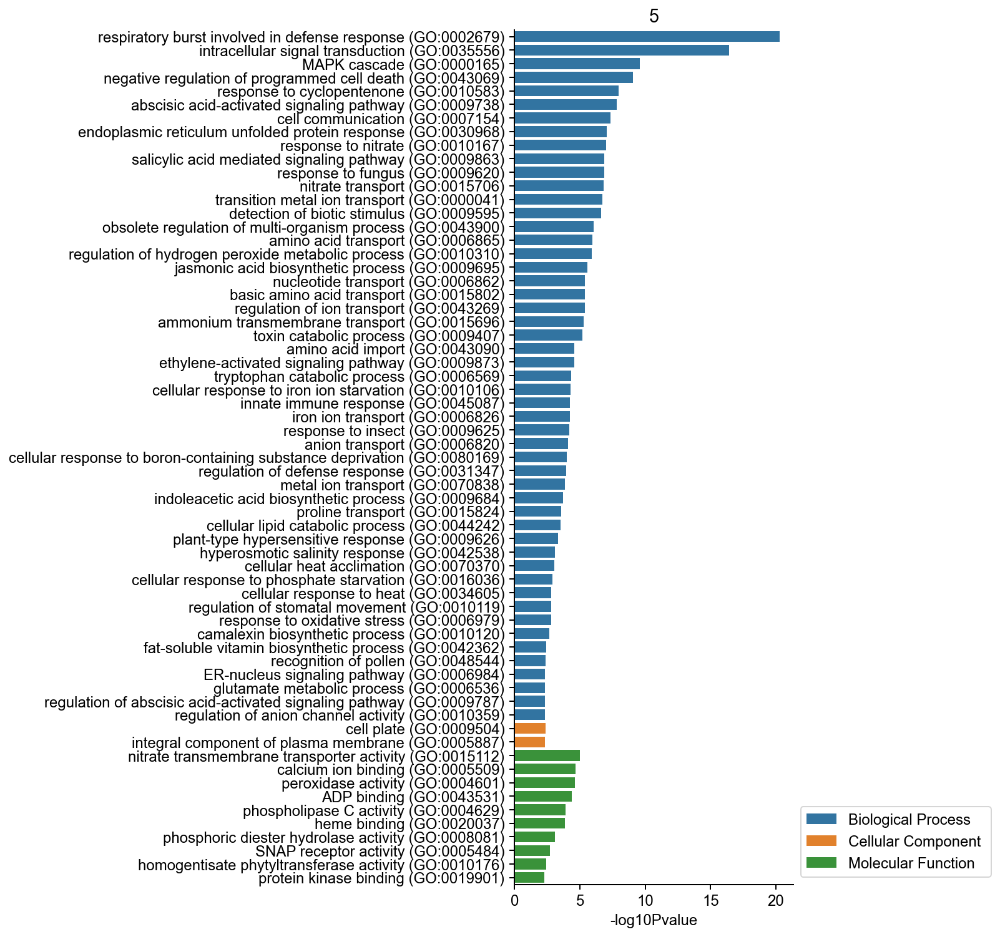

transfer `data.frame` to python:  End. Elapsed time: 0


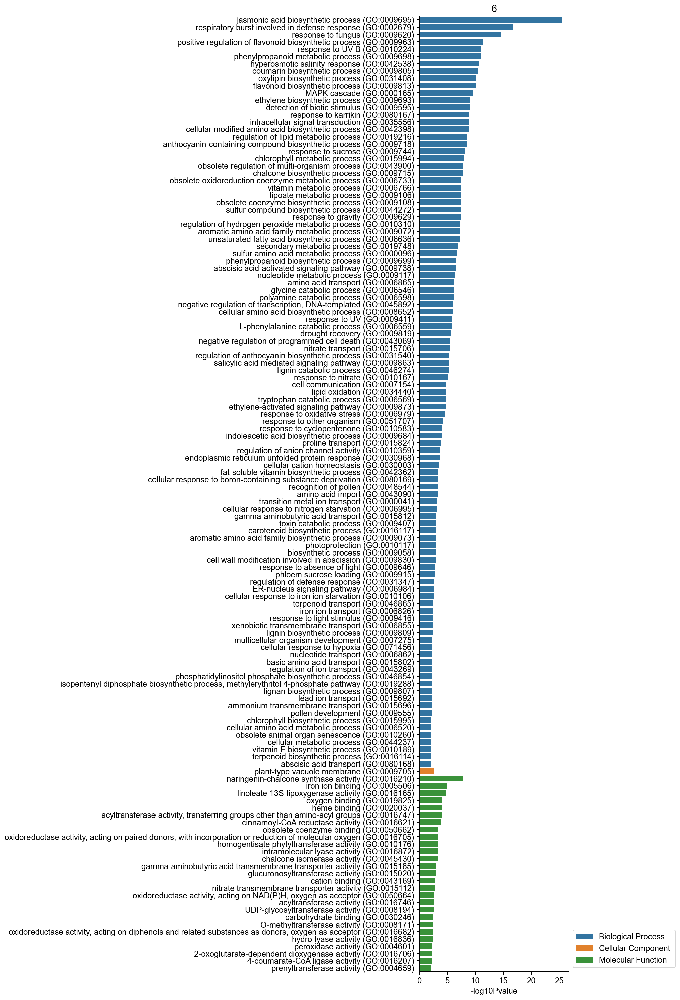

transfer `data.frame` to python:  End. Elapsed time: 0


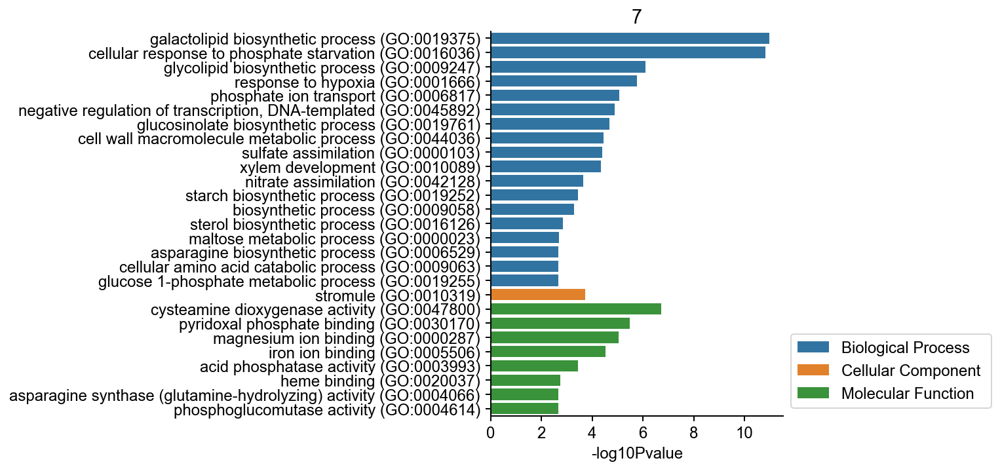

transfer `data.frame` to python:  End. Elapsed time: 0


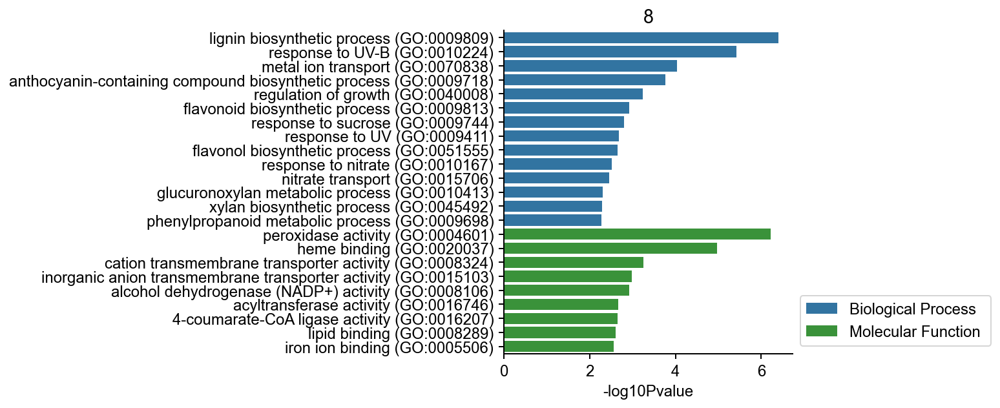

transfer `data.frame` to python:  End. Elapsed time: 0


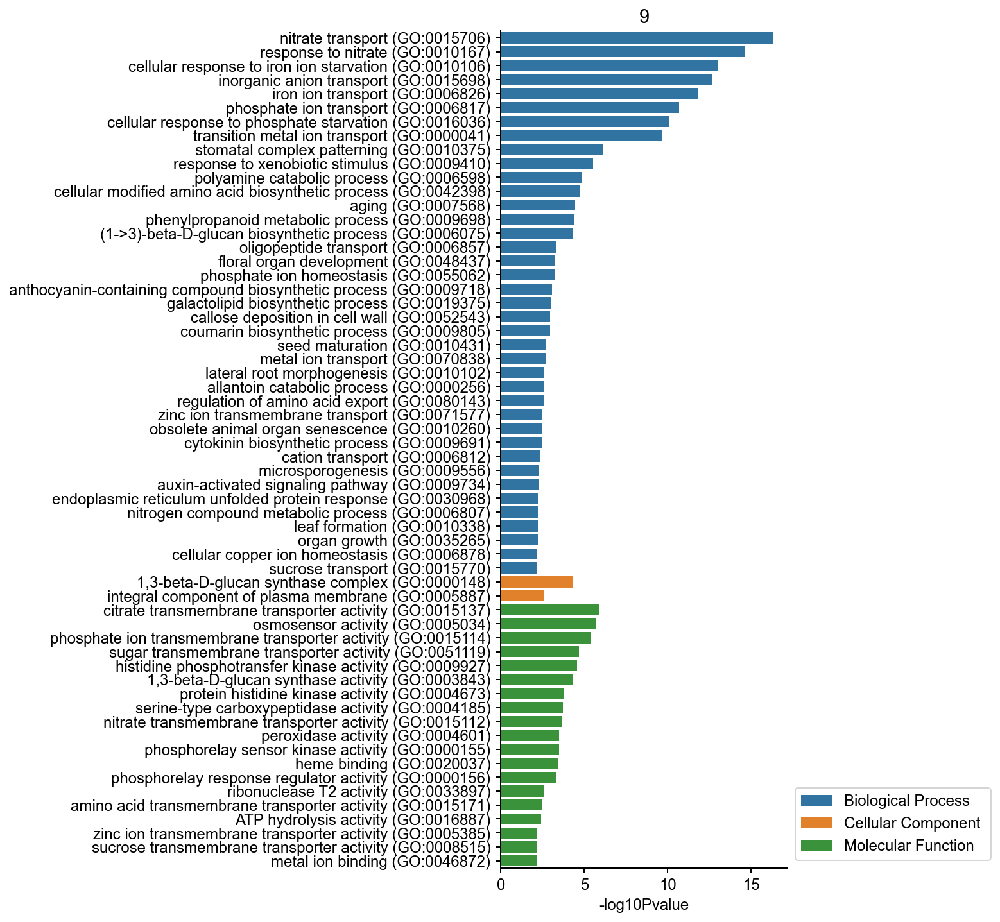

In [256]:
lsDf_go = []
for cluster, ls_gene in dt_marker.items():
    df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
    if df_go.empty:
        continue
    df_go.insert(0, 'Cluster', cluster)
    lsDf_go.append(df_go)

    fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
    sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
    plt.legend(loc='lower left', bbox_to_anchor=[1,0])
    plt.ylabel('')
    sns.despine(top=True, right=True)
    plt.title(cluster)
    plt.show()

transfer `data.frame` to python:  End. Elapsed time: 0


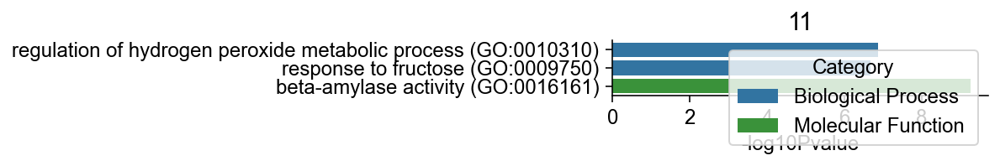

In [776]:
lsDf_go = []
_ls_go = ['GO:0016161', 'GO:0010310', 'GO:0009750']
cluster = '11'
ls_gene = dt_marker[cluster]
df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
df_go.insert(0, 'Cluster', '11')
df_go = df_go.query("ID in @_ls_go")
lsDf_go.append(df_go)

_ls_go = ['GO:0016161', 'GO:0010310', 'GO:0009750']
cluster = '11'
ls_gene = dt_marker[cluster]
df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
df_go.insert(0, 'Cluster', '11')
df_go = df_go.query("ID in @_ls_go")
lsDf_go.append(df_go)

In [777]:
fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
# plt.legend(loc='lower left', bbox_to_anchor=[1,0])
ax.
plt.ylabel('')
sns.despine(top=True, right=True)
plt.title('11')
plt.show() 

,Cluster,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count,-log10Pvalue,Category
GO:0010310,11,GO:0010310,regulation of hydrogen peroxide metabolic proc...,14/218,388/35944,1.296308e-07,1.732731e-05,1.514633e-05,GLYMA_02G086100/GLYMA_06G061900/GLYMA_07G19530...,14,6.887292,Biological Process
GO:0009750,11,GO:0009750,response to fructose (GO:0009750),12/218,285/35944,2.033955e-07,2.039040e-05,1.782387e-05,GLYMA_01G161500/GLYMA_02G145300/GLYMA_06G05010...,12,6.691659,Biological Process
GO:0016161,11,GO:0016161,beta-amylase activity (GO:0016161),6/218,17/35944,5.437488e-10,2.180433e-07,1.905983e-07,GLYMA_01G203400/GLYMA_05G068000/GLYMA_11G03940...,6,9.264602,Molecular Function


In [843]:
_ls = df_go.loc['GO:0010310', 'geneID'].split('/')
df_symbol.query("index in @_ls")

,Symbol,other_designations
geneID,,
GLYMA_16G141500,BZIP117,bZIP transcription factor bZIP117
GLYMA_06G061900,WRKY17,WRKY transcription factor 17
GLYMA_11G121800,LOC102661758,nonsymbiotic hemoglobin|non-symbiotic hemoglob...
GLYMA_12G150500,LOC100814871,stem-specific protein TSJT1
GLYMA_02G086100,LOC100811587,RNA-dependent RNA polymerase 1
GLYMA_09G073600,LOC100806761,sucrose synthase
GLYMA_18G273200,LOC100787893,protein DOWNY MILDEW RESISTANCE 6
GLYMA_13G181000,LOC100786699,stem-specific protein TSJT1
GLYMA_13G242100,LOC100816141,stem-specific protein TSJT1


In [839]:
len(_ls)

14

### IC UC GO

transfer `data.frame` to python:  End. Elapsed time: 0


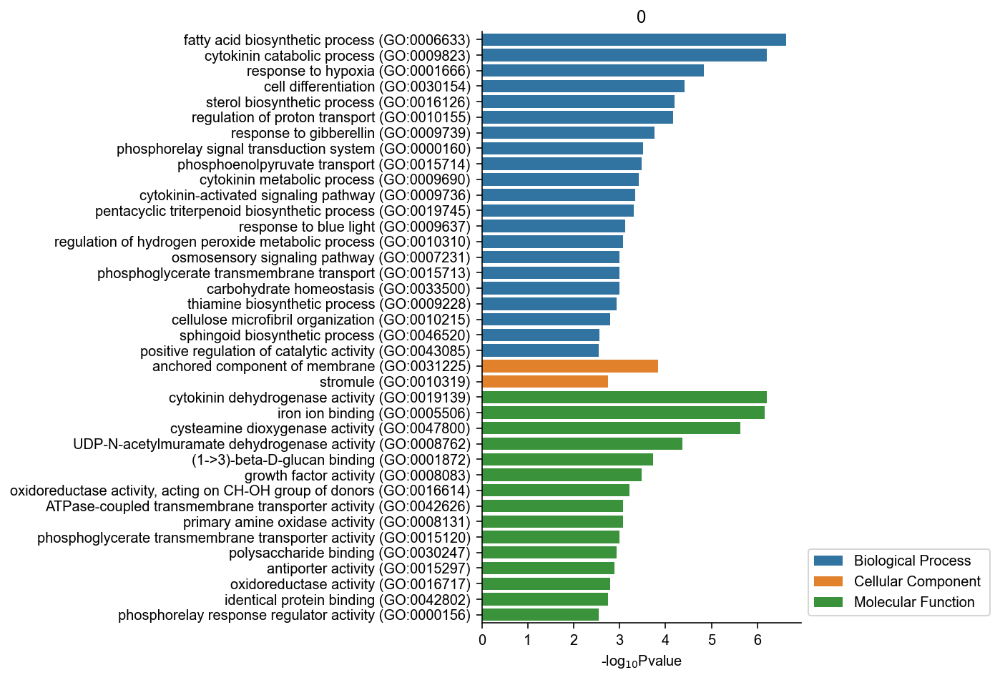

In [505]:
lsDf_go = []
for cluster in ['0']:
    ls_gene = dt_marker[cluster]
    df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat)
    if df_go.empty:
        continue
    df_go.insert(0, 'Cluster', cluster)
    df_go.loc['GO:0016717', 'Description'] = 'oxidoreductase activity (GO:0016717)'
    lsDf_go.append(df_go)
    
    fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
    sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
    plt.legend(loc='lower left', bbox_to_anchor=[1,0])
    plt.xlabel("-log$_{10}$Pvalue")
    plt.ylabel('')
    sns.despine(top=True, right=True)
    plt.title(cluster)
    plt.show() 

transfer `data.frame` to python:  End. Elapsed time: 0


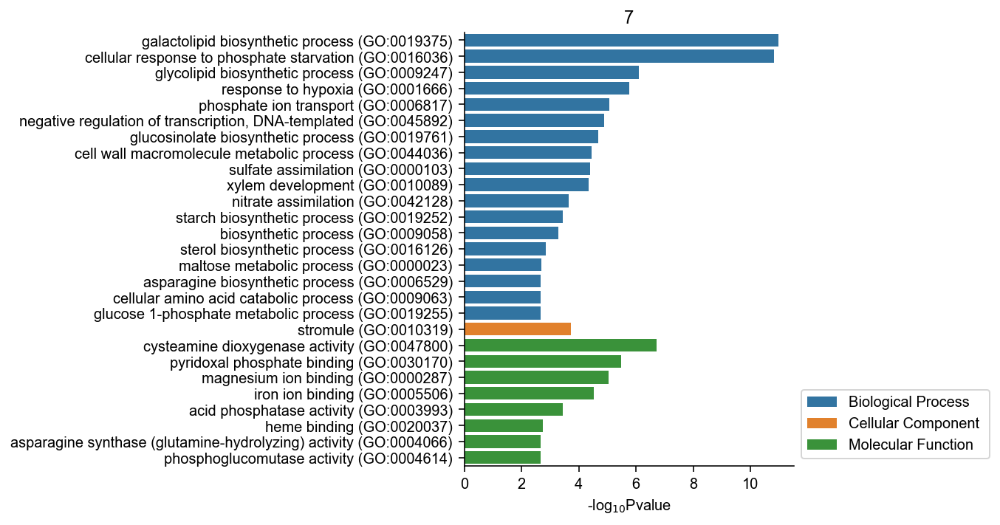

transfer `data.frame` to python:  End. Elapsed time: 0


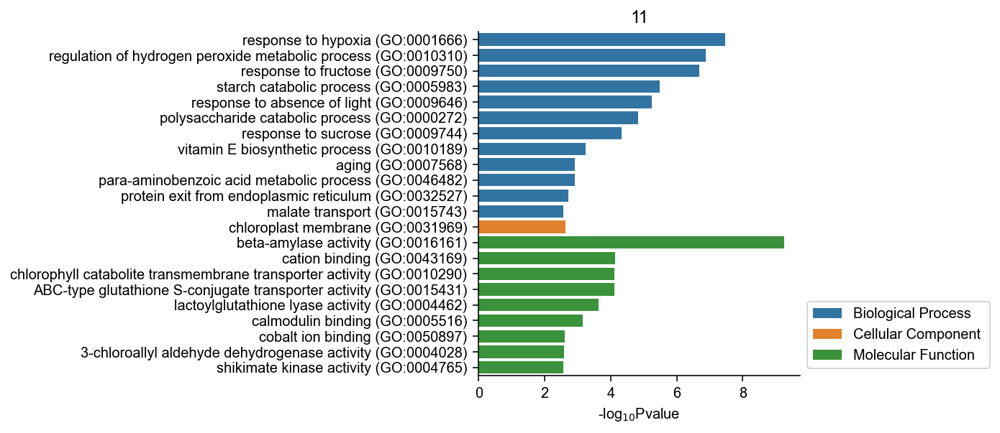

transfer `data.frame` to python:  End. Elapsed time: 0


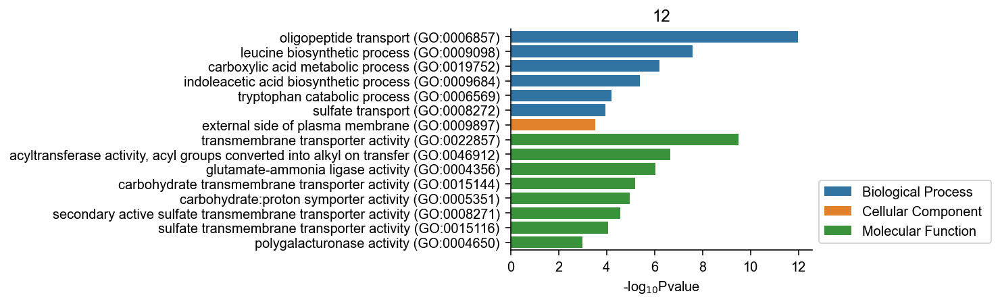

In [504]:
lsDf_go = []
for cluster in ["7", "11", "12"]:
    ls_gene = dt_marker[cluster]
    df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat=dt_goToCat)
    if df_go.empty:
        continue
    df_go.insert(0, "Cluster", cluster)
    lsDf_go.append(df_go)

    fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
    sns.barplot(
        data=df_go,
        x="-log10Pvalue",
        y="Description",
        hue="Category",
        ax=ax,
        dodge=False,
        palette=dt_goColor,
    )
    plt.legend(loc="lower left", bbox_to_anchor=[1, 0])
    plt.xlabel("-log$_{10}$Pvalue")

    plt.ylabel("")
    sns.despine(top=True, right=True)
    plt.title(cluster)
    plt.show()

transfer `data.frame` to python:  End. Elapsed time: 0


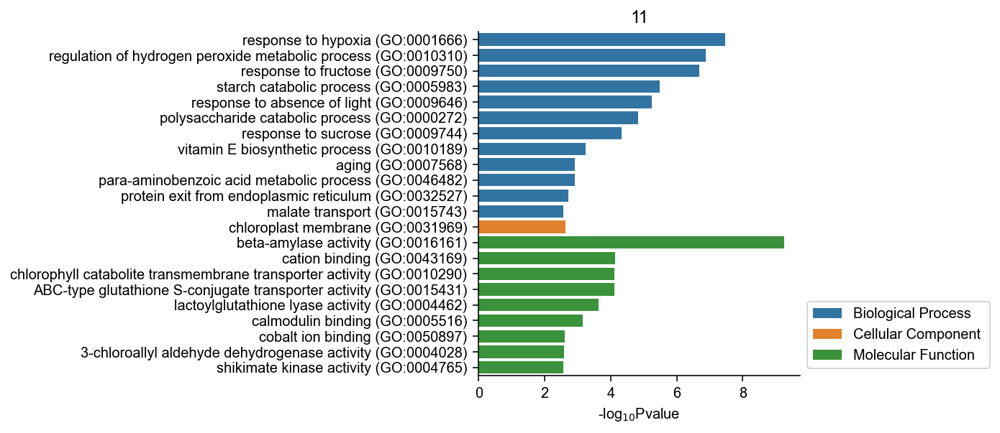

In [503]:
lsDf_go = []
for cluster in ['11']:
    ls_gene = dt_marker[cluster]
    df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat)
    if df_go.empty:
        continue
    df_go.insert(0, 'Cluster', cluster)
    lsDf_go.append(df_go)
    
    fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
    sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
    plt.legend(loc='lower left', bbox_to_anchor=[1,0])
    plt.xlabel("-log$_{10}$Pvalue")
    plt.ylabel('')
    sns.despine(top=True, right=True)
    plt.title(cluster)
    plt.show() 

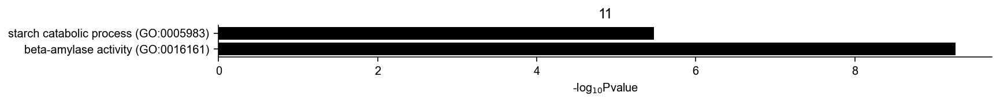

In [502]:
fig, ax = plt.subplots(figsize=(12, 0.5))
sns.barplot(
    data=df_go.query("ID in ['GO:0005983', 'GO:0016161']"),
    x="-log10Pvalue",
    y="Description",
    #     hue="Category",
    ax=ax,
    dodge=False,
    color="black"
    #     palette=dt_goColor,
)
# plt.legend(loc="lower left", bbox_to_anchor=[1, 0])
plt.xlabel("-log$_{10}$Pvalue")
plt.ylabel("")
sns.despine(top=True, right=True)
plt.title(cluster)
plt.show()

# insitu gene

In [494]:
_ls_genes = ['GLYMA_11G057600', 'GLYMA_15G124900', 'GLYMA_10G044800', 'GLYMA_19G194300', 'GLYMA_19G084200']

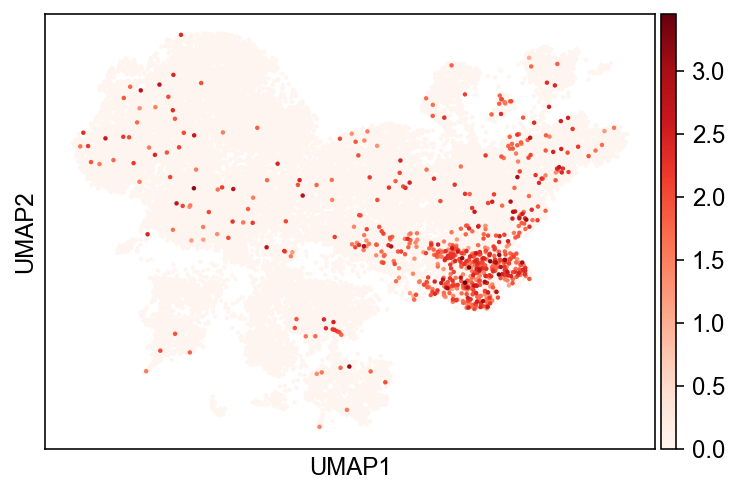

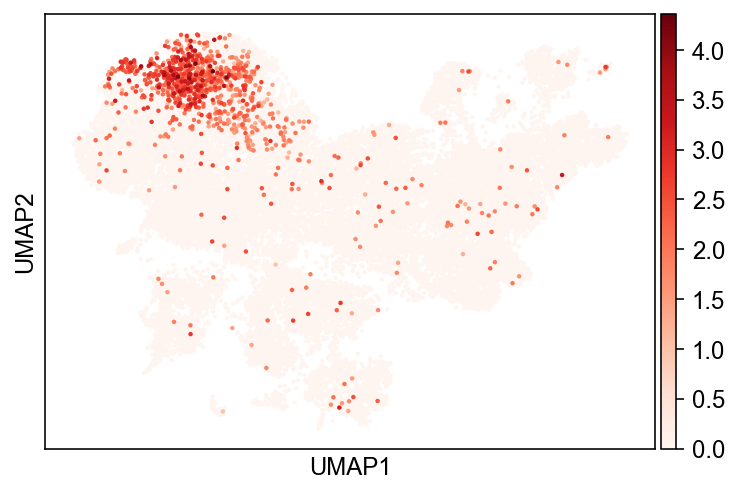

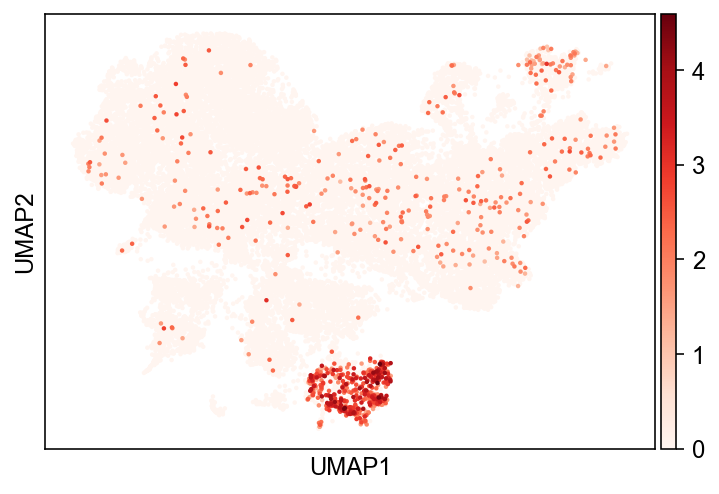

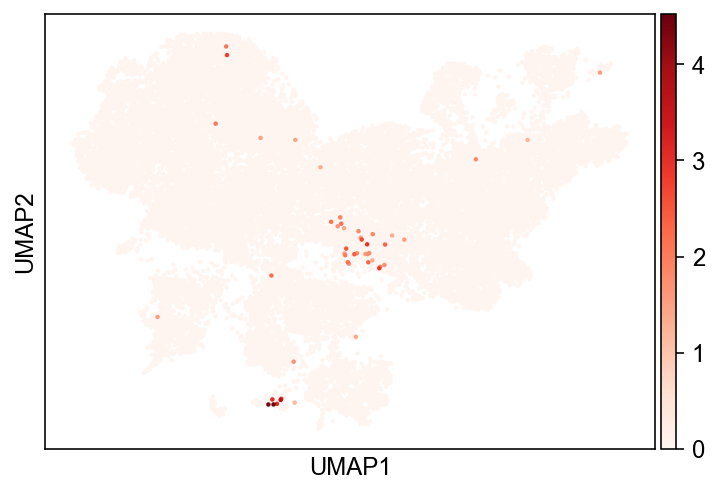

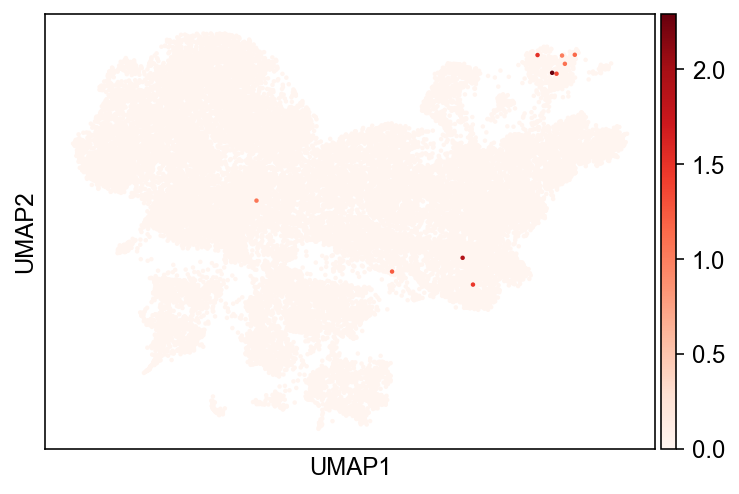

In [495]:
for gene in _ls_genes:
    sc.pl.umap(ad, color=gene, title='', cmap='Reds', layer='normalize_log', ncols=3, size=20)

# response gene

## compare root with nodule

### endodermis

In [121]:
ad_endo = ad[ad.obs.eval(f"Cluster == '8'")]

In [122]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad_endo, "raw", "Sample_two")
ls_endoMarker = dt_marker['8']

In [133]:
dt_endoResponseGene = (
    ad_endo.uns["Sample_two_cellexES"]
    .query(
        "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2 & gene in @ls_endoMarker"
    )
    .groupby("Sample_two")["gene"]
    .agg(list)
    .to_dict()
)

In [134]:
df_endoResponseGene = (
    ad_endo.uns["Sample_two_cellexES"]
    .query(
        "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2 & gene in @ls_endoMarker"
    )
)

### stele

In [139]:
ad.obs["Cluster_stele"] = np.where(
    ad.obs.eval(f"Cluster in ['3', '9']"), "Stele", "Others"
)

In [141]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(
    ad, "raw", "Cluster_stele"
)

In [147]:
ls_steleMarker = (
    ad.uns['Cluster_stele_cellexES'].query(
        "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
    )
    .groupby("Cluster_stele")["gene"]
    .agg(list)
    .to_dict()
)['Stele']

In [ ]:
ad_stele = ad[ad.obs.eval(f"Cluster in ['3', '9']")]

In [117]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad_stele, "raw", "Sample_two")

In [148]:
dt_steleResponseGene = (
    ad_stele.uns["Sample_two_cellexES"]
    .query(
        "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2 & gene in @ls_steleMarker"
    )
    .groupby("Sample_two")["gene"]
    .agg(list)
    .to_dict()
)

In [151]:
df_steleResponseGene = (
    ad_stele.uns["Sample_two_cellexES"]
    .query(
        "enrichScore > 0.6 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2 & gene in @ls_steleMarker"
    )
)

In [152]:
df_steleResponseGene.merge(df_symbol, left_on="gene", right_index=True)

,gene,Sample_two,enrichScore,expressed_ratio,expressed_ratio_others,Symbol,other_designations
54092,GLYMA_08G132100,Root,0.826487,0.177350,0.00269,LOC100776631,uncharacterized protein LOC100776631
57181,GLYMA_09G217200,Root,0.847350,0.189637,0.00269,LOC100786600,probable LRR receptor-like serine/threonine-pr...
61909,GLYMA_12G012000,Root,0.844710,0.181090,0.00269,LOC100775839,probable inactive purple acid phosphatase 27
68421,GLYMA_15G087300,Root,0.971444,0.252671,0.00000,NIP1-4,nodulin-26|nodulin-26-like


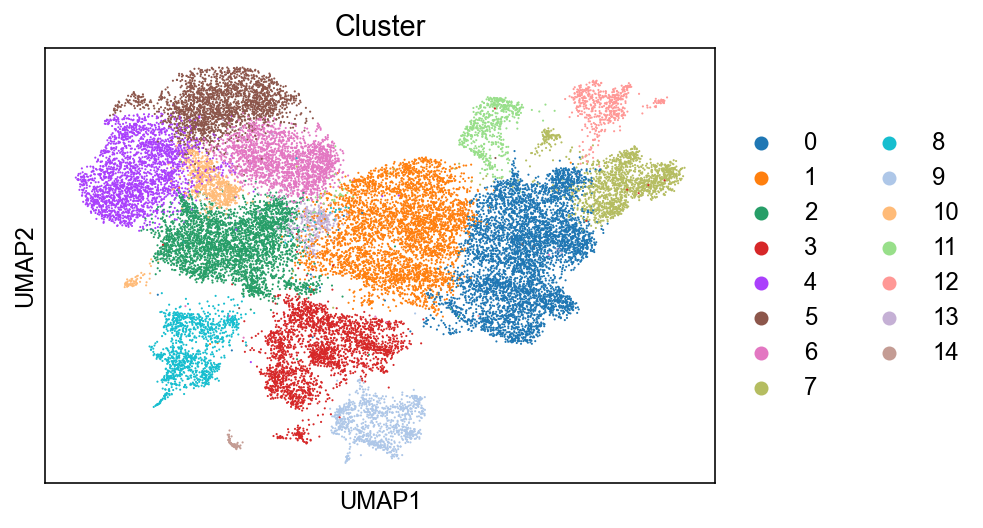

In [73]:
sc.pl.umap(ad, color='Cluster')

## compare diff within nodule

In [157]:
lsDf = []
for cluster, ad_cluster in singleCellTools.basic.splitAdata(ad, 'Cluster', needName=True):
    singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad_cluster, 'raw', 'Sample')
    lsDf.append(ad_cluster.uns['Sample_cellexES'].query("enrichScore > 0.1").assign(Cluster = cluster).copy())

100%|██████████| 15/15 [07:06<00:00, 28.46s/it]


In [158]:
df_responseGene = pd.concat(lsDf).query(
    "enrichScore > 0.6 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
)

In [159]:
df_responseGene.value_counts(['Sample'])

Sample      
Root            2213
Large Nodule    1306
Small Nodule     991
dtype: int64

In [160]:
df_responseGene.value_counts(['Sample'])

Sample      
Root            2213
Large Nodule    1306
Small Nodule     991
dtype: int64

In [161]:
df_responseGene = df_responseGene.query("Sample != 'Root'")

ValueError: min() arg is an empty sequence

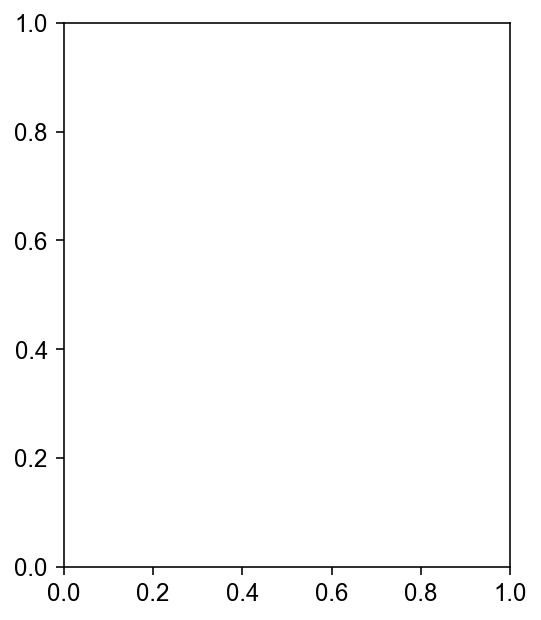

In [162]:
_df = (
    df_responseGene.query("Cluster in ['0', '1', '12']")
    .value_counts(["Cluster", "Sample"])
    .sort_index()
    .rename("Gene counts")
    .to_frame()
    .reset_index()
)
_df = _df.assign(SampleN=lambda df: df["Sample"].map(dt_renameSample))
fig, ax = plt.subplots(figsize=(4, 5))
sns.barplot(data=_df, x="Cluster", y="Gene counts", hue="SampleN")
plt.legend(loc="lower left", bbox_to_anchor=[0.6, 0.8], frameon=False)
sns.despine(top=True, right=True)

# cytotrace

In [804]:
import scvelo as scv

In [805]:
_ls = ["0", "7", "11"]
ad_ciz = ad[ad.obs.eval("Sample in ['Large Nodule', 'Small Nodule'] & Cluster in @_ls")]

In [806]:
ad_ciz.X = ad_ciz.layers['raw'].copy()

In [807]:
sc.pp.filter_genes(ad_ciz, min_cells=10)

Trying to set attribute `.var` of view, copying.


In [808]:
sc.pp.highly_variable_genes(ad_ciz, flavor='seurat_v3', n_top_genes=1000)

scv.pp.normalize_per_cell(ad_ciz)
sc.pp.log1p(ad_ciz)

ad_ciz.layers["spliced"] = ad_ciz.X
ad_ciz.layers["unspliced"] = ad_ciz.X

scv.pp.moments(ad_ciz, n_pcs=30, n_neighbors=30)

Normalized count data: X.
computing neighbors
    finished (0:00:08) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:23) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [809]:
from cellrank.tl.kernels import CytoTRACEKernel

ctk = CytoTRACEKernel(ad_ciz)

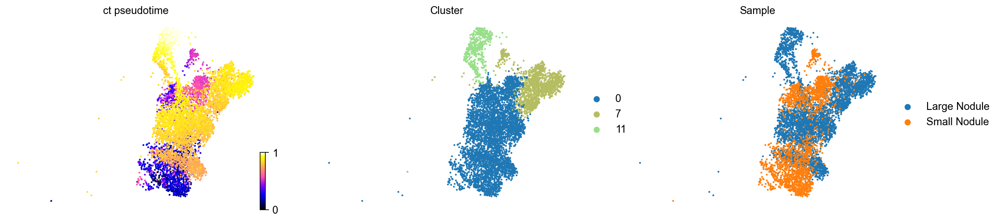

In [810]:
scv.pl.scatter(
    ad_ciz,
    c=["ct_pseudotime", "Cluster", 'Sample'],
    basis="umap",
    legend_loc="right",
    color_map="gnuplot2",
)

In [811]:
ctk.compute_transition_matrix(threshold_scheme="soft", nu=0.5)
ctk.compute_projection(basis="umap")

  0%|          | 0/6838 [00:00<?, ?cell/s]

In [812]:
_dt = singleCellTools.basic.getadataColor(ad, "Cluster")
ad_ciz = singleCellTools.basic.setadataColor(ad_ciz, "Cluster", _dt)

In [816]:
for text in ax.texts:
    text.set_color('white')

In [817]:
text.set_color('white')

Text(7.2830324, 5.711526, '0')

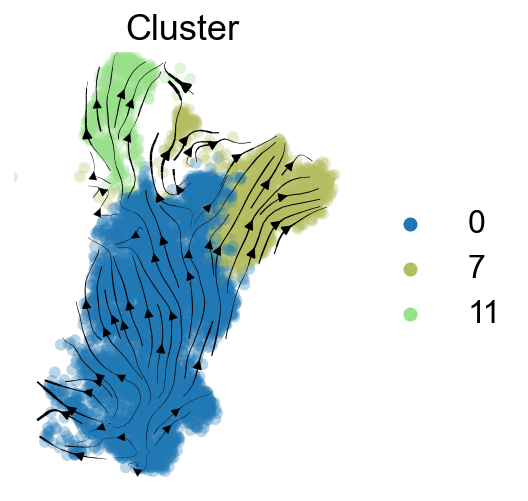

In [821]:
with plt.rc_context({"figure.figsize": (3, 4)}):
    ax = scv.pl.velocity_embedding_stream(
        ad_ciz,
        color="Cluster",
        vkey="T_fwd",
        basis="umap",
        legend_loc="right",
        smooth=0.5,
        min_mass=3,
        title="Cluster",
        legend_fontsize=16,
        show=False,
        fontsize=18
    )
    plt.sca(ax)
    plt.xlim(3, 13)
#     for text in ax.texts:
#         text.set_color('black')
    plt.show()

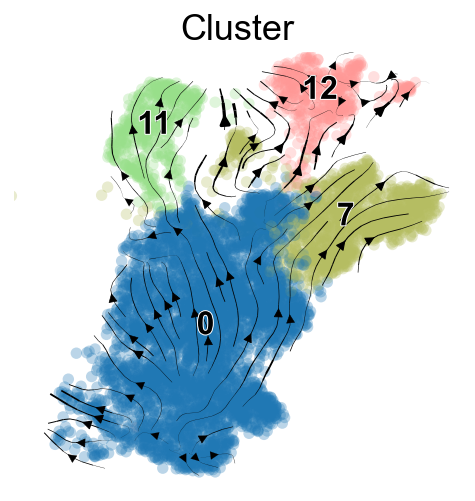

In [91]:
with plt.rc_context({"figure.figsize": (4, 4)}):
    ax = scv.pl.velocity_embedding_stream(
        ad_ciz,
        color="Cluster",
        vkey="T_fwd",
        basis="umap",
        legend_loc="on data",
        smooth=0.5,
        min_mass=3,
        title="Cluster",
        legend_fontsize=16,
        show=False,
        fontsize=18
    )
    plt.sca(ax)
    plt.xlim(3, 13)
    plt.show()

# known SNF Genes

In [21]:
sc.pp.highly_variable_genes(ad, layer='raw', n_top_genes = ad.shape[1], flavor='seurat_v3')

In [22]:
len(ls_knownSnfGenes)

356

In [23]:
ad.var["SNF"] = np.where(ad.var.index.isin(ls_knownSnfGenes), "Known SNF genes", "Unknown")

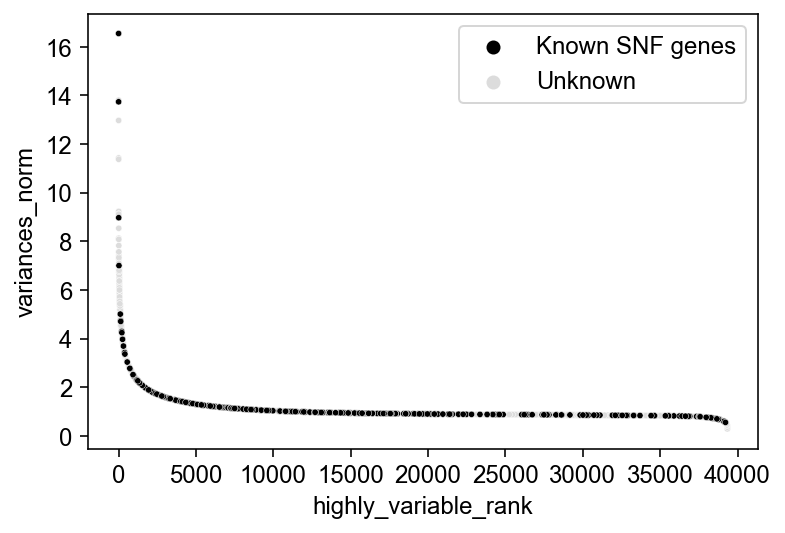

In [24]:
sns.scatterplot(
    data=ad.var.sort_values('SNF', ascending=False),
    x="highly_variable_rank",
    y="variances_norm",
    s=10,
    hue="SNF",
    palette=["#000000", "#DCDCDC"],
    hue_order=["Known SNF genes", "Unknown"],
)
plt.legend(title='')
plt.show()

In [32]:
ls_knownSnfHvg = (
    ad.var.query("highly_variable_rank < 10000")
    .sort_values("highly_variable_rank")
    .index.to_list()
    | F(filter, lambda x: x in ls_knownSnfGenes)
    | F(list)
)

In [34]:
len(ls_knownSnfHvg)

147

# zoom in IC

... storing 'SNF' as categorical


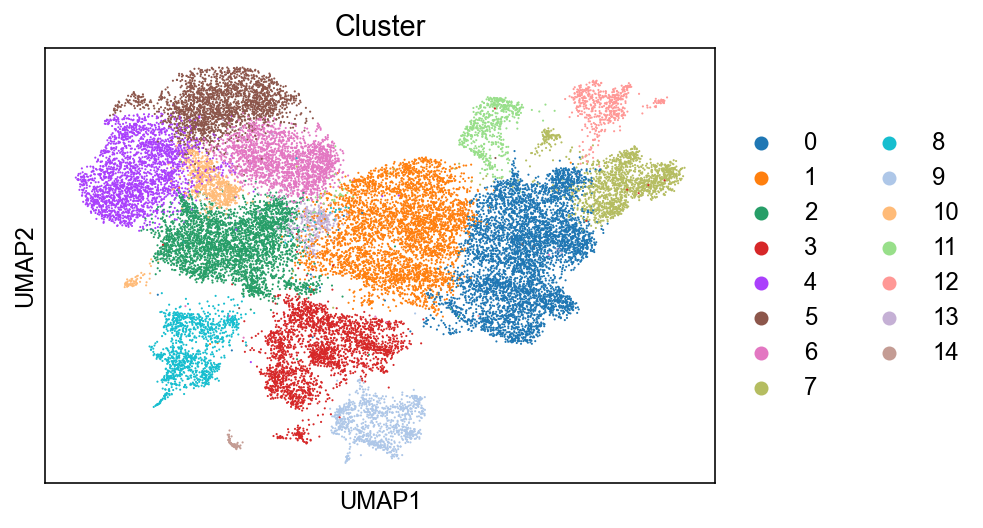

In [36]:
sc.pl.umap(ad, color='Cluster')

In [59]:
sc.tl.leiden(ad, resolution=0.1, restrict_to=('Cluster', ['12']))

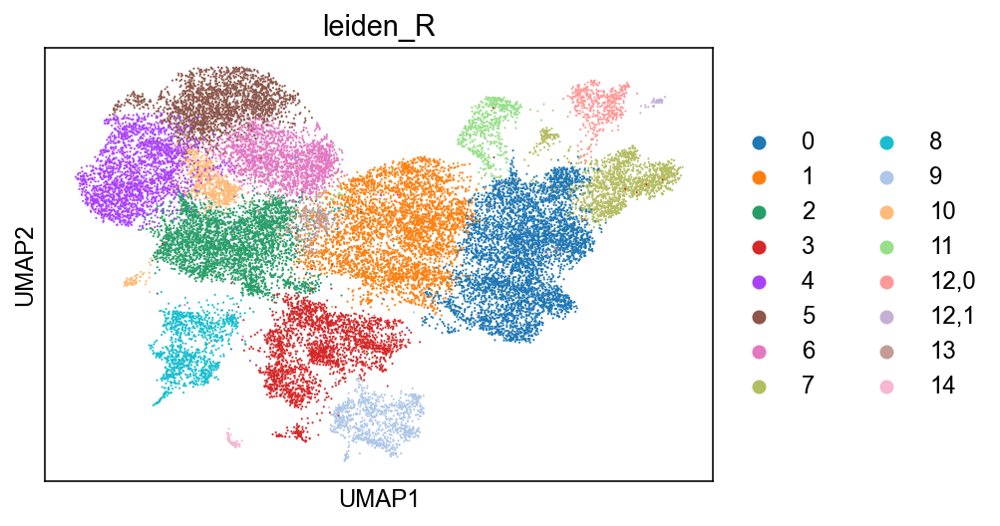

In [246]:
ax = sc.pl.umap(ad, color='leiden_R', show=False)

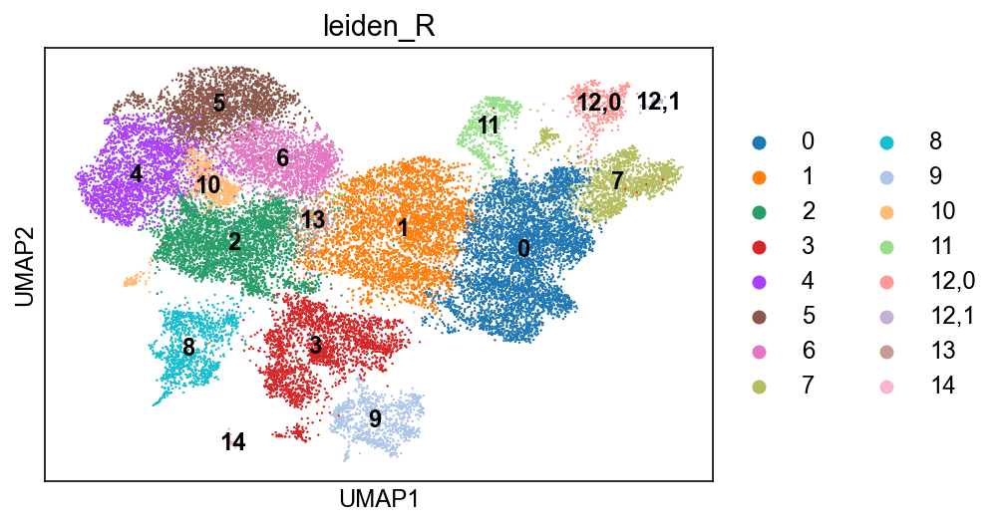

In [245]:
ax = sc.pl.umap(ad, color='leiden_R', show=False, legend_loc='on data')
sc.pl.umap(ad, color='leiden_R', ax=ax)

Trying to set attribute `._uns` of view, copying.


Text(0, 0.5, '')

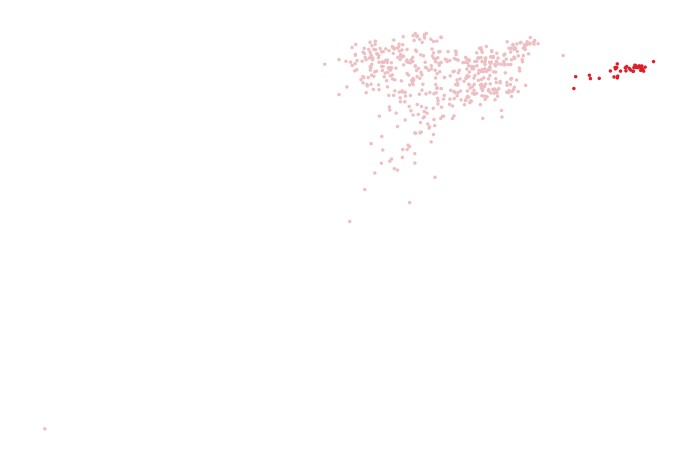

In [822]:
sc.pl.umap(
    ad[ad.obs.eval("Cluster in ['12']")],
    color="leiden_R", show=False, palette=['#EEBFC2', '#DE1E2A'], legend_loc=None,size=12
)
sns.despine(left=True, bottom=True)
plt.title('')
plt.xlabel('')
plt.ylabel('')

## ALL detected SM

In [2153]:
ls_allDetectedSmGenes = (
    pd.read_excel(
        "/data/Zhaijx/liuzj/projects/singleCell/soybean/01_data/yangweicai/1-s2.0-S1673852722001242-mmc1.xlsx"
    )
    .dropna(subset=["Protein ID"])
    .eval(
        "geneID = `Protein ID`.str.replace('Glyma.', 'GLYMA_').str.split('.').str[0]",
        engine="python",
    )
    .query("geneID in @ad.var.index")["geneID"]
    .to_list()
)

on disk mode: False, transfer `<class 'scipy.sparse.csc.csc_matrix'>` to R:  End. Elapsed time: 33


(Non-detected genes are shuffled at the end of the ranking. Keep it in mind when choosing the threshold for calculating the AUC).



 min   1%   5%  10%  50% 100% 
 460  559  677  757 1226 3880 


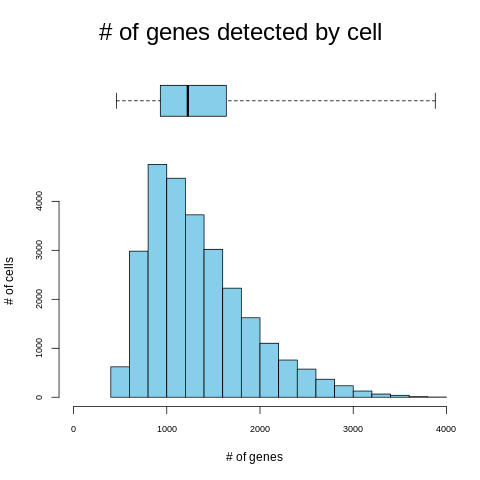

transfer `data.frame` to python:  End. Elapsed time: 4
transfer `data.frame` to python:  End. Elapsed time: 0


In [2154]:
singleCellTools.geneEnrichInfo.getAUCellScore(
    ad,
    {"sm": ls_allDetectedSmGenes},
    layer="raw",
    aucMaxRank=1000,
    label="smDetected_auc",
)

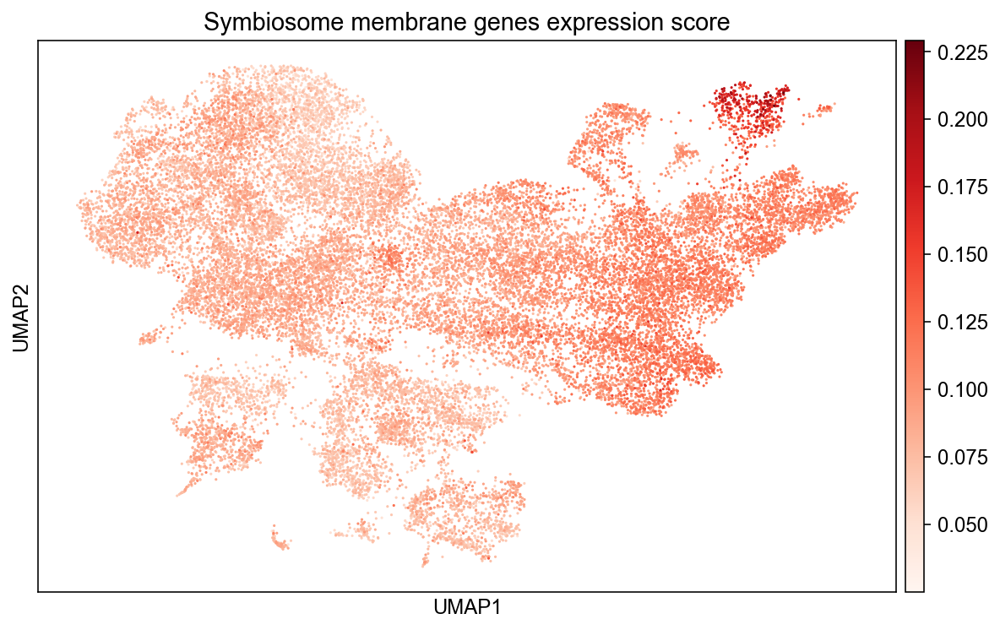

In [73]:
with plt.rc_context({"figure.figsize": (10, 6)}):
    _ad = singleCellTools.plotting.obsmToObs(ad, "smDetected_auc")
    sc.pl.umap(
        _ad,
        color=_ad.uns["plot_obsm"],
        title=["Symbiosome membrane genes expression score"],
        cmap="Reds",
        size=10,
    )

In [74]:
ls_palette = ["#EEBFC2", "#DE1E2A", "#126FB0", "#B5BE62", "#A0E192"]

Text(0.5, 0, '')

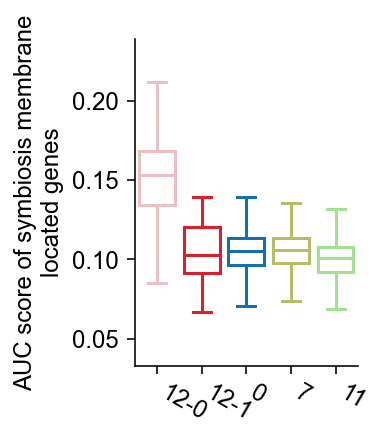

In [75]:
fig, ax = plt.subplots(figsize=(2, 3))

sns.boxplot(
    data=_ad.obs.query("Cluster in ['0', '7', '11', '12']").eval(
        "leiden_R = leiden_R.cat.set_categories(['12-0', '12-1', '0', '7', '11'])",
        engine="python",
    ),
    x="leiden_R",
    y="sm", fliersize=0
)
plt.xticks(rotation=-30, ha="left")
plt.ylabel("AUC score of symbiosis membrane\nlocated genes")

for i, (box, color) in enumerate(zip(ax.artists, ls_palette)):
    box.set_edgecolor(color)
    box.set_facecolor("white")
    # iterate over whiskers and median lines
    for j in range(6 * i, 6 * (i + 1)):
        ax.lines[j].set_color(color)
sns.despine()
plt.xlabel('')

In [80]:
dt_smAuc = (
    _ad.obs.query("Cluster in ['0', '7', '11', '12']")
    .groupby("leiden_R")["sm"]
    .agg(list)
    .dropna()
    .to_dict()
)

In [85]:
from scipy.stats import median_test
from itertools import product

In [89]:
for x, y in product(dt_smAuc.keys(), dt_smAuc.keys()):
    p = median_test(dt_smAuc[x], dt_smAuc[y])[1]
#     if p < 0.05:
    print(x, y, median_test(dt_smAuc[x], dt_smAuc[y])[1])

0 0 1.0
0 7 0.2034484396014494
0 11 9.373972846965979e-14
0 12-0 8.224499692628447e-103
0 12-1 0.6260464254831073
7 0 0.2034484396014494
7 7 1.0
7 11 5.5428443678344805e-15
7 12-0 3.683277465427867e-122
7 12-1 0.6222062973914226
11 0 9.373972846965979e-14
11 7 5.5428443678344805e-15
11 11 1.0
11 12-0 1.0057250379484212e-150
11 12-1 0.8592595902966044
12-0 0 8.224499692628681e-103
12-0 7 3.683277465427867e-122
12-0 11 1.0057250379484212e-150
12-0 12-0 1.0
12-0 12-1 4.674072547402916e-10
12-1 0 0.6260464254831073
12-1 7 0.6222062973914226
12-1 11 0.8592595902966044
12-1 12-0 4.674072547402916e-10
12-1 12-1 1.0


In [84]:
median_test(dt_smAuc['0'], dt_smAuc['12-1'])

(0.23746035776330274,
 0.6260464254831073,
 0.10513313313313313,
 array([[2434,   17],
        [2431,   21]]))

In [2159]:
# ad.write_h5ad(f"{dir_result}/ad_brief_com_version_1.h5ad")
f"{dir_result}/ad_brief_com_version_1.h5ad"

'/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/analysis/noduleWithRoot//ad_brief_com_version_1.h5ad'

## marker

In [61]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad, 'raw', 'leiden_R')

In [1236]:
ad.obs['leiden_R'].str.replace(',', '-')

AAACCCAAGACGCAGT-1-batch-nodule_large       2
AAACCCAAGAGGATCC-1-batch-nodule_large    12-0
AAACCCACAAATACAG-1-batch-nodule_large       9
AAACCCACAGCAGTAG-1-batch-nodule_large       4
AAACCCACAGCTGTAT-1-batch-nodule_large       2
                                         ... 
TTTGTTGGTGTTACAC-1-batch-root               5
TTTGTTGTCAGTCCGG-1-batch-root               4
TTTGTTGTCCTCTTTC-1-batch-root               3
TTTGTTGTCGGTTGTA-1-batch-root               3
TTTGTTGTCTCATTTG-1-batch-root               6
Name: leiden_R, Length: 26712, dtype: object

In [1917]:
_dt = {'Developping Nodule': "Developing Nodule"}
ad.obs['Sample_new'] = ad.obs['Sample_new'].map(lambda x:_dt.get(x,x))

In [1922]:
ad.obs['Sample_new']

AAACCCAAGACGCAGT-1-batch-nodule_large    Mature Nodule
AAACCCAAGAGGATCC-1-batch-nodule_large    Mature Nodule
AAACCCACAAATACAG-1-batch-nodule_large    Mature Nodule
AAACCCACAGCAGTAG-1-batch-nodule_large    Mature Nodule
AAACCCACAGCTGTAT-1-batch-nodule_large    Mature Nodule
                                             ...      
TTTGTTGGTGTTACAC-1-batch-root                     Root
TTTGTTGTCAGTCCGG-1-batch-root                     Root
TTTGTTGTCCTCTTTC-1-batch-root                     Root
TTTGTTGTCGGTTGTA-1-batch-root                     Root
TTTGTTGTCTCATTTG-1-batch-root                     Root
Name: Sample_new, Length: 26712, dtype: category
Categories (3, object): ['Mature Nodule', 'Developing Nodule', 'Root']

In [468]:
import importlib

importlib.reload(singleCellTools.plotting)

<module 'jpy_tools.singleCellTools.plotting' from '/public/home/liuzj/softwares/anaconda3/lib/python3.8/site-packages/jpy_tools/singleCellTools/plotting.py'>

Text(0.5, 0, 'Sub-cluster')

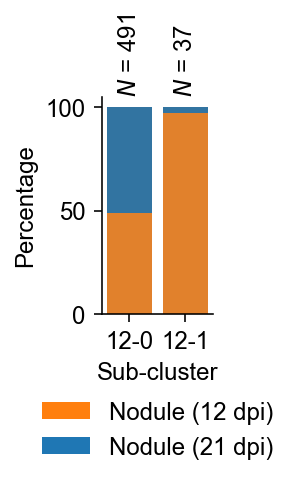

In [469]:
fig, ax = plt.subplots(figsize=(1, 2))
singleCellTools.plotting.plotLabelPercentageInCluster(
    ad[ad.obs.eval("Cluster in ['12'] & Sample != 'Root'")],
    "leiden_R",
    "Sample_time",
    ax=ax,
    dt_kwargsForLegend=dict(loc="upper center", bbox_to_anchor=(0.5, -0.3), ncol=1)
)
plt.xlabel("Sub-cluster")

Text(0, 0.5, 'Sub-cluster')

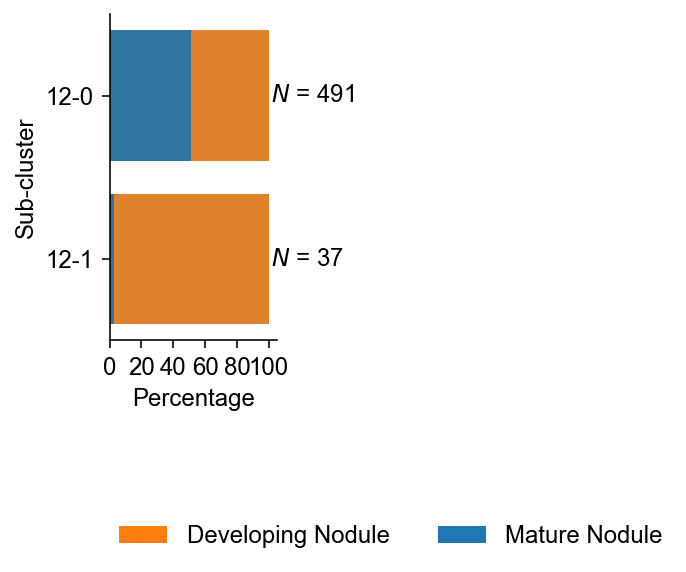

In [1928]:
fig, ax = plt.subplots(figsize=(1.5, 3))
singleCellTools.plotting.plotLabelPercentageInCluster(
    ad[ad.obs.eval("Cluster in ['12'] & Sample != 'Root'")],
    "leiden_R",
    "Sample_new",
    ax=ax,
    dt_kwargsForLegend=dict(loc="upper left", bbox_to_anchor=(-0.07, -0.5), ncol=1),
)
ax.yaxis.set_major_locator(ticker.MultipleLocator(20))
plt.xlabel("Sub-cluster")

In [497]:
ad.uns['Cell type_cellexES'].query(
    "`Cell type` == '12: Infected zone' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01 & gene in @ls_knownSnfGenes"
)

,gene,Cell type,enrichScore,expressed_ratio,expressed_ratio_others
129980,GLYMA_07G025800,12: Infected zone,0.888796,0.203774,0.006646
146796,GLYMA_15G048400,12: Infected zone,0.905229,0.237736,0.005653


In [2081]:
ad.uns['Cell type_cellexES'].query(
    "`Cell type` == '12: Infected zone' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01"
)

,gene,Cell type,enrichScore,expressed_ratio,expressed_ratio_others
118809,GLYMA_01G123700,12: Infected zone,0.964885,0.243396,0.003552
120476,GLYMA_02G098200,12: Infected zone,0.907039,0.360377,0.008746
121302,GLYMA_02G221600,12: Infected zone,0.938343,0.335849,0.008555
123635,GLYMA_03G246200,12: Infected zone,0.896840,0.262264,0.006149
126136,GLYMA_05G066300,12: Infected zone,0.961458,0.252830,0.003743
126162,GLYMA_05G069600,12: Infected zone,0.966596,0.262264,0.003361
129980,GLYMA_07G025800,12: Infected zone,0.888796,0.203774,0.006646
130508,GLYMA_07G093800,12: Infected zone,0.957377,0.320755,0.005538
130632,GLYMA_07G113300,12: Infected zone,0.992429,0.213208,0.001451
131273,GLYMA_07G214000,12: Infected zone,0.913544,0.394340,0.008365


In [104]:
ls_c12_1ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,1' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")
    .query("gene in @ls_knownSnfGenes")["gene"]
    .to_list()
)

In [420]:
ad.uns["leiden_R_cellexES"].query(
    "leiden_R == '12,0' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01"
).sort_values('enrichScore').nlargest(50, 'enrichScore').query("gene in @ls_knownSnfGenes")

,gene,leiden_R,enrichScore,expressed_ratio,expressed_ratio_others
186133,GLYMA_15G048400,"12,0",0.837082,0.227642,0.006178


In [2024]:
ls_c12_1ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,1' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")
    .query("gene in @ls_knownSnfGenes")["gene"]
    .to_list()
)

In [499]:
(
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,0' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01 & gene in @ls_knownSnfGenes")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")["gene"]
    .to_list()
)

['GLYMA_15G048400']

In [2025]:
ls_c12_1ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,1' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")["gene"]
    .to_list()
)

In [2042]:
ad.uns["leiden_R_cellexES"].query(
    "leiden_R == '12,1' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01"
).nlargest(50, "enrichScore").assign(
    SNF=lambda df: np.where(df["gene"].isin(ls_knownSnfGenes), "True", "")
).reset_index(drop=True).to_excel(f"{dir_result}/12_1_marker.xlsx")

transfer `data.frame` to python:  End. Elapsed time: 0


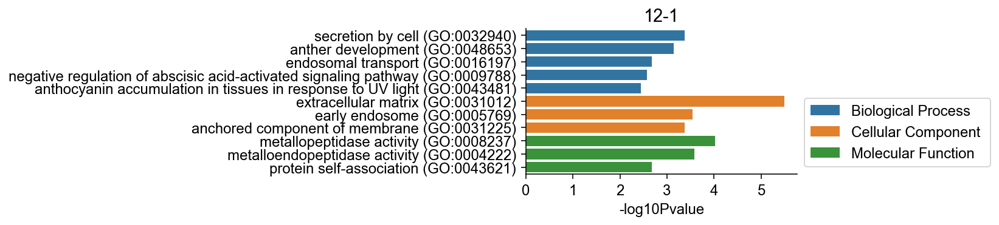

In [1253]:

df_go = enrichmentAnalysisGO(ls_c12_1ClusterGenes, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
if df_go.empty:
    print("Empty")
df_go.insert(0, 'Cluster', '12-1')

fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
plt.legend(loc='lower left', bbox_to_anchor=[1,0])
plt.ylabel('')
sns.despine(top=True, right=True)
plt.title('12-1')
plt.show()

In [1238]:
df_go

,Cluster,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count,-log10Pvalue,Category
GO:0032940,12-1,GO:0032940,secretion by cell (GO:0032940),2/9,24/35944,0.000015,0.000222,0.000057,GLYMA_05G088400/GLYMA_19G114600,2,4.814240,Biological Process
GO:0016197,12-1,GO:0016197,endosomal transport (GO:0016197),2/9,54/35944,0.000079,0.000574,0.000146,GLYMA_05G088400/GLYMA_19G114600,2,4.101201,Biological Process
GO:0009788,12-1,GO:0009788,negative regulation of abscisic acid-activated...,2/9,61/35944,0.000101,0.000587,0.000149,GLYMA_05G088400/GLYMA_19G114600,2,3.994785,Biological Process
GO:0048589,12-1,GO:0048589,developmental growth (GO:0048589),2/9,89/35944,0.000216,0.001043,0.000265,GLYMA_05G088400/GLYMA_19G114600,2,3.665973,Biological Process
GO:0000956,12-1,GO:0000956,nuclear-transcribed mRNA catabolic process (GO...,2/9,273/35944,0.001998,0.008276,0.002103,GLYMA_05G088400/GLYMA_19G114600,2,2.699498,Biological Process
GO:0010075,12-1,GO:0010075,regulation of meristem growth (GO:0010075),2/9,366/35944,0.003551,0.012871,0.003270,GLYMA_06G184400/GLYMA_10G198700,2,2.449708,Biological Process
GO:0009738,12-1,GO:0009738,abscisic acid-activated signaling pathway (GO:...,2/9,492/35944,0.006316,0.015687,0.003986,GLYMA_05G088400/GLYMA_19G114600,2,2.199554,Biological Process
GO:0016567,12-1,GO:0016567,protein ubiquitination (GO:0016567),2/9,494/35944,0.006366,0.015687,0.003986,GLYMA_05G088400/GLYMA_19G114600,2,2.196139,Biological Process
GO:0000272,12-1,GO:0000272,polysaccharide catabolic process (GO:0000272),1/9,86/35944,0.021331,0.047548,0.012081,GLYMA_06G184400,1,1.670991,Biological Process
GO:0005982,12-1,GO:0005982,starch metabolic process (GO:0005982),1/9,105/35944,0.025989,0.047548,0.012081,GLYMA_06G184400,1,1.585217,Biological Process


In [423]:
356 / 39337

0.009050003813203854

In [467]:
from matplotlib import ticker

In [845]:
len([x for x in ad.var.index if x in df_nodulationRelatedGene['Soybean Gene Parsed ID'].to_list()]), len(ad.var.index)

(251, 39337)

In [846]:
[x for x in ls_c12SpercificGenes if x in df_nodulationRelatedGene['Soybean Gene Parsed ID'].to_list()], len(ls_c12SpercificGenes)

(['GLYMA_07G025800'], 33)

In [847]:
[x for x in ls_c12_1ClusterGenes if x in df_nodulationRelatedGene['Soybean Gene Parsed ID'].to_list()], len(ls_c12_1ClusterGenes)

(['GLYMA_13G093600',
  'GLYMA_11G244800',
  'GLYMA_06G184400',
  'GLYMA_10G198700',
  'GLYMA_16G177500',
  'GLYMA_19G114600'],
 50)

In [848]:
[x for x in ls_c12_0ClusterGenes if x in df_nodulationRelatedGene['Soybean Gene Parsed ID'].to_list()], len(ls_c12_0ClusterGenes)

([], 38)

In [ ]:
df_nodulationRelatedGene

(array([0, 1, 2, 3]),
 [Text(0, 0, '12-1 specific genes'),
  Text(1, 0, '12-0 specific genes'),
  Text(2, 0, '12 specific genes'),
  Text(3, 0, 'All detected genes')])

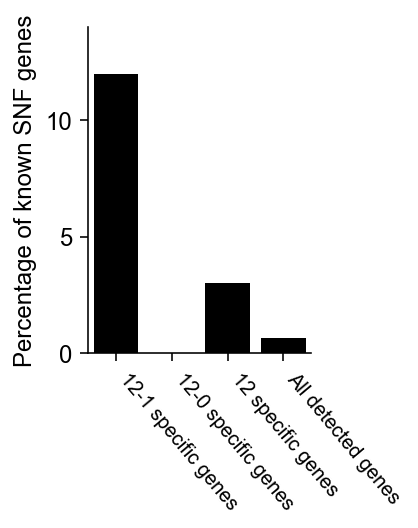

In [988]:
fig, ax = plt.subplots(figsize=(2, 3))

# sns.barplot(y=["1", "2", "3"], x=[100, 100, 100], palette=["#D3D3D3"])
sns.barplot(
    x=["1", "2", "3", "4"],
    y=[6 / 50 * 100, 0 / 38 * 100, 1/33 * 100,  251 / 39337 * 100],
    palette=["black"],
)
plt.ylabel("Percentage of known SNF genes")
plt.ylim(0, 14)
ax.yaxis.set_major_locator(ticker.MultipleLocator(5))

plt.xticks(
    [0, 1, 2, 3], ["12-1 specific genes", "12-0 specific genes", "12 specific genes", "All detected genes"], rotation=-90, ha='center', fontsize=10
)
sns.despine()
plt.xticks(rotation=-50, ha='left')
# ls_legendHandle = []
# ls_legendLabel = ["Others", "Known SNF genes"]
# ls_legendHandle.append(plt.Rectangle((0, 0), 1, 1, fc="#D3D3D3", edgecolor="none"))
# ls_legendHandle.append(plt.Rectangle((0, 0), 1, 1, fc="black", edgecolor="none"))
# plt.legend(
#     ls_legendHandle[::-1],
#     ls_legendLabel[::-1],
#     frameon=False,
#     **dict(loc="upper left", bbox_to_anchor=(-0.5, -0.6), ncol=2)
# )

In [852]:
ad.var["means_ForPickMock"] = ad.to_df('normalize_log').mean()
ad.var["bins_ForPickMock"] = pd.qcut(
    ad.var["means_ForPickMock"], 50, duplicates="drop"
)

In [854]:
import tqdm


def staticTestForModuleGeneCounts(ad, ls_gene, propotion, shuffleCounts=500):
    ls_snfPropotion = []
    for i in tqdm.tqdm(range(shuffleCounts)):
        ls_bgGenes = singleCellTools.geneEnrichInfo.getBgGene(
            ad, ls_gene, usePreBin="bins_ForPickMock", seed=i, replacement=False
        )
        ls_bgSnfGenes = [
            x
            for x in ls_bgGenes
            if x in df_nodulationRelatedGene["Soybean Gene Parsed ID"].to_list()
        ]
        ls_snfPropotion.append(len(ls_bgSnfGenes) / len(ls_bgGenes))
    sns.histplot(ls_snfPropotion, bins=10)
    plt.axvline(propotion)
    ax = plt.gca()

    #     ls_snfPropotion.append(propotion)
    pvalue = len([x for x in ls_snfPropotion if x >= propotion]) / shuffleCounts
    #     df_snfPropotion = pd.concat([pd.Series(ls_snfPropotion), pd.Series(ls_snfPropotion).rank(ascending=False)], axis=1)
    #     pvalue = df_snfPropotion.loc[lambda df:df[0] == propotion].iat[0, -1] / shuffleCounts
    plt.text(
        propotion,
        0.95,
        f"P-value = {pvalue}",
        ha="right",
        transform=ax.get_xaxis_transform(),
    )
    plt.show()
    return ls_snfPropotion

In [112]:
ls_c12_1ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,1' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")["gene"]
    .to_list()
)

100%|██████████| 1000/1000 [01:59<00:00,  8.34it/s]


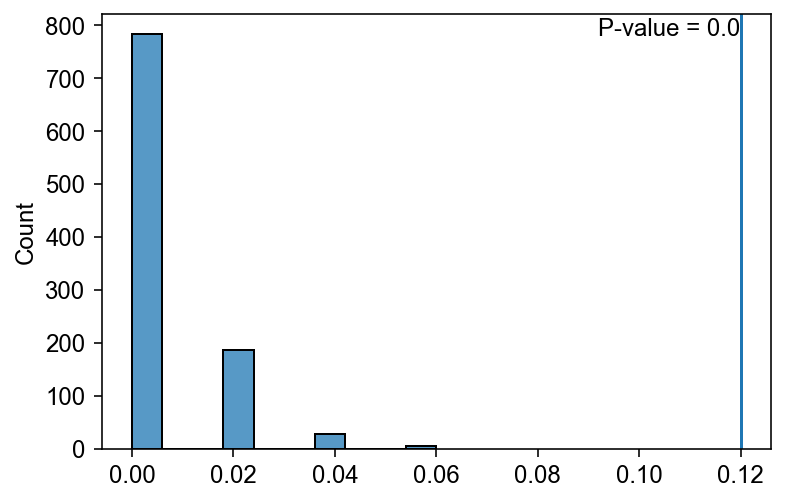

In [855]:
ls_snfPropotion = staticTestForModuleGeneCounts(ad, ls_c12_1ClusterGenes, 0.12, 1000)

In [856]:
from matplotlib import ticker

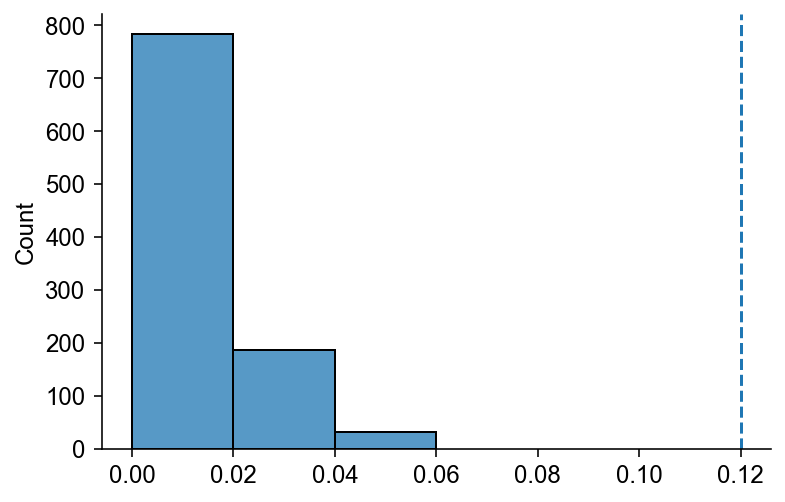

In [857]:
sns.histplot(ls_snfPropotion, bins=[0, 0.02, 0.04, 0.06], stat='count')
plt.axvline(0.12, ls='--')
ax = plt.gca()
ax.xaxis.set_major_locator(ticker.MultipleLocator(0.02))
sns.despine()

In [ ]:
ls_c12_1ClusterGenes = [
    "GLYMA_13G093600", 1 SPK1
    "GLYMA_05G088400", 2 VPY
    "GLYMA_02G076900", 0 NNL1
    "GLYMA_11G244800", 1 NPL
    "GLYMA_06G184400", 1 RINRK1
    "GLYMA_10G198700", 1 RPG
    "GLYMA_19G146000", 0 SPL9d
    "GLYMA_16G177500", 1 CBS1
    "GLYMA_19G114600", 2 VPY
]

In [961]:
ls_c12_1ClusterGenes = [
    "GLYMA_13G093600",
    "GLYMA_05G088400",
    "GLYMA_02G076900",
    "GLYMA_11G244800",
    "GLYMA_06G184400",
    "GLYMA_10G198700",
    "GLYMA_19G146000",
    "GLYMA_16G177500",
    "GLYMA_19G114600",
]

In [962]:
ls_c12_1ClusterNames = [
    "SPK1",
    "VPY",
    "NNL1",
    "NPL",
    "RINRK1",
    "RPG",
    "SPL9d",
    "CBS1",
    "VPY",
]
ls_c12_1ClusterNames = [f"{x}\n({y})" for x,y in zip(ls_c12_1ClusterGenes, ls_c12_1ClusterNames)]

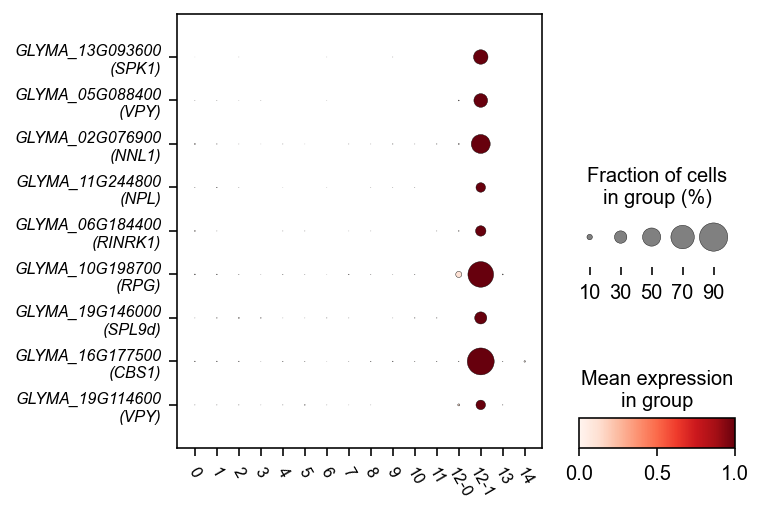

In [967]:
axs = sc.pl.dotplot(
    ad,
    ls_c12_1ClusterGenes,
    groupby="leiden_R",
    cmap="Reds",
    layer="normalize_log",
    swap_axes=True,
    show=False,
    figsize=(5, 4),
    standard_scale="var",
)
plt.sca(axs["mainplot_ax"])
plt.yticks(
    range(len(ls_c12_1ClusterNames)) | F(map, lambda x: x + 0.5) | F(list),
    ls_c12_1ClusterNames,
    style="italic",
    size=8,
)
plt.xticks(rotation=-60, ha="center", size=8)
plt.show()

In [738]:
from matplotlib import ticker

In [740]:
axs

[<AxesSubplot:title={'center':'GLYMA_13G093600\n(SPK1)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_05G088400\n(VPY)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_02G076900\n(NNL1)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_11G244800\n(NPL)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_06G184400\n(RINRK1)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_10G198700\n(RPG)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_19G146000\n(SPL9d)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_16G177500\n(CBS1)'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_19G114600\n(VPY)'}, xlabel='UMAP1', ylabel='UMAP2'>]

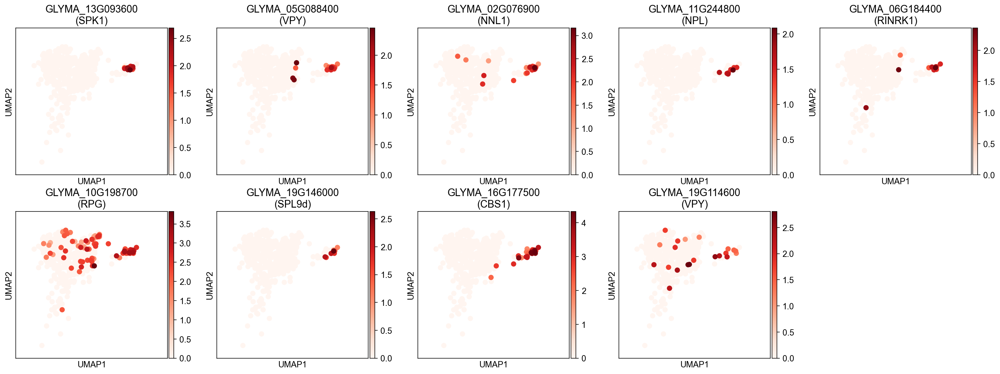

In [489]:
with plt.rc_context({"figure.figsize": (4, 4)}):
    axs = sc.pl.umap(
        ad[ad.obs.eval("Cluster == '12'")],
        color=ls_c12_1ClusterGenes,
        title=ls_c12_1ClusterNames,
        cmap="Reds",
        layer="normalize_log",
        ncols=5,
    #     size=15,
        show=False
    )
    for ax in axs:
        plt.sca(ax)
    #     ax.xaxis.set_major_locator(ticker.MultipleLocator(2))
    #     ax.yaxis.set_major_locator(ticker.MultipleLocator(2))
        plt.xlim(8,13)
        plt.ylim(8,15)

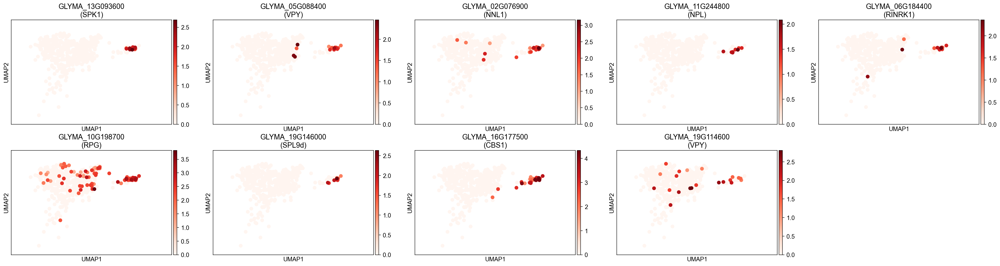

In [750]:
axs = sc.pl.umap(
    ad[ad.obs.eval("Cluster == '12'")],
    color=ls_c12_1ClusterGenes,
    title=ls_c12_1ClusterNames,
    cmap="Reds",
    layer="normalize_log",
    ncols=5,
#     size=15,
    show=False
)
for ax in axs:
    plt.sca(ax)
#     ax.xaxis.set_major_locator(ticker.MultipleLocator(2))
#     ax.yaxis.set_major_locator(ticker.MultipleLocator(2))
    plt.xlim(8,13)
    plt.ylim(8,15)

In [169]:
df_cellexEs = ad.uns["leiden_R_cellexES"].query("leiden_R == '12,1'")

## expression in bulk rh data

In [588]:
ls_c12_1ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,1' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")["gene"]
    .to_list()
)

ls_c12_0ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '12,0' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")["gene"]
    .to_list()
)

In [739]:
df_rhRpkm = pd.read_excel("/data/Zhaijx/liuzj/projects/singleCell/soybean/01_data/bulkRHData/Soybean RH _FPKM.xls")

In [876]:
ad_rh =sc.AnnData(df_rhRpkm.iloc[:, :7].set_index('gene')).T

In [877]:
ad_rh.var = ad_rh.var.rename(index = lambda sr:sr.replace('Glyma.', 'GLYMA_'))

In [878]:
ad_rh.X = np.log1p(ad_rh.X)

In [879]:
ad_rh.obs = ad_rh.obs.assign(id = lambda x:x.index, time = lambda x:x.index.str[:2], treat = lambda x:x.index.str[2:4])

In [753]:
ad_rh = ad_rh[:, ad_rh.X.sum(0) > 0]

In [880]:
_ls = ['12IN_RH', '12UN_RH', '24IN_RH', '24UN_RH', '48IN_RH', '48UN_RH']
_ls = [_ls[x] for x in [0,2,4,1,3,5]]
ad_rh = ad_rh[_ls]
ad_rh.obs['id'] = ad_rh.obs['id'].astype('category').cat.set_categories(_ls)

Trying to set attribute `.obs` of view, copying.


In [755]:
# ad_rh = ad_rh[[0,1,3,4]]

Trying to set attribute `.obs` of view, copying.
... storing 'time' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'treat' as categorical


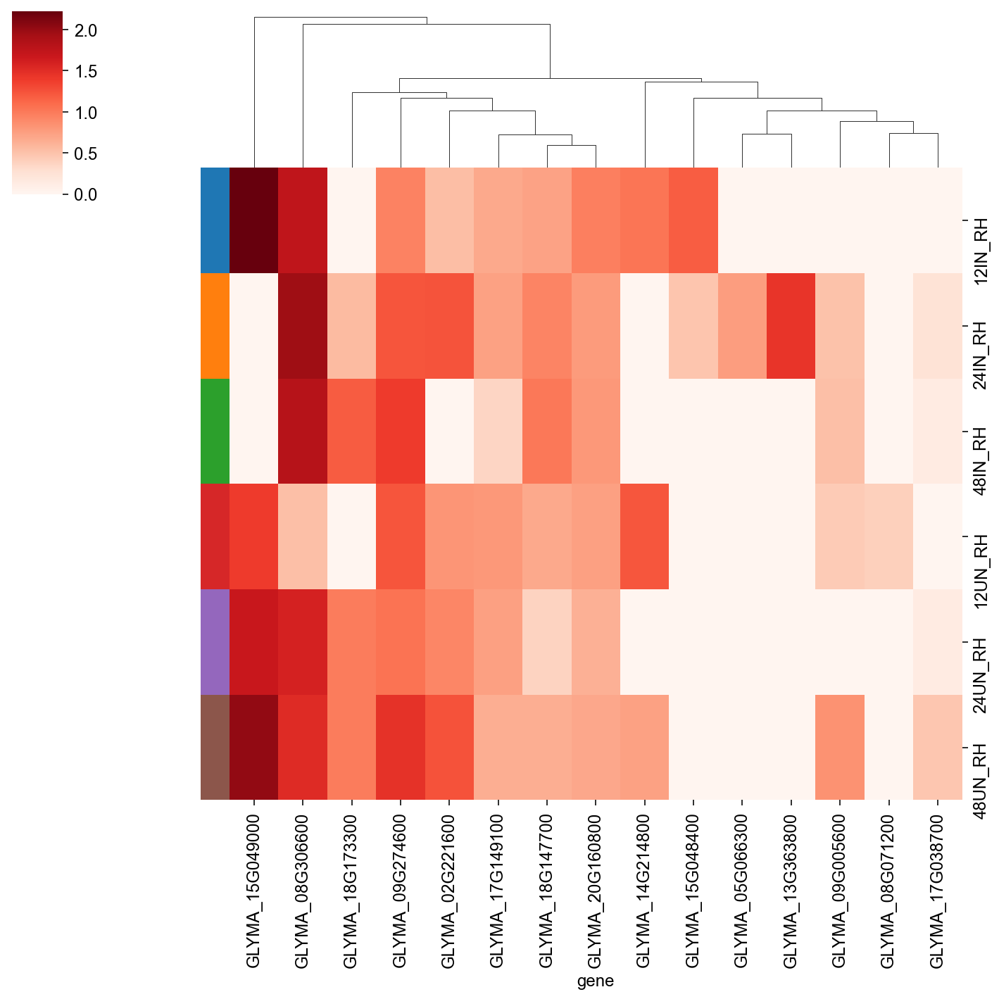

In [756]:
sc.pl.clustermap(ad_rh[:, [x for x in ls_c12_0ClusterGenes if x in ad_rh.var.index]], 'id', cmap='Reds', row_cluster=False)

In [881]:
ad_rh.layers['X'] = ad_rh.X

In [882]:
len(ls_c12_1ClusterGenes), len([x for x in ls_c12_1ClusterGenes if x in ad_rh.var.index]), 21

(50, 50, 21)

Trying to set attribute `.obs` of view, copying.


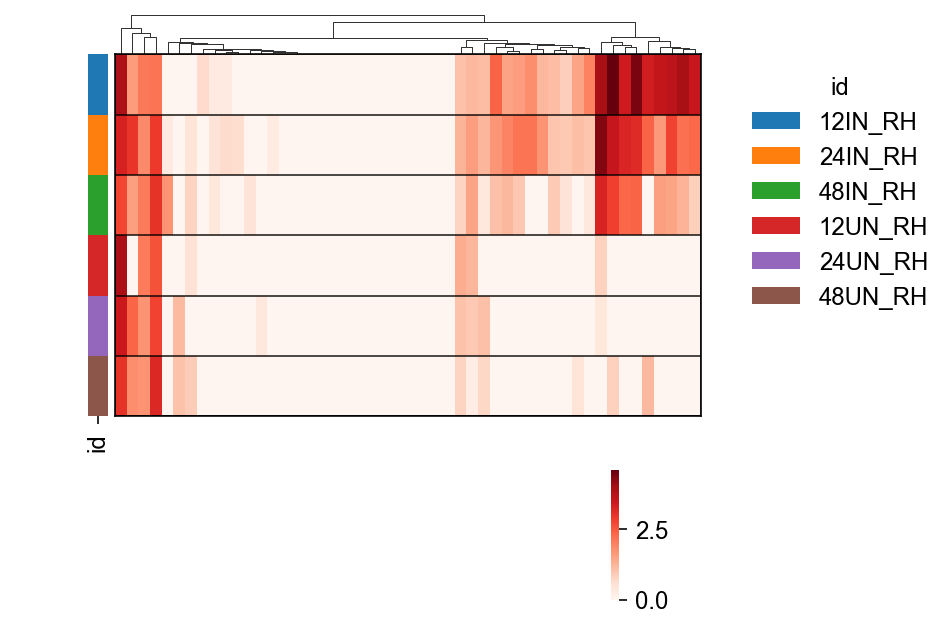

In [884]:
singleCellTools.plotting.clustermap(
    ad_rh,
    {"a": [x for x in ls_c12_1ClusterGenes if x in ad_rh.var.index]},
    obsAnno="id",
    layer="X",
    add_gene_name=False,
    col_cluster=True,
    dendrogram_ratio=0.1,
    figsize=(6, 5)
)

Trying to set attribute `.obs` of view, copying.


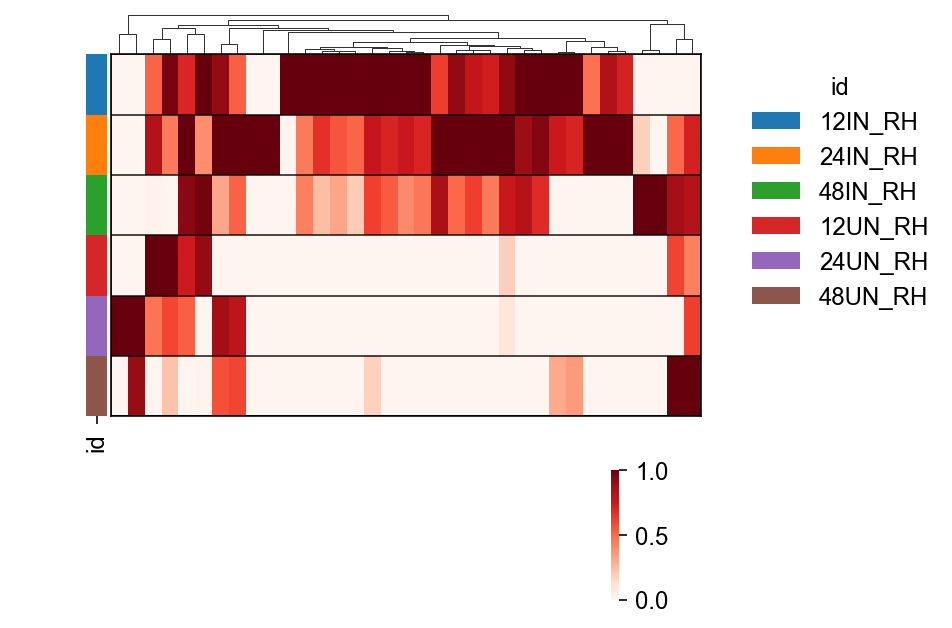

In [778]:
singleCellTools.plotting.clustermap(
    ad_rh,
    {"a": [x for x in ls_c12_1ClusterGenes if x in ad_rh.var.index]},
    obsAnno="id",
    layer="X",
    add_gene_name=False,
    col_cluster=True,
    dendrogram_ratio=0.1,
    figsize=(6, 5), standard_scale =1
)

In [871]:
ls_c12_0ClusterGenes = (
    ad.uns["leiden_R_cellexES"]
    .query("leiden_R == '11' & expressed_ratio > 0.2 & expressed_ratio_others < 0.01")
    .sort_values("enrichScore")
    .nlargest(50, "enrichScore")["gene"]
    .to_list()
)

In [875]:
' '.join(ls_c12_0ClusterGenes)

'GLYMA_17G128000 GLYMA_13G179200 GLYMA_09G134800 GLYMA_13G361200 GLYMA_07G195300 GLYMA_03G113200'

Trying to set attribute `.obs` of view, copying.


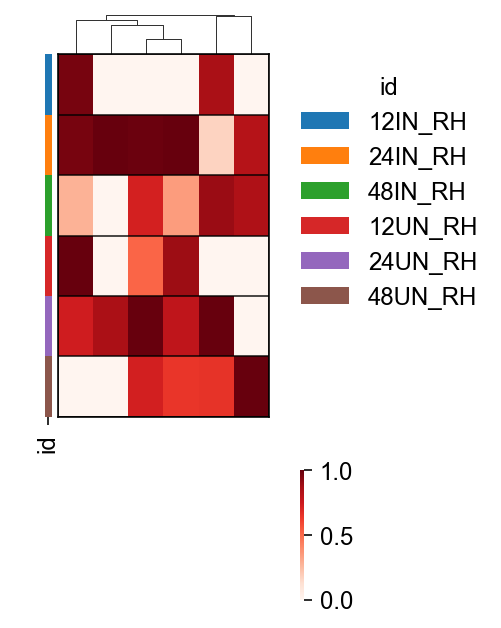

In [873]:
singleCellTools.plotting.clustermap(
    ad_rh,
    {"a": [x for x in ls_c12_0ClusterGenes if x in ad_rh.var.index]},
    obsAnno="id",
    layer="X",
    add_gene_name=False,
    col_cluster=True,
    dendrogram_ratio=0.1, standard_scale =1,
    figsize=(3, 5),
)

Trying to set attribute `.obs` of view, copying.


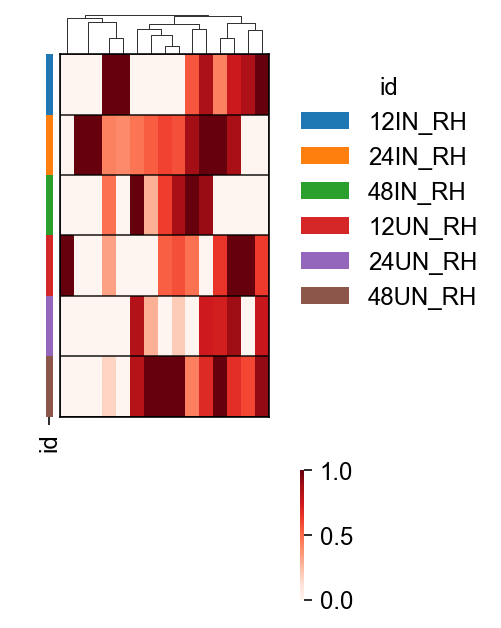

In [780]:
singleCellTools.plotting.clustermap(
    ad_rh,
    {"a": [x for x in ls_c12_0ClusterGenes if x in ad_rh.var.index]},
    obsAnno="id",
    layer="X",
    add_gene_name=False,
    col_cluster=True,
    dendrogram_ratio=0.1, standard_scale =1,
    figsize=(3, 5),
)